# Afriat

In [1]:
scan=0.135

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

False

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{scan}"
)

vae.save(
    dir_path,
    overwrite=True,
)

/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_figures
ID: mcnfvsu3
Name: comfy-snow-134
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_figures/runs/mcnfvsu3
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240503_121714-mcnfvsu3/files



GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "
SLURM auto-requeueing enabled. Setting signal handlers.


Training:   0%|                                                                                                                                                                                                                                 | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|                                                                                                                                                                                                                              | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2541,3311,9391
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2541,2543,1675,3452,1666,3366
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4447,10796
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 664,798,2348
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 664,659,433,838,383,833
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1137,2673
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|▎                                                                                                                                                                                                                   | 1/600 [00:13<2:11:33, 13.18s/it]

Epoch 1/600:   0%|▎                                                                                                                                                        | 1/600 [00:13<2:11:33, 13.18s/it, v_num=u3_1, total_loss_train=3.69e+3, kl_local_train=40.9]

Epoch 2/600:   0%|▎                                                                                                                                                        | 1/600 [00:13<2:11:33, 13.18s/it, v_num=u3_1, total_loss_train=3.69e+3, kl_local_train=40.9]

Epoch 2/600:   0%|▌                                                                                                                                                        | 2/600 [00:24<2:03:17, 12.37s/it, v_num=u3_1, total_loss_train=3.69e+3, kl_local_train=40.9]

Epoch 2/600:   0%|▌                                                                                                                                                        | 2/600 [00:24<2:03:17, 12.37s/it, v_num=u3_1, total_loss_train=3.22e+3, kl_local_train=54.1]

Epoch 3/600:   0%|▌                                                                                                                                                        | 2/600 [00:24<2:03:17, 12.37s/it, v_num=u3_1, total_loss_train=3.22e+3, kl_local_train=54.1]

Epoch 3/600:   0%|▊                                                                                                                                                        | 3/600 [00:36<2:00:35, 12.12s/it, v_num=u3_1, total_loss_train=3.22e+3, kl_local_train=54.1]

Epoch 3/600:   0%|▊                                                                                                                                                        | 3/600 [00:36<2:00:35, 12.12s/it, v_num=u3_1, total_loss_train=3.21e+3, kl_local_train=52.7]

Epoch 4/600:   0%|▊                                                                                                                                                        | 3/600 [00:36<2:00:35, 12.12s/it, v_num=u3_1, total_loss_train=3.21e+3, kl_local_train=52.7]

Epoch 4/600:   1%|█                                                                                                                                                        | 4/600 [00:48<1:59:00, 11.98s/it, v_num=u3_1, total_loss_train=3.21e+3, kl_local_train=52.7]

Epoch 4/600:   1%|█                                                                                                                                                        | 4/600 [00:48<1:59:00, 11.98s/it, v_num=u3_1, total_loss_train=3.21e+3, kl_local_train=48.5]

Epoch 5/600:   1%|█                                                                                                                                                        | 4/600 [00:48<1:59:00, 11.98s/it, v_num=u3_1, total_loss_train=3.21e+3, kl_local_train=48.5]

Epoch 5/600:   1%|█▎                                                                                                                                                       | 5/600 [01:00<1:58:22, 11.94s/it, v_num=u3_1, total_loss_train=3.21e+3, kl_local_train=48.5]

Epoch 5/600:   1%|█▎                                                                                                                                                       | 5/600 [01:00<1:58:22, 11.94s/it, v_num=u3_1, total_loss_train=3.21e+3, kl_local_train=41.7]

Epoch 6/600:   1%|█▎                                                                                                                                                       | 5/600 [01:01<1:58:22, 11.94s/it, v_num=u3_1, total_loss_train=3.21e+3, kl_local_train=41.7]

Epoch 6/600:   1%|█▌                                                                                                                                                       | 6/600 [01:12<1:59:50, 12.11s/it, v_num=u3_1, total_loss_train=3.21e+3, kl_local_train=41.7]

Epoch 6/600:   1%|▎                         | 6/600 [01:12<1:59:50, 12.11s/it, v_num=u3_1, total_loss_train=3.2e+3, kl_local_train=31.1, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.011, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.035]

Epoch 7/600:   1%|▎                         | 6/600 [01:12<1:59:50, 12.11s/it, v_num=u3_1, total_loss_train=3.2e+3, kl_local_train=31.1, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.011, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.035]

Epoch 7/600:   1%|▎                         | 7/600 [01:24<1:57:00, 11.84s/it, v_num=u3_1, total_loss_train=3.2e+3, kl_local_train=31.1, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.011, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.035]

Epoch 7/600:   1%|▎                        | 7/600 [01:24<1:57:00, 11.84s/it, v_num=u3_1, total_loss_train=3.19e+3, kl_local_train=31.7, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.011, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.035]

Epoch 8/600:   1%|▎                        | 7/600 [01:24<1:57:00, 11.84s/it, v_num=u3_1, total_loss_train=3.19e+3, kl_local_train=31.7, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.011, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.035]

Epoch 8/600:   1%|▎                        | 8/600 [01:35<1:54:55, 11.65s/it, v_num=u3_1, total_loss_train=3.19e+3, kl_local_train=31.7, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.011, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.035]

Epoch 8/600:   1%|▎                        | 8/600 [01:35<1:54:55, 11.65s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=28.3, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.011, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.035]

Epoch 9/600:   1%|▎                        | 8/600 [01:35<1:54:55, 11.65s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=28.3, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.011, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.035]

Epoch 9/600:   2%|▍                        | 9/600 [01:46<1:53:19, 11.51s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=28.3, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.011, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.035]

Epoch 9/600:   2%|▍                        | 9/600 [01:46<1:53:19, 11.51s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=31.1, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.011, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.035]

Epoch 10/600:   2%|▎                       | 9/600 [01:46<1:53:19, 11.51s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=31.1, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.011, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.035]

Epoch 10/600:   2%|▍                      | 10/600 [01:57<1:52:36, 11.45s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=31.1, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.011, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.035]

Epoch 10/600:   2%|▍                        | 10/600 [01:57<1:52:36, 11.45s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=35, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.011, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.035]

Epoch 11/600:   2%|▍                        | 10/600 [01:59<1:52:36, 11.45s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=35, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.011, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.035]

Epoch 11/600:   2%|▍                        | 11/600 [02:10<1:55:18, 11.75s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=35, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.011, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.035]

Epoch 11/600:   2%|▍                      | 11/600 [02:10<1:55:18, 11.75s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=41, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.066]

Epoch 12/600:   2%|▍                      | 11/600 [02:10<1:55:18, 11.75s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=41, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.066]

Epoch 12/600:   2%|▍                      | 12/600 [02:21<1:53:20, 11.57s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=41, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.066]

Epoch 12/600:   2%|▍                      | 12/600 [02:21<1:53:20, 11.57s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=47, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.066]

Epoch 13/600:   2%|▍                      | 12/600 [02:21<1:53:20, 11.57s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=47, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.066]

Epoch 13/600:   2%|▍                      | 13/600 [02:32<1:51:51, 11.43s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=47, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.066]

Epoch 13/600:   2%|▍                    | 13/600 [02:32<1:51:51, 11.43s/it, v_num=u3_1, total_loss_train=3155.75, kl_local_train=52.9, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.066]

Epoch 14/600:   2%|▍                    | 13/600 [02:32<1:51:51, 11.43s/it, v_num=u3_1, total_loss_train=3155.75, kl_local_train=52.9, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.066]

Epoch 14/600:   2%|▍                    | 14/600 [02:43<1:50:42, 11.34s/it, v_num=u3_1, total_loss_train=3155.75, kl_local_train=52.9, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.066]

Epoch 14/600:   2%|▍                    | 14/600 [02:43<1:50:42, 11.34s/it, v_num=u3_1, total_loss_train=3.15e+3, kl_local_train=58.7, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.066]

Epoch 15/600:   2%|▍                    | 14/600 [02:43<1:50:42, 11.34s/it, v_num=u3_1, total_loss_train=3.15e+3, kl_local_train=58.7, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.066]

Epoch 15/600:   2%|▌                    | 15/600 [02:55<1:50:23, 11.32s/it, v_num=u3_1, total_loss_train=3.15e+3, kl_local_train=58.7, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.066]

Epoch 15/600:   2%|▌                    | 15/600 [02:55<1:50:23, 11.32s/it, v_num=u3_1, total_loss_train=3.15e+3, kl_local_train=63.9, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.066]

Epoch 16/600:   2%|▌                    | 15/600 [02:56<1:50:23, 11.32s/it, v_num=u3_1, total_loss_train=3.15e+3, kl_local_train=63.9, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.066]

Epoch 16/600:   3%|▌                    | 16/600 [03:07<1:53:26, 11.66s/it, v_num=u3_1, total_loss_train=3.15e+3, kl_local_train=63.9, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.066]

Epoch 16/600:   3%|▌                   | 16/600 [03:07<1:53:26, 11.66s/it, v_num=u3_1, total_loss_train=3.15e+3, kl_local_train=71.2, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0846]

Epoch 17/600:   3%|▌                   | 16/600 [03:07<1:53:26, 11.66s/it, v_num=u3_1, total_loss_train=3.15e+3, kl_local_train=71.2, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0846]

Epoch 17/600:   3%|▌                   | 17/600 [03:18<1:51:43, 11.50s/it, v_num=u3_1, total_loss_train=3.15e+3, kl_local_train=71.2, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0846]

Epoch 17/600:   3%|▌                   | 17/600 [03:18<1:51:43, 11.50s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=78.2, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0846]

Epoch 18/600:   3%|▌                   | 17/600 [03:18<1:51:43, 11.50s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=78.2, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0846]

Epoch 18/600:   3%|▌                   | 18/600 [03:29<1:50:26, 11.39s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=78.2, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0846]

Epoch 18/600:   3%|▌                   | 18/600 [03:29<1:50:26, 11.39s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=85.6, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0846]

Epoch 19/600:   3%|▌                   | 18/600 [03:29<1:50:26, 11.39s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=85.6, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0846]

Epoch 19/600:   3%|▋                   | 19/600 [03:40<1:49:31, 11.31s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=85.6, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0846]

Epoch 19/600:   3%|▋                   | 19/600 [03:40<1:49:31, 11.31s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=90.6, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0846]

Epoch 20/600:   3%|▋                   | 19/600 [03:40<1:49:31, 11.31s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=90.6, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0846]

Epoch 20/600:   3%|▋                   | 20/600 [03:52<1:49:34, 11.34s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=90.6, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0846]

Epoch 20/600:   3%|▋                   | 20/600 [03:52<1:49:34, 11.34s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=94.8, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0846]

Epoch 21/600:   3%|▋                   | 20/600 [03:53<1:49:34, 11.34s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=94.8, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0846]

Epoch 21/600:   4%|▋                   | 21/600 [04:04<1:52:41, 11.68s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=94.8, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0846]

Epoch 21/600:   4%|▊                     | 21/600 [04:04<1:52:41, 11.68s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=97.8, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.107]

Epoch 22/600:   4%|▊                     | 21/600 [04:04<1:52:41, 11.68s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=97.8, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.107]

Epoch 22/600:   4%|▊                     | 22/600 [04:15<1:51:14, 11.55s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=97.8, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.107]

Epoch 22/600:   4%|▊                      | 22/600 [04:15<1:51:14, 11.55s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=102, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.107]

Epoch 23/600:   4%|▊                      | 22/600 [04:15<1:51:14, 11.55s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=102, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.107]

Epoch 23/600:   4%|▉                      | 23/600 [04:27<1:50:11, 11.46s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=102, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.107]

Epoch 23/600:   4%|▉                      | 23/600 [04:27<1:50:11, 11.46s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=105, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.107]

Epoch 24/600:   4%|▉                      | 23/600 [04:27<1:50:11, 11.46s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=105, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.107]

Epoch 24/600:   4%|▉                      | 24/600 [04:38<1:49:26, 11.40s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=105, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.107]

Epoch 24/600:   4%|▉                      | 24/600 [04:38<1:49:26, 11.40s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=108, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.107]

Epoch 25/600:   4%|▉                      | 24/600 [04:38<1:49:26, 11.40s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=108, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.107]

Epoch 25/600:   4%|▉                      | 25/600 [04:50<1:50:17, 11.51s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=108, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.107]

Epoch 25/600:   4%|▉                      | 25/600 [04:50<1:50:17, 11.51s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=111, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.107]

Epoch 26/600:   4%|▉                      | 25/600 [04:51<1:50:17, 11.51s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=111, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.107]

Epoch 26/600:   4%|▉                      | 26/600 [05:02<1:53:10, 11.83s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=111, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.107]

Epoch 26/600:   4%|█                       | 26/600 [05:02<1:53:10, 11.83s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=113, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.113]

Epoch 27/600:   4%|█                       | 26/600 [05:02<1:53:10, 11.83s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=113, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.113]

Epoch 27/600:   4%|█                       | 27/600 [05:14<1:52:01, 11.73s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=113, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.113]

Epoch 27/600:   4%|█                       | 27/600 [05:14<1:52:01, 11.73s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=113, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.113]

Epoch 28/600:   4%|█                       | 27/600 [05:14<1:52:01, 11.73s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=113, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.113]

Epoch 28/600:   5%|█                       | 28/600 [05:25<1:50:30, 11.59s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=113, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.113]

Epoch 28/600:   5%|█                       | 28/600 [05:25<1:50:30, 11.59s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.113]

Epoch 29/600:   5%|█                       | 28/600 [05:25<1:50:30, 11.59s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.113]

Epoch 29/600:   5%|█▏                      | 29/600 [05:36<1:49:19, 11.49s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.113]

Epoch 29/600:   5%|█▏                      | 29/600 [05:36<1:49:19, 11.49s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.113]

Epoch 30/600:   5%|█▏                      | 29/600 [05:36<1:49:19, 11.49s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.113]

Epoch 30/600:   5%|█▏                      | 30/600 [05:48<1:48:28, 11.42s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.113]

Epoch 30/600:   5%|█▏                      | 30/600 [05:48<1:48:28, 11.42s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=117, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.113]

Epoch 31/600:   5%|█▏                      | 30/600 [05:49<1:48:28, 11.42s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=117, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.113]

Epoch 31/600:   5%|█▏                      | 31/600 [06:00<1:51:25, 11.75s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=117, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.113]

Epoch 31/600:   5%|█▎                       | 31/600 [06:00<1:51:25, 11.75s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.117]

Epoch 32/600:   5%|█▎                       | 31/600 [06:00<1:51:25, 11.75s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.117]

Epoch 32/600:   5%|█▎                       | 32/600 [06:11<1:49:53, 11.61s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.117]

Epoch 32/600:   5%|█▎                       | 32/600 [06:11<1:49:53, 11.61s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=117, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.117]

Epoch 33/600:   5%|█▎                       | 32/600 [06:11<1:49:53, 11.61s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=117, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.117]

Epoch 33/600:   6%|█▍                       | 33/600 [06:23<1:48:41, 11.50s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=117, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.117]

Epoch 33/600:   6%|█▍                       | 33/600 [06:23<1:48:41, 11.50s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=117, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.117]

Epoch 34/600:   6%|█▍                       | 33/600 [06:23<1:48:41, 11.50s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=117, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.117]

Epoch 34/600:   6%|█▍                       | 34/600 [06:34<1:47:47, 11.43s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=117, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.117]

Epoch 34/600:   6%|█▍                       | 34/600 [06:34<1:47:47, 11.43s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.117]

Epoch 35/600:   6%|█▍                       | 34/600 [06:34<1:47:47, 11.43s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.117]

Epoch 35/600:   6%|█▍                       | 35/600 [06:45<1:47:01, 11.37s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.117]

Epoch 35/600:   6%|█▍                       | 35/600 [06:45<1:47:01, 11.37s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=115, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.117]

Epoch 36/600:   6%|█▍                       | 35/600 [06:46<1:47:01, 11.37s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=115, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.117]

Epoch 36/600:   6%|█▌                       | 36/600 [06:58<1:50:07, 11.72s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=115, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.117]

Epoch 36/600:   6%|█▌                        | 36/600 [06:58<1:50:07, 11.72s/it, v_num=u3_1, total_loss_train=3.19e+3, kl_local_train=116, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.12]

Epoch 37/600:   6%|█▌                        | 36/600 [06:58<1:50:07, 11.72s/it, v_num=u3_1, total_loss_train=3.19e+3, kl_local_train=116, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.12]

Epoch 37/600:   6%|█▌                        | 37/600 [07:09<1:48:38, 11.58s/it, v_num=u3_1, total_loss_train=3.19e+3, kl_local_train=116, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.12]

Epoch 37/600:   6%|█▌                        | 37/600 [07:09<1:48:38, 11.58s/it, v_num=u3_1, total_loss_train=3.19e+3, kl_local_train=115, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.12]

Epoch 38/600:   6%|█▌                        | 37/600 [07:09<1:48:38, 11.58s/it, v_num=u3_1, total_loss_train=3.19e+3, kl_local_train=115, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.12]

Epoch 38/600:   6%|█▋                        | 38/600 [07:20<1:47:32, 11.48s/it, v_num=u3_1, total_loss_train=3.19e+3, kl_local_train=115, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.12]

Epoch 38/600:   6%|█▋                        | 38/600 [07:20<1:47:32, 11.48s/it, v_num=u3_1, total_loss_train=3.19e+3, kl_local_train=115, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.12]

Epoch 39/600:   6%|█▋                        | 38/600 [07:20<1:47:32, 11.48s/it, v_num=u3_1, total_loss_train=3.19e+3, kl_local_train=115, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.12]

Epoch 39/600:   6%|█▋                        | 39/600 [07:31<1:46:43, 11.42s/it, v_num=u3_1, total_loss_train=3.19e+3, kl_local_train=115, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.12]

Epoch 39/600:   6%|█▋                        | 39/600 [07:31<1:46:43, 11.42s/it, v_num=u3_1, total_loss_train=3.19e+3, kl_local_train=114, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.12]

Epoch 40/600:   6%|█▋                        | 39/600 [07:31<1:46:43, 11.42s/it, v_num=u3_1, total_loss_train=3.19e+3, kl_local_train=114, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.12]

Epoch 40/600:   7%|█▋                        | 40/600 [07:43<1:46:00, 11.36s/it, v_num=u3_1, total_loss_train=3.19e+3, kl_local_train=114, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.12]

Epoch 40/600:   7%|█▋                        | 40/600 [07:43<1:46:00, 11.36s/it, v_num=u3_1, total_loss_train=3.19e+3, kl_local_train=114, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.12]

Epoch 41/600:   7%|█▋                        | 40/600 [07:44<1:46:00, 11.36s/it, v_num=u3_1, total_loss_train=3.19e+3, kl_local_train=114, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.12]

Epoch 41/600:   7%|█▊                        | 41/600 [07:55<1:49:05, 11.71s/it, v_num=u3_1, total_loss_train=3.19e+3, kl_local_train=114, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.12]

Epoch 41/600:   7%|█▊                        | 41/600 [07:55<1:49:05, 11.71s/it, v_num=u3_1, total_loss_train=3.2e+3, kl_local_train=115, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 42/600:   7%|█▊                        | 41/600 [07:55<1:49:05, 11.71s/it, v_num=u3_1, total_loss_train=3.2e+3, kl_local_train=115, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 42/600:   7%|█▊                        | 42/600 [08:06<1:47:41, 11.58s/it, v_num=u3_1, total_loss_train=3.2e+3, kl_local_train=115, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 42/600:   7%|█▊                        | 42/600 [08:06<1:47:41, 11.58s/it, v_num=u3_1, total_loss_train=3.2e+3, kl_local_train=115, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 43/600:   7%|█▊                        | 42/600 [08:06<1:47:41, 11.58s/it, v_num=u3_1, total_loss_train=3.2e+3, kl_local_train=115, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 43/600:   7%|█▊                        | 43/600 [08:18<1:46:37, 11.49s/it, v_num=u3_1, total_loss_train=3.2e+3, kl_local_train=115, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 43/600:   7%|█▊                        | 43/600 [08:18<1:46:37, 11.49s/it, v_num=u3_1, total_loss_train=3.2e+3, kl_local_train=115, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 44/600:   7%|█▊                        | 43/600 [08:18<1:46:37, 11.49s/it, v_num=u3_1, total_loss_train=3.2e+3, kl_local_train=115, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 44/600:   7%|█▉                        | 44/600 [08:29<1:45:50, 11.42s/it, v_num=u3_1, total_loss_train=3.2e+3, kl_local_train=115, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 44/600:   7%|█▉                        | 44/600 [08:29<1:45:50, 11.42s/it, v_num=u3_1, total_loss_train=3.2e+3, kl_local_train=114, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 45/600:   7%|█▉                        | 44/600 [08:29<1:45:50, 11.42s/it, v_num=u3_1, total_loss_train=3.2e+3, kl_local_train=114, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 45/600:   8%|█▉                        | 45/600 [08:40<1:45:14, 11.38s/it, v_num=u3_1, total_loss_train=3.2e+3, kl_local_train=114, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 45/600:   8%|█▉                        | 45/600 [08:40<1:45:14, 11.38s/it, v_num=u3_1, total_loss_train=3.2e+3, kl_local_train=114, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 46/600:   8%|█▉                        | 45/600 [08:42<1:45:14, 11.38s/it, v_num=u3_1, total_loss_train=3.2e+3, kl_local_train=114, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 46/600:   8%|█▉                        | 46/600 [08:53<1:48:12, 11.72s/it, v_num=u3_1, total_loss_train=3.2e+3, kl_local_train=114, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 46/600:   8%|█▉                       | 46/600 [08:53<1:48:12, 11.72s/it, v_num=u3_1, total_loss_train=3.21e+3, kl_local_train=113, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 47/600:   8%|█▉                       | 46/600 [08:53<1:48:12, 11.72s/it, v_num=u3_1, total_loss_train=3.21e+3, kl_local_train=113, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 47/600:   8%|█▉                       | 47/600 [09:04<1:46:53, 11.60s/it, v_num=u3_1, total_loss_train=3.21e+3, kl_local_train=113, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 47/600:   8%|█▉                       | 47/600 [09:04<1:46:53, 11.60s/it, v_num=u3_1, total_loss_train=3.21e+3, kl_local_train=112, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 48/600:   8%|█▉                       | 47/600 [09:04<1:46:53, 11.60s/it, v_num=u3_1, total_loss_train=3.21e+3, kl_local_train=112, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 48/600:   8%|██                       | 48/600 [09:15<1:45:53, 11.51s/it, v_num=u3_1, total_loss_train=3.21e+3, kl_local_train=112, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 48/600:   8%|██                       | 48/600 [09:15<1:45:53, 11.51s/it, v_num=u3_1, total_loss_train=3.21e+3, kl_local_train=112, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 49/600:   8%|██                       | 48/600 [09:15<1:45:53, 11.51s/it, v_num=u3_1, total_loss_train=3.21e+3, kl_local_train=112, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 49/600:   8%|██                       | 49/600 [09:27<1:45:04, 11.44s/it, v_num=u3_1, total_loss_train=3.21e+3, kl_local_train=112, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 49/600:   8%|██                       | 49/600 [09:27<1:45:04, 11.44s/it, v_num=u3_1, total_loss_train=3.21e+3, kl_local_train=113, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 50/600:   8%|██                       | 49/600 [09:27<1:45:04, 11.44s/it, v_num=u3_1, total_loss_train=3.21e+3, kl_local_train=113, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 50/600:   8%|██                       | 50/600 [09:38<1:44:36, 11.41s/it, v_num=u3_1, total_loss_train=3.21e+3, kl_local_train=113, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 50/600:   8%|██                       | 50/600 [09:38<1:44:36, 11.41s/it, v_num=u3_1, total_loss_train=3.22e+3, kl_local_train=112, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 51/600:   8%|██                       | 50/600 [09:39<1:44:36, 11.41s/it, v_num=u3_1, total_loss_train=3.22e+3, kl_local_train=112, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 51/600:   8%|██▏                      | 51/600 [09:51<1:47:27, 11.74s/it, v_num=u3_1, total_loss_train=3.22e+3, kl_local_train=112, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 51/600:   8%|██▏                      | 51/600 [09:51<1:47:27, 11.74s/it, v_num=u3_1, total_loss_train=3.21e+3, kl_local_train=110, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 52/600:   8%|██▏                      | 51/600 [09:51<1:47:27, 11.74s/it, v_num=u3_1, total_loss_train=3.21e+3, kl_local_train=110, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 52/600:   9%|██▏                      | 52/600 [10:02<1:46:02, 11.61s/it, v_num=u3_1, total_loss_train=3.21e+3, kl_local_train=110, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 52/600:   9%|██▏                      | 52/600 [10:02<1:46:02, 11.61s/it, v_num=u3_1, total_loss_train=3.21e+3, kl_local_train=111, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 53/600:   9%|██▏                      | 52/600 [10:02<1:46:02, 11.61s/it, v_num=u3_1, total_loss_train=3.21e+3, kl_local_train=111, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 53/600:   9%|██▏                      | 53/600 [10:14<1:47:19, 11.77s/it, v_num=u3_1, total_loss_train=3.21e+3, kl_local_train=111, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 53/600:   9%|██▏                      | 53/600 [10:14<1:47:19, 11.77s/it, v_num=u3_1, total_loss_train=3.21e+3, kl_local_train=110, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 54/600:   9%|██▏                      | 53/600 [10:14<1:47:19, 11.77s/it, v_num=u3_1, total_loss_train=3.21e+3, kl_local_train=110, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 54/600:   9%|██▎                      | 54/600 [10:27<1:51:38, 12.27s/it, v_num=u3_1, total_loss_train=3.21e+3, kl_local_train=110, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 54/600:   9%|██▎                      | 54/600 [10:27<1:51:38, 12.27s/it, v_num=u3_1, total_loss_train=3.21e+3, kl_local_train=108, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 55/600:   9%|██▎                      | 54/600 [10:27<1:51:38, 12.27s/it, v_num=u3_1, total_loss_train=3.21e+3, kl_local_train=108, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 55/600:   9%|██▎                      | 55/600 [10:41<1:54:26, 12.60s/it, v_num=u3_1, total_loss_train=3.21e+3, kl_local_train=108, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 55/600:   9%|██▎                      | 55/600 [10:41<1:54:26, 12.60s/it, v_num=u3_1, total_loss_train=3.21e+3, kl_local_train=107, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 56/600:   9%|██▎                      | 55/600 [10:42<1:54:26, 12.60s/it, v_num=u3_1, total_loss_train=3.21e+3, kl_local_train=107, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 56/600:   9%|██▎                      | 56/600 [10:55<1:59:47, 13.21s/it, v_num=u3_1, total_loss_train=3.21e+3, kl_local_train=107, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 56/600:   9%|██▎                      | 56/600 [10:55<1:59:47, 13.21s/it, v_num=u3_1, total_loss_train=3.21e+3, kl_local_train=104, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 57/600:   9%|██▎                      | 56/600 [10:55<1:59:47, 13.21s/it, v_num=u3_1, total_loss_train=3.21e+3, kl_local_train=104, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 57/600:  10%|██▍                      | 57/600 [11:09<1:59:57, 13.26s/it, v_num=u3_1, total_loss_train=3.21e+3, kl_local_train=104, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 57/600:  10%|██▍                       | 57/600 [11:09<1:59:57, 13.26s/it, v_num=u3_1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 58/600:  10%|██▍                       | 57/600 [11:09<1:59:57, 13.26s/it, v_num=u3_1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 58/600:  10%|██▌                       | 58/600 [11:22<2:00:00, 13.29s/it, v_num=u3_1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 58/600:  10%|██▌                       | 58/600 [11:22<2:00:00, 13.29s/it, v_num=u3_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 59/600:  10%|██▌                       | 58/600 [11:22<2:00:00, 13.29s/it, v_num=u3_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 59/600:  10%|██▌                       | 59/600 [11:35<1:59:54, 13.30s/it, v_num=u3_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 59/600:  10%|██▌                       | 59/600 [11:35<1:59:54, 13.30s/it, v_num=u3_1, total_loss_train=3.2e+3, kl_local_train=102, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 60/600:  10%|██▌                       | 59/600 [11:35<1:59:54, 13.30s/it, v_num=u3_1, total_loss_train=3.2e+3, kl_local_train=102, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 60/600:  10%|██▌                       | 60/600 [11:49<1:59:48, 13.31s/it, v_num=u3_1, total_loss_train=3.2e+3, kl_local_train=102, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 60/600:  10%|██▌                       | 60/600 [11:49<1:59:48, 13.31s/it, v_num=u3_1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 61/600:  10%|██▌                       | 60/600 [11:50<1:59:48, 13.31s/it, v_num=u3_1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 61/600:  10%|██▋                       | 61/600 [12:03<2:03:09, 13.71s/it, v_num=u3_1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 61/600:  10%|██▌                      | 61/600 [12:03<2:03:09, 13.71s/it, v_num=u3_1, total_loss_train=3.2e+3, kl_local_train=99.5, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 62/600:  10%|██▌                      | 61/600 [12:03<2:03:09, 13.71s/it, v_num=u3_1, total_loss_train=3.2e+3, kl_local_train=99.5, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 62/600:  10%|██▌                      | 62/600 [12:17<2:02:01, 13.61s/it, v_num=u3_1, total_loss_train=3.2e+3, kl_local_train=99.5, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 62/600:  10%|██▌                      | 62/600 [12:17<2:02:01, 13.61s/it, v_num=u3_1, total_loss_train=3.2e+3, kl_local_train=98.8, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 63/600:  10%|██▌                      | 62/600 [12:17<2:02:01, 13.61s/it, v_num=u3_1, total_loss_train=3.2e+3, kl_local_train=98.8, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 63/600:  10%|██▋                      | 63/600 [12:30<2:01:02, 13.52s/it, v_num=u3_1, total_loss_train=3.2e+3, kl_local_train=98.8, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 63/600:  10%|██▋                      | 63/600 [12:30<2:01:02, 13.52s/it, v_num=u3_1, total_loss_train=3.2e+3, kl_local_train=97.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 64/600:  10%|██▋                      | 63/600 [12:30<2:01:02, 13.52s/it, v_num=u3_1, total_loss_train=3.2e+3, kl_local_train=97.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 64/600:  11%|██▋                      | 64/600 [12:43<2:00:20, 13.47s/it, v_num=u3_1, total_loss_train=3.2e+3, kl_local_train=97.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 64/600:  11%|██▌                     | 64/600 [12:43<2:00:20, 13.47s/it, v_num=u3_1, total_loss_train=3.19e+3, kl_local_train=96.2, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 65/600:  11%|██▌                     | 64/600 [12:44<2:00:20, 13.47s/it, v_num=u3_1, total_loss_train=3.19e+3, kl_local_train=96.2, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 65/600:  11%|██▌                     | 65/600 [12:57<1:59:40, 13.42s/it, v_num=u3_1, total_loss_train=3.19e+3, kl_local_train=96.2, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 65/600:  11%|██▌                     | 65/600 [12:57<1:59:40, 13.42s/it, v_num=u3_1, total_loss_train=3.19e+3, kl_local_train=95.9, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 66/600:  11%|██▌                     | 65/600 [12:58<1:59:40, 13.42s/it, v_num=u3_1, total_loss_train=3.19e+3, kl_local_train=95.9, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 66/600:  11%|██▋                     | 66/600 [13:09<1:57:14, 13.17s/it, v_num=u3_1, total_loss_train=3.19e+3, kl_local_train=95.9, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 66/600:  11%|██▋                     | 66/600 [13:09<1:57:14, 13.17s/it, v_num=u3_1, total_loss_train=3.19e+3, kl_local_train=95.9, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 67/600:  11%|██▋                     | 66/600 [13:09<1:57:14, 13.17s/it, v_num=u3_1, total_loss_train=3.19e+3, kl_local_train=95.9, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 67/600:  11%|██▋                     | 67/600 [13:21<1:51:59, 12.61s/it, v_num=u3_1, total_loss_train=3.19e+3, kl_local_train=95.9, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 67/600:  11%|██▋                     | 67/600 [13:21<1:51:59, 12.61s/it, v_num=u3_1, total_loss_train=3.19e+3, kl_local_train=94.6, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 68/600:  11%|██▋                     | 67/600 [13:21<1:51:59, 12.61s/it, v_num=u3_1, total_loss_train=3.19e+3, kl_local_train=94.6, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 68/600:  11%|██▋                     | 68/600 [13:32<1:48:14, 12.21s/it, v_num=u3_1, total_loss_train=3.19e+3, kl_local_train=94.6, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 68/600:  11%|██▋                     | 68/600 [13:32<1:48:14, 12.21s/it, v_num=u3_1, total_loss_train=3.19e+3, kl_local_train=93.9, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 69/600:  11%|██▋                     | 68/600 [13:32<1:48:14, 12.21s/it, v_num=u3_1, total_loss_train=3.19e+3, kl_local_train=93.9, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 69/600:  12%|██▊                     | 69/600 [13:43<1:45:36, 11.93s/it, v_num=u3_1, total_loss_train=3.19e+3, kl_local_train=93.9, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 69/600:  12%|██▉                      | 69/600 [13:43<1:45:36, 11.93s/it, v_num=u3_1, total_loss_train=3187.0, kl_local_train=93.5, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 70/600:  12%|██▉                      | 69/600 [13:43<1:45:36, 11.93s/it, v_num=u3_1, total_loss_train=3187.0, kl_local_train=93.5, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 70/600:  12%|██▉                      | 70/600 [13:55<1:43:49, 11.75s/it, v_num=u3_1, total_loss_train=3187.0, kl_local_train=93.5, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 70/600:  12%|██▊                     | 70/600 [13:55<1:43:49, 11.75s/it, v_num=u3_1, total_loss_train=3.19e+3, kl_local_train=91.8, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 71/600:  12%|██▊                     | 70/600 [13:56<1:43:49, 11.75s/it, v_num=u3_1, total_loss_train=3.19e+3, kl_local_train=91.8, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 71/600:  12%|██▊                     | 71/600 [14:07<1:45:41, 11.99s/it, v_num=u3_1, total_loss_train=3.19e+3, kl_local_train=91.8, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 71/600:  12%|██▊                     | 71/600 [14:07<1:45:41, 11.99s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=91.2, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 72/600:  12%|██▊                     | 71/600 [14:07<1:45:41, 11.99s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=91.2, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 72/600:  12%|██▉                     | 72/600 [14:18<1:43:41, 11.78s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=91.2, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 72/600:  12%|██▉                     | 72/600 [14:18<1:43:41, 11.78s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=90.2, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 73/600:  12%|██▉                     | 72/600 [14:18<1:43:41, 11.78s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=90.2, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 73/600:  12%|██▉                     | 73/600 [14:30<1:42:07, 11.63s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=90.2, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 73/600:  12%|██▉                     | 73/600 [14:30<1:42:07, 11.63s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=90.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 74/600:  12%|██▉                     | 73/600 [14:30<1:42:07, 11.63s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=90.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 74/600:  12%|██▉                     | 74/600 [14:41<1:41:03, 11.53s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=90.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 74/600:  12%|██▉                     | 74/600 [14:41<1:41:03, 11.53s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=89.3, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 75/600:  12%|██▉                     | 74/600 [14:41<1:41:03, 11.53s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=89.3, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 75/600:  12%|███                     | 75/600 [14:52<1:40:16, 11.46s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=89.3, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 75/600:  12%|███▎                      | 75/600 [14:52<1:40:16, 11.46s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=89, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 76/600:  12%|███▎                      | 75/600 [14:54<1:40:16, 11.46s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=89, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 76/600:  13%|███▎                      | 76/600 [15:05<1:43:03, 11.80s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=89, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 76/600:  13%|███                     | 76/600 [15:05<1:43:03, 11.80s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=88.7, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 77/600:  13%|███                     | 76/600 [15:05<1:43:03, 11.80s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=88.7, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 77/600:  13%|███                     | 77/600 [15:16<1:41:52, 11.69s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=88.7, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 77/600:  13%|███                     | 77/600 [15:16<1:41:52, 11.69s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=87.9, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 78/600:  13%|███                     | 77/600 [15:16<1:41:52, 11.69s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=87.9, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 78/600:  13%|███                     | 78/600 [15:28<1:40:54, 11.60s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=87.9, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 78/600:  13%|███▍                      | 78/600 [15:28<1:40:54, 11.60s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=87, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 79/600:  13%|███▍                      | 78/600 [15:28<1:40:54, 11.60s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=87, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 79/600:  13%|███▍                      | 79/600 [15:39<1:39:58, 11.51s/it, v_num=u3_1, total_loss_train=3.18e+3, kl_local_train=87, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 79/600:  13%|███▏                    | 79/600 [15:39<1:39:58, 11.51s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=86.7, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 80/600:  13%|███▏                    | 79/600 [15:39<1:39:58, 11.51s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=86.7, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 80/600:  13%|███▏                    | 80/600 [15:50<1:39:09, 11.44s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=86.7, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 80/600:  13%|███▏                    | 80/600 [15:50<1:39:09, 11.44s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=86.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 81/600:  13%|███▏                    | 80/600 [15:52<1:39:09, 11.44s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=86.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 81/600:  14%|███▏                    | 81/600 [16:03<1:41:40, 11.75s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=86.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 81/600:  14%|███▏                    | 81/600 [16:03<1:41:40, 11.75s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=85.5, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 82/600:  14%|███▏                    | 81/600 [16:03<1:41:40, 11.75s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=85.5, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 82/600:  14%|███▎                    | 82/600 [16:14<1:40:10, 11.60s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=85.5, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 82/600:  14%|███▎                    | 82/600 [16:14<1:40:10, 11.60s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=84.5, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 83/600:  14%|███▎                    | 82/600 [16:14<1:40:10, 11.60s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=84.5, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 83/600:  14%|███▎                    | 83/600 [16:25<1:38:59, 11.49s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=84.5, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 83/600:  14%|███▌                      | 83/600 [16:25<1:38:59, 11.49s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=84, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 84/600:  14%|███▌                      | 83/600 [16:25<1:38:59, 11.49s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=84, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 84/600:  14%|███▋                      | 84/600 [16:36<1:38:03, 11.40s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=84, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 84/600:  14%|███▎                    | 84/600 [16:36<1:38:03, 11.40s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=83.9, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 85/600:  14%|███▎                    | 84/600 [16:36<1:38:03, 11.40s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=83.9, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 85/600:  14%|███▍                    | 85/600 [16:48<1:37:21, 11.34s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=83.9, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 85/600:  14%|███▋                      | 85/600 [16:48<1:37:21, 11.34s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=83, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 86/600:  14%|███▋                      | 85/600 [16:49<1:37:21, 11.34s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=83, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 86/600:  14%|███▋                      | 86/600 [17:00<1:40:11, 11.70s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=83, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 86/600:  14%|███▍                    | 86/600 [17:00<1:40:11, 11.70s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=82.8, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 87/600:  14%|███▍                    | 86/600 [17:00<1:40:11, 11.70s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=82.8, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 87/600:  14%|███▍                    | 87/600 [17:11<1:38:52, 11.56s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=82.8, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 87/600:  14%|███▊                      | 87/600 [17:11<1:38:52, 11.56s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=82, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 88/600:  14%|███▊                      | 87/600 [17:11<1:38:52, 11.56s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=82, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 88/600:  15%|███▊                      | 88/600 [17:23<1:37:51, 11.47s/it, v_num=u3_1, total_loss_train=3.17e+3, kl_local_train=82, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 88/600:  15%|███▌                    | 88/600 [17:23<1:37:51, 11.47s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=81.5, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 89/600:  15%|███▌                    | 88/600 [17:23<1:37:51, 11.47s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=81.5, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 89/600:  15%|███▌                    | 89/600 [17:34<1:37:04, 11.40s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=81.5, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 89/600:  15%|███▌                    | 89/600 [17:34<1:37:04, 11.40s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=81.4, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 90/600:  15%|███▌                    | 89/600 [17:34<1:37:04, 11.40s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=81.4, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 90/600:  15%|███▌                    | 90/600 [17:45<1:36:23, 11.34s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=81.4, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 90/600:  15%|███▌                    | 90/600 [17:45<1:36:23, 11.34s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=80.3, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 91/600:  15%|███▌                    | 90/600 [17:46<1:36:23, 11.34s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=80.3, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 91/600:  15%|███▋                    | 91/600 [17:58<1:39:09, 11.69s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=80.3, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 91/600:  15%|███▊                     | 91/600 [17:58<1:39:09, 11.69s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=80.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 92/600:  15%|███▊                     | 91/600 [17:58<1:39:09, 11.69s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=80.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 92/600:  15%|███▊                     | 92/600 [18:09<1:37:52, 11.56s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=80.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 92/600:  15%|███▊                     | 92/600 [18:09<1:37:52, 11.56s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=78.8, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 93/600:  15%|███▊                     | 92/600 [18:09<1:37:52, 11.56s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=78.8, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 93/600:  16%|███▉                     | 93/600 [18:20<1:36:54, 11.47s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=78.8, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 93/600:  16%|████▏                      | 93/600 [18:20<1:36:54, 11.47s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=79, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 94/600:  16%|████▏                      | 93/600 [18:20<1:36:54, 11.47s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=79, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 94/600:  16%|████▏                      | 94/600 [18:31<1:36:12, 11.41s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=79, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 94/600:  16%|███▉                     | 94/600 [18:31<1:36:12, 11.41s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=78.6, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 95/600:  16%|███▉                     | 94/600 [18:31<1:36:12, 11.41s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=78.6, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 95/600:  16%|███▉                     | 95/600 [18:43<1:35:31, 11.35s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=78.6, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 95/600:  16%|████▎                      | 95/600 [18:43<1:35:31, 11.35s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=78, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 96/600:  16%|████▎                      | 95/600 [18:44<1:35:31, 11.35s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=78, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 96/600:  16%|████▎                      | 96/600 [18:55<1:38:08, 11.68s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=78, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 96/600:  16%|███▊                    | 96/600 [18:55<1:38:08, 11.68s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=77.6, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 97/600:  16%|███▊                    | 96/600 [18:55<1:38:08, 11.68s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=77.6, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 97/600:  16%|███▉                    | 97/600 [19:06<1:36:52, 11.56s/it, v_num=u3_1, total_loss_train=3.16e+3, kl_local_train=77.6, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 97/600:  16%|███▉                    | 97/600 [19:06<1:36:52, 11.56s/it, v_num=u3_1, total_loss_train=3.15e+3, kl_local_train=77.6, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 98/600:  16%|███▉                    | 97/600 [19:06<1:36:52, 11.56s/it, v_num=u3_1, total_loss_train=3.15e+3, kl_local_train=77.6, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 98/600:  16%|███▉                    | 98/600 [19:18<1:35:51, 11.46s/it, v_num=u3_1, total_loss_train=3.15e+3, kl_local_train=77.6, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 98/600:  16%|███▉                    | 98/600 [19:18<1:35:51, 11.46s/it, v_num=u3_1, total_loss_train=3.15e+3, kl_local_train=76.4, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 99/600:  16%|███▉                    | 98/600 [19:18<1:35:51, 11.46s/it, v_num=u3_1, total_loss_train=3.15e+3, kl_local_train=76.4, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 99/600:  16%|███▉                    | 99/600 [19:29<1:35:06, 11.39s/it, v_num=u3_1, total_loss_train=3.15e+3, kl_local_train=76.4, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 99/600:  16%|███▉                    | 99/600 [19:29<1:35:06, 11.39s/it, v_num=u3_1, total_loss_train=3.15e+3, kl_local_train=76.5, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 100/600:  16%|███▊                   | 99/600 [19:29<1:35:06, 11.39s/it, v_num=u3_1, total_loss_train=3.15e+3, kl_local_train=76.5, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 100/600:  17%|███▋                  | 100/600 [19:40<1:34:26, 11.33s/it, v_num=u3_1, total_loss_train=3.15e+3, kl_local_train=76.5, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 100/600:  17%|████                    | 100/600 [19:40<1:34:26, 11.33s/it, v_num=u3_1, total_loss_train=3.15e+3, kl_local_train=76, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 101/600:  17%|████                    | 100/600 [19:41<1:34:26, 11.33s/it, v_num=u3_1, total_loss_train=3.15e+3, kl_local_train=76, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 101/600:  17%|████                    | 101/600 [19:52<1:37:09, 11.68s/it, v_num=u3_1, total_loss_train=3.15e+3, kl_local_train=76, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 101/600:  17%|███▊                   | 101/600 [19:52<1:37:09, 11.68s/it, v_num=u3_1, total_loss_train=3.15e+3, kl_local_train=75.9, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 102/600:  17%|███▊                   | 101/600 [19:52<1:37:09, 11.68s/it, v_num=u3_1, total_loss_train=3.15e+3, kl_local_train=75.9, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 102/600:  17%|███▉                   | 102/600 [20:04<1:35:53, 11.55s/it, v_num=u3_1, total_loss_train=3.15e+3, kl_local_train=75.9, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 102/600:  17%|███▉                   | 102/600 [20:04<1:35:53, 11.55s/it, v_num=u3_1, total_loss_train=3.15e+3, kl_local_train=75.1, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 103/600:  17%|███▉                   | 102/600 [20:04<1:35:53, 11.55s/it, v_num=u3_1, total_loss_train=3.15e+3, kl_local_train=75.1, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 103/600:  17%|███▉                   | 103/600 [20:15<1:34:54, 11.46s/it, v_num=u3_1, total_loss_train=3.15e+3, kl_local_train=75.1, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 103/600:  17%|███▉                   | 103/600 [20:15<1:34:54, 11.46s/it, v_num=u3_1, total_loss_train=3.15e+3, kl_local_train=75.1, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 104/600:  17%|███▉                   | 103/600 [20:15<1:34:54, 11.46s/it, v_num=u3_1, total_loss_train=3.15e+3, kl_local_train=75.1, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 104/600:  17%|███▉                   | 104/600 [20:26<1:34:31, 11.43s/it, v_num=u3_1, total_loss_train=3.15e+3, kl_local_train=75.1, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 104/600:  17%|███▉                   | 104/600 [20:26<1:34:31, 11.43s/it, v_num=u3_1, total_loss_train=3.15e+3, kl_local_train=74.2, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 105/600:  17%|███▉                   | 104/600 [20:26<1:34:31, 11.43s/it, v_num=u3_1, total_loss_train=3.15e+3, kl_local_train=74.2, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 105/600:  18%|████                   | 105/600 [20:38<1:33:47, 11.37s/it, v_num=u3_1, total_loss_train=3.15e+3, kl_local_train=74.2, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 105/600:  18%|████                   | 105/600 [20:38<1:33:47, 11.37s/it, v_num=u3_1, total_loss_train=3.15e+3, kl_local_train=73.8, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 106/600:  18%|████                   | 105/600 [20:39<1:33:47, 11.37s/it, v_num=u3_1, total_loss_train=3.15e+3, kl_local_train=73.8, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 106/600:  18%|████                   | 106/600 [20:50<1:36:13, 11.69s/it, v_num=u3_1, total_loss_train=3.15e+3, kl_local_train=73.8, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 106/600:  18%|███▉                  | 106/600 [20:50<1:36:13, 11.69s/it, v_num=u3_1, total_loss_train=3.15e+3, kl_local_train=73.7, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 107/600:  18%|███▉                  | 106/600 [20:50<1:36:13, 11.69s/it, v_num=u3_1, total_loss_train=3.15e+3, kl_local_train=73.7, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 107/600:  18%|███▉                  | 107/600 [21:01<1:34:50, 11.54s/it, v_num=u3_1, total_loss_train=3.15e+3, kl_local_train=73.7, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 107/600:  18%|███▉                  | 107/600 [21:01<1:34:50, 11.54s/it, v_num=u3_1, total_loss_train=3.14e+3, kl_local_train=73.1, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 108/600:  18%|███▉                  | 107/600 [21:01<1:34:50, 11.54s/it, v_num=u3_1, total_loss_train=3.14e+3, kl_local_train=73.1, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 108/600:  18%|███▉                  | 108/600 [21:12<1:33:46, 11.44s/it, v_num=u3_1, total_loss_train=3.14e+3, kl_local_train=73.1, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 108/600:  18%|███▉                  | 108/600 [21:12<1:33:46, 11.44s/it, v_num=u3_1, total_loss_train=3.14e+3, kl_local_train=73.3, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 109/600:  18%|███▉                  | 108/600 [21:12<1:33:46, 11.44s/it, v_num=u3_1, total_loss_train=3.14e+3, kl_local_train=73.3, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 109/600:  18%|███▉                  | 109/600 [21:24<1:33:02, 11.37s/it, v_num=u3_1, total_loss_train=3.14e+3, kl_local_train=73.3, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 109/600:  18%|███▉                  | 109/600 [21:24<1:33:02, 11.37s/it, v_num=u3_1, total_loss_train=3.14e+3, kl_local_train=72.8, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 110/600:  18%|███▉                  | 109/600 [21:24<1:33:02, 11.37s/it, v_num=u3_1, total_loss_train=3.14e+3, kl_local_train=72.8, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 110/600:  18%|████                  | 110/600 [21:35<1:32:23, 11.31s/it, v_num=u3_1, total_loss_train=3.14e+3, kl_local_train=72.8, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 110/600:  18%|████                  | 110/600 [21:35<1:32:23, 11.31s/it, v_num=u3_1, total_loss_train=3.14e+3, kl_local_train=72.5, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 111/600:  18%|████                  | 110/600 [21:36<1:32:23, 11.31s/it, v_num=u3_1, total_loss_train=3.14e+3, kl_local_train=72.5, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 111/600:  18%|████                  | 111/600 [21:47<1:34:56, 11.65s/it, v_num=u3_1, total_loss_train=3.14e+3, kl_local_train=72.5, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 111/600:  18%|████                  | 111/600 [21:47<1:34:56, 11.65s/it, v_num=u3_1, total_loss_train=3.14e+3, kl_local_train=72.1, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 112/600:  18%|████                  | 111/600 [21:47<1:34:56, 11.65s/it, v_num=u3_1, total_loss_train=3.14e+3, kl_local_train=72.1, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 112/600:  19%|████                  | 112/600 [21:58<1:33:42, 11.52s/it, v_num=u3_1, total_loss_train=3.14e+3, kl_local_train=72.1, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 112/600:  19%|████                  | 112/600 [21:58<1:33:42, 11.52s/it, v_num=u3_1, total_loss_train=3.14e+3, kl_local_train=71.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 113/600:  19%|████                  | 112/600 [21:58<1:33:42, 11.52s/it, v_num=u3_1, total_loss_train=3.14e+3, kl_local_train=71.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 113/600:  19%|████▏                 | 113/600 [22:10<1:32:43, 11.42s/it, v_num=u3_1, total_loss_train=3.14e+3, kl_local_train=71.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 113/600:  19%|████▏                 | 113/600 [22:10<1:32:43, 11.42s/it, v_num=u3_1, total_loss_train=3.14e+3, kl_local_train=71.2, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 114/600:  19%|████▏                 | 113/600 [22:10<1:32:43, 11.42s/it, v_num=u3_1, total_loss_train=3.14e+3, kl_local_train=71.2, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 114/600:  19%|████▏                 | 114/600 [22:21<1:31:58, 11.35s/it, v_num=u3_1, total_loss_train=3.14e+3, kl_local_train=71.2, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 114/600:  19%|████▏                 | 114/600 [22:21<1:31:58, 11.35s/it, v_num=u3_1, total_loss_train=3.14e+3, kl_local_train=71.2, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 115/600:  19%|████▏                 | 114/600 [22:21<1:31:58, 11.35s/it, v_num=u3_1, total_loss_train=3.14e+3, kl_local_train=71.2, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 115/600:  19%|████▏                 | 115/600 [22:32<1:31:12, 11.28s/it, v_num=u3_1, total_loss_train=3.14e+3, kl_local_train=71.2, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 115/600:  19%|████▏                 | 115/600 [22:32<1:31:12, 11.28s/it, v_num=u3_1, total_loss_train=3.14e+3, kl_local_train=70.9, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 116/600:  19%|████▏                 | 115/600 [22:33<1:31:12, 11.28s/it, v_num=u3_1, total_loss_train=3.14e+3, kl_local_train=70.9, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 116/600:  19%|████▎                 | 116/600 [22:44<1:33:45, 11.62s/it, v_num=u3_1, total_loss_train=3.14e+3, kl_local_train=70.9, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 116/600:  19%|████▎                 | 116/600 [22:44<1:33:45, 11.62s/it, v_num=u3_1, total_loss_train=3.14e+3, kl_local_train=70.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 117/600:  19%|████▎                 | 116/600 [22:44<1:33:45, 11.62s/it, v_num=u3_1, total_loss_train=3.14e+3, kl_local_train=70.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 117/600:  20%|████▎                 | 117/600 [22:56<1:32:34, 11.50s/it, v_num=u3_1, total_loss_train=3.14e+3, kl_local_train=70.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 117/600:  20%|████▎                 | 117/600 [22:56<1:32:34, 11.50s/it, v_num=u3_1, total_loss_train=3.14e+3, kl_local_train=70.6, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 118/600:  20%|████▎                 | 117/600 [22:56<1:32:34, 11.50s/it, v_num=u3_1, total_loss_train=3.14e+3, kl_local_train=70.6, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 118/600:  20%|████▎                 | 118/600 [23:07<1:31:38, 11.41s/it, v_num=u3_1, total_loss_train=3.14e+3, kl_local_train=70.6, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 118/600:  20%|████▎                 | 118/600 [23:07<1:31:38, 11.41s/it, v_num=u3_1, total_loss_train=3.13e+3, kl_local_train=70.1, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 119/600:  20%|████▎                 | 118/600 [23:07<1:31:38, 11.41s/it, v_num=u3_1, total_loss_train=3.13e+3, kl_local_train=70.1, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 119/600:  20%|████▎                 | 119/600 [23:18<1:30:53, 11.34s/it, v_num=u3_1, total_loss_train=3.13e+3, kl_local_train=70.1, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 119/600:  20%|████▎                 | 119/600 [23:18<1:30:53, 11.34s/it, v_num=u3_1, total_loss_train=3.13e+3, kl_local_train=70.1, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 120/600:  20%|████▎                 | 119/600 [23:18<1:30:53, 11.34s/it, v_num=u3_1, total_loss_train=3.13e+3, kl_local_train=70.1, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 120/600:  20%|████▍                 | 120/600 [23:29<1:30:12, 11.28s/it, v_num=u3_1, total_loss_train=3.13e+3, kl_local_train=70.1, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 120/600:  20%|████▍                 | 120/600 [23:29<1:30:12, 11.28s/it, v_num=u3_1, total_loss_train=3.13e+3, kl_local_train=69.5, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 121/600:  20%|████▍                 | 120/600 [23:30<1:30:12, 11.28s/it, v_num=u3_1, total_loss_train=3.13e+3, kl_local_train=69.5, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 121/600:  20%|████▍                 | 121/600 [23:41<1:32:45, 11.62s/it, v_num=u3_1, total_loss_train=3.13e+3, kl_local_train=69.5, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 121/600:  20%|████▍                 | 121/600 [23:41<1:32:45, 11.62s/it, v_num=u3_1, total_loss_train=3.13e+3, kl_local_train=69.1, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 122/600:  20%|████▍                 | 121/600 [23:42<1:32:45, 11.62s/it, v_num=u3_1, total_loss_train=3.13e+3, kl_local_train=69.1, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 122/600:  20%|████▍                 | 122/600 [23:53<1:31:30, 11.49s/it, v_num=u3_1, total_loss_train=3.13e+3, kl_local_train=69.1, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 122/600:  20%|████▍                 | 122/600 [23:53<1:31:30, 11.49s/it, v_num=u3_1, total_loss_train=3.13e+3, kl_local_train=68.9, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 123/600:  20%|████▍                 | 122/600 [23:53<1:31:30, 11.49s/it, v_num=u3_1, total_loss_train=3.13e+3, kl_local_train=68.9, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 123/600:  20%|████▌                 | 123/600 [24:04<1:30:35, 11.39s/it, v_num=u3_1, total_loss_train=3.13e+3, kl_local_train=68.9, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 123/600:  20%|████▌                 | 123/600 [24:04<1:30:35, 11.39s/it, v_num=u3_1, total_loss_train=3.13e+3, kl_local_train=68.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 124/600:  20%|████▌                 | 123/600 [24:04<1:30:35, 11.39s/it, v_num=u3_1, total_loss_train=3.13e+3, kl_local_train=68.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 124/600:  21%|████▌                 | 124/600 [24:15<1:30:01, 11.35s/it, v_num=u3_1, total_loss_train=3.13e+3, kl_local_train=68.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 124/600:  21%|████▌                 | 124/600 [24:15<1:30:01, 11.35s/it, v_num=u3_1, total_loss_train=3.13e+3, kl_local_train=68.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 125/600:  21%|████▌                 | 124/600 [24:15<1:30:01, 11.35s/it, v_num=u3_1, total_loss_train=3.13e+3, kl_local_train=68.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 125/600:  21%|████▌                 | 125/600 [24:26<1:29:23, 11.29s/it, v_num=u3_1, total_loss_train=3.13e+3, kl_local_train=68.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 125/600:  21%|█████                   | 125/600 [24:26<1:29:23, 11.29s/it, v_num=u3_1, total_loss_train=3.13e+3, kl_local_train=68, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 126/600:  21%|█████                   | 125/600 [24:27<1:29:23, 11.29s/it, v_num=u3_1, total_loss_train=3.13e+3, kl_local_train=68, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 126/600:  21%|█████                   | 126/600 [24:39<1:31:51, 11.63s/it, v_num=u3_1, total_loss_train=3.13e+3, kl_local_train=68, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 126/600:  21%|████▌                 | 126/600 [24:39<1:31:51, 11.63s/it, v_num=u3_1, total_loss_train=3.13e+3, kl_local_train=67.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.106]

Epoch 127/600:  21%|████▌                 | 126/600 [24:39<1:31:51, 11.63s/it, v_num=u3_1, total_loss_train=3.13e+3, kl_local_train=67.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.106]

Epoch 127/600:  21%|████▋                 | 127/600 [24:50<1:30:33, 11.49s/it, v_num=u3_1, total_loss_train=3.13e+3, kl_local_train=67.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.106]

Epoch 127/600:  21%|████▋                 | 127/600 [24:50<1:30:33, 11.49s/it, v_num=u3_1, total_loss_train=3.13e+3, kl_local_train=67.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.106]

Epoch 128/600:  21%|████▋                 | 127/600 [24:50<1:30:33, 11.49s/it, v_num=u3_1, total_loss_train=3.13e+3, kl_local_train=67.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.106]

Epoch 128/600:  21%|████▋                 | 128/600 [25:01<1:29:36, 11.39s/it, v_num=u3_1, total_loss_train=3.13e+3, kl_local_train=67.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.106]

Epoch 128/600:  21%|████▋                 | 128/600 [25:01<1:29:36, 11.39s/it, v_num=u3_1, total_loss_train=3.13e+3, kl_local_train=67.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.106]

Epoch 129/600:  21%|████▋                 | 128/600 [25:01<1:29:36, 11.39s/it, v_num=u3_1, total_loss_train=3.13e+3, kl_local_train=67.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.106]

Epoch 129/600:  22%|████▋                 | 129/600 [25:12<1:28:52, 11.32s/it, v_num=u3_1, total_loss_train=3.13e+3, kl_local_train=67.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.106]

Epoch 129/600:  22%|█████▏                  | 129/600 [25:12<1:28:52, 11.32s/it, v_num=u3_1, total_loss_train=3.13e+3, kl_local_train=67, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.106]

Epoch 130/600:  22%|█████▏                  | 129/600 [25:12<1:28:52, 11.32s/it, v_num=u3_1, total_loss_train=3.13e+3, kl_local_train=67, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.106]

Epoch 130/600:  22%|█████▏                  | 130/600 [25:23<1:28:14, 11.26s/it, v_num=u3_1, total_loss_train=3.13e+3, kl_local_train=67, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.106]

Epoch 130/600:  22%|████▊                 | 130/600 [25:23<1:28:14, 11.26s/it, v_num=u3_1, total_loss_train=3.12e+3, kl_local_train=66.8, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.106]

Epoch 131/600:  22%|████▊                 | 130/600 [25:25<1:28:14, 11.26s/it, v_num=u3_1, total_loss_train=3.12e+3, kl_local_train=66.8, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.106]

Epoch 131/600:  22%|████▊                 | 131/600 [25:36<1:31:13, 11.67s/it, v_num=u3_1, total_loss_train=3.12e+3, kl_local_train=66.8, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.106]

Epoch 131/600:  22%|█████▏                  | 131/600 [25:36<1:31:13, 11.67s/it, v_num=u3_1, total_loss_train=3.12e+3, kl_local_train=67, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 132/600:  22%|█████▏                  | 131/600 [25:36<1:31:13, 11.67s/it, v_num=u3_1, total_loss_train=3.12e+3, kl_local_train=67, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 132/600:  22%|█████▎                  | 132/600 [25:47<1:30:07, 11.55s/it, v_num=u3_1, total_loss_train=3.12e+3, kl_local_train=67, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 132/600:  22%|████▊                 | 132/600 [25:47<1:30:07, 11.55s/it, v_num=u3_1, total_loss_train=3.12e+3, kl_local_train=66.6, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 133/600:  22%|████▊                 | 132/600 [25:47<1:30:07, 11.55s/it, v_num=u3_1, total_loss_train=3.12e+3, kl_local_train=66.6, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 133/600:  22%|████▉                 | 133/600 [25:58<1:29:07, 11.45s/it, v_num=u3_1, total_loss_train=3.12e+3, kl_local_train=66.6, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 133/600:  22%|████▉                 | 133/600 [25:58<1:29:07, 11.45s/it, v_num=u3_1, total_loss_train=3.12e+3, kl_local_train=66.3, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 134/600:  22%|████▉                 | 133/600 [25:58<1:29:07, 11.45s/it, v_num=u3_1, total_loss_train=3.12e+3, kl_local_train=66.3, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 134/600:  22%|████▉                 | 134/600 [26:10<1:28:23, 11.38s/it, v_num=u3_1, total_loss_train=3.12e+3, kl_local_train=66.3, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 134/600:  22%|████▉                 | 134/600 [26:10<1:28:23, 11.38s/it, v_num=u3_1, total_loss_train=3.12e+3, kl_local_train=66.2, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 135/600:  22%|████▉                 | 134/600 [26:10<1:28:23, 11.38s/it, v_num=u3_1, total_loss_train=3.12e+3, kl_local_train=66.2, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 135/600:  22%|████▉                 | 135/600 [26:21<1:28:04, 11.36s/it, v_num=u3_1, total_loss_train=3.12e+3, kl_local_train=66.2, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 135/600:  22%|████▉                 | 135/600 [26:21<1:28:04, 11.36s/it, v_num=u3_1, total_loss_train=3.12e+3, kl_local_train=65.8, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 136/600:  22%|████▉                 | 135/600 [26:22<1:28:04, 11.36s/it, v_num=u3_1, total_loss_train=3.12e+3, kl_local_train=65.8, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 136/600:  23%|████▉                 | 136/600 [26:33<1:30:22, 11.69s/it, v_num=u3_1, total_loss_train=3.12e+3, kl_local_train=65.8, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 136/600:  23%|████▉                 | 136/600 [26:33<1:30:22, 11.69s/it, v_num=u3_1, total_loss_train=3.12e+3, kl_local_train=65.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 137/600:  23%|████▉                 | 136/600 [26:33<1:30:22, 11.69s/it, v_num=u3_1, total_loss_train=3.12e+3, kl_local_train=65.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 137/600:  23%|█████                 | 137/600 [26:45<1:29:04, 11.54s/it, v_num=u3_1, total_loss_train=3.12e+3, kl_local_train=65.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 137/600:  23%|█████                 | 137/600 [26:45<1:29:04, 11.54s/it, v_num=u3_1, total_loss_train=3.12e+3, kl_local_train=65.3, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 138/600:  23%|█████                 | 137/600 [26:45<1:29:04, 11.54s/it, v_num=u3_1, total_loss_train=3.12e+3, kl_local_train=65.3, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 138/600:  23%|█████                 | 138/600 [26:56<1:28:07, 11.44s/it, v_num=u3_1, total_loss_train=3.12e+3, kl_local_train=65.3, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 138/600:  23%|█████                 | 138/600 [26:56<1:28:07, 11.44s/it, v_num=u3_1, total_loss_train=3.12e+3, kl_local_train=65.1, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 139/600:  23%|█████                 | 138/600 [26:56<1:28:07, 11.44s/it, v_num=u3_1, total_loss_train=3.12e+3, kl_local_train=65.1, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 139/600:  23%|█████                 | 139/600 [27:07<1:27:23, 11.37s/it, v_num=u3_1, total_loss_train=3.12e+3, kl_local_train=65.1, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 139/600:  23%|█████                 | 139/600 [27:07<1:27:23, 11.37s/it, v_num=u3_1, total_loss_train=3.12e+3, kl_local_train=64.6, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 140/600:  23%|█████                 | 139/600 [27:07<1:27:23, 11.37s/it, v_num=u3_1, total_loss_train=3.12e+3, kl_local_train=64.6, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 140/600:  23%|█████▏                | 140/600 [27:18<1:26:42, 11.31s/it, v_num=u3_1, total_loss_train=3.12e+3, kl_local_train=64.6, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 140/600:  23%|█████▏                | 140/600 [27:18<1:26:42, 11.31s/it, v_num=u3_1, total_loss_train=3.12e+3, kl_local_train=64.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 141/600:  23%|█████▏                | 140/600 [27:19<1:26:42, 11.31s/it, v_num=u3_1, total_loss_train=3.12e+3, kl_local_train=64.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 141/600:  24%|█████▏                | 141/600 [27:31<1:29:16, 11.67s/it, v_num=u3_1, total_loss_train=3.12e+3, kl_local_train=64.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 141/600:  24%|█████▏                | 141/600 [27:31<1:29:16, 11.67s/it, v_num=u3_1, total_loss_train=3.12e+3, kl_local_train=64.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 142/600:  24%|█████▏                | 141/600 [27:31<1:29:16, 11.67s/it, v_num=u3_1, total_loss_train=3.12e+3, kl_local_train=64.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 142/600:  24%|█████▏                | 142/600 [27:42<1:27:59, 11.53s/it, v_num=u3_1, total_loss_train=3.12e+3, kl_local_train=64.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 142/600:  24%|█████▏                | 142/600 [27:42<1:27:59, 11.53s/it, v_num=u3_1, total_loss_train=3.12e+3, kl_local_train=64.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 143/600:  24%|█████▏                | 142/600 [27:42<1:27:59, 11.53s/it, v_num=u3_1, total_loss_train=3.12e+3, kl_local_train=64.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 143/600:  24%|█████▏                | 143/600 [27:53<1:27:02, 11.43s/it, v_num=u3_1, total_loss_train=3.12e+3, kl_local_train=64.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 143/600:  24%|█████▏                | 143/600 [27:53<1:27:02, 11.43s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=64.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 144/600:  24%|█████▏                | 143/600 [27:53<1:27:02, 11.43s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=64.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 144/600:  24%|█████▎                | 144/600 [28:04<1:26:18, 11.36s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=64.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 144/600:  24%|█████▎                | 144/600 [28:04<1:26:18, 11.36s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=63.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 145/600:  24%|█████▎                | 144/600 [28:04<1:26:18, 11.36s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=63.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 145/600:  24%|█████▎                | 145/600 [28:15<1:25:39, 11.30s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=63.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 145/600:  24%|█████▎                | 145/600 [28:15<1:25:39, 11.30s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=63.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 146/600:  24%|█████▎                | 145/600 [28:17<1:25:39, 11.30s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=63.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 146/600:  24%|█████▎                | 146/600 [28:28<1:28:03, 11.64s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=63.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 146/600:  24%|█████                | 146/600 [28:28<1:28:03, 11.64s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=63.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 147/600:  24%|█████                | 146/600 [28:28<1:28:03, 11.64s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=63.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 147/600:  24%|█████▏               | 147/600 [28:39<1:26:55, 11.51s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=63.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 147/600:  24%|█████▏               | 147/600 [28:39<1:26:55, 11.51s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=63.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 148/600:  24%|█████▏               | 147/600 [28:39<1:26:55, 11.51s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=63.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 148/600:  25%|█████▏               | 148/600 [28:50<1:25:59, 11.42s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=63.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 148/600:  25%|█████▋                 | 148/600 [28:50<1:25:59, 11.42s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=63, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 149/600:  25%|█████▋                 | 148/600 [28:50<1:25:59, 11.42s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=63, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 149/600:  25%|█████▋                 | 149/600 [29:01<1:25:18, 11.35s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=63, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 149/600:  25%|█████▏               | 149/600 [29:01<1:25:18, 11.35s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=63.4, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 150/600:  25%|█████▏               | 149/600 [29:01<1:25:18, 11.35s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=63.4, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 150/600:  25%|█████▎               | 150/600 [29:13<1:24:39, 11.29s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=63.4, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 150/600:  25%|█████▎               | 150/600 [29:13<1:24:39, 11.29s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=62.7, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 151/600:  25%|█████▎               | 150/600 [29:14<1:24:39, 11.29s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=62.7, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 151/600:  25%|█████▎               | 151/600 [29:25<1:27:08, 11.65s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=62.7, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 151/600:  25%|█████▊                 | 151/600 [29:25<1:27:08, 11.65s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=62.9, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.0942, metric_mi|mouse_train=0.1]

Epoch 152/600:  25%|█████▊                 | 151/600 [29:25<1:27:08, 11.65s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=62.9, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.0942, metric_mi|mouse_train=0.1]

Epoch 152/600:  25%|█████▊                 | 152/600 [29:36<1:25:58, 11.51s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=62.9, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.0942, metric_mi|mouse_train=0.1]

Epoch 152/600:  25%|█████▊                 | 152/600 [29:36<1:25:58, 11.51s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=62.5, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.0942, metric_mi|mouse_train=0.1]

Epoch 153/600:  25%|█████▊                 | 152/600 [29:36<1:25:58, 11.51s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=62.5, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.0942, metric_mi|mouse_train=0.1]

Epoch 153/600:  26%|█████▊                 | 153/600 [29:48<1:25:09, 11.43s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=62.5, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.0942, metric_mi|mouse_train=0.1]

Epoch 153/600:  26%|█████▊                 | 153/600 [29:48<1:25:09, 11.43s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=62.5, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.0942, metric_mi|mouse_train=0.1]

Epoch 154/600:  26%|█████▊                 | 153/600 [29:48<1:25:09, 11.43s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=62.5, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.0942, metric_mi|mouse_train=0.1]

Epoch 154/600:  26%|█████▉                 | 154/600 [29:59<1:24:28, 11.36s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=62.5, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.0942, metric_mi|mouse_train=0.1]

Epoch 154/600:  26%|█████▉                 | 154/600 [29:59<1:24:28, 11.36s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=62.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.0942, metric_mi|mouse_train=0.1]

Epoch 155/600:  26%|█████▉                 | 154/600 [29:59<1:24:28, 11.36s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=62.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.0942, metric_mi|mouse_train=0.1]

Epoch 155/600:  26%|█████▉                 | 155/600 [30:10<1:23:55, 11.32s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=62.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.0942, metric_mi|mouse_train=0.1]

Epoch 155/600:  26%|█████▉                 | 155/600 [30:10<1:23:55, 11.32s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=61.7, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.0942, metric_mi|mouse_train=0.1]

Epoch 156/600:  26%|█████▉                 | 155/600 [30:11<1:23:55, 11.32s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=61.7, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.0942, metric_mi|mouse_train=0.1]

Epoch 156/600:  26%|█████▉                 | 156/600 [30:22<1:26:09, 11.64s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=61.7, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.0942, metric_mi|mouse_train=0.1]

Epoch 156/600:  26%|█████▍               | 156/600 [30:22<1:26:09, 11.64s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=61.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0991]

Epoch 157/600:  26%|█████▍               | 156/600 [30:22<1:26:09, 11.64s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=61.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0991]

Epoch 157/600:  26%|█████▍               | 157/600 [30:34<1:25:01, 11.51s/it, v_num=u3_1, total_loss_train=3.11e+3, kl_local_train=61.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0991]

Epoch 157/600:  26%|█████▊                | 157/600 [30:34<1:25:01, 11.51s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=61.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0991]

Epoch 158/600:  26%|█████▊                | 157/600 [30:34<1:25:01, 11.51s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=61.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0991]

Epoch 158/600:  26%|█████▊                | 158/600 [30:45<1:24:31, 11.47s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=61.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0991]

Epoch 158/600:  26%|█████▊                | 158/600 [30:45<1:24:31, 11.47s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=61.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0991]

Epoch 159/600:  26%|█████▊                | 158/600 [30:45<1:24:31, 11.47s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=61.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0991]

Epoch 159/600:  26%|█████▊                | 159/600 [30:56<1:23:47, 11.40s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=61.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0991]

Epoch 159/600:  26%|█████▊                | 159/600 [30:56<1:23:47, 11.40s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=61.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0991]

Epoch 160/600:  26%|█████▊                | 159/600 [30:56<1:23:47, 11.40s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=61.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0991]

Epoch 160/600:  27%|█████▊                | 160/600 [31:07<1:23:09, 11.34s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=61.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0991]

Epoch 160/600:  27%|█████▊                | 160/600 [31:07<1:23:09, 11.34s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=61.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0991]

Epoch 161/600:  27%|█████▊                | 160/600 [31:09<1:23:09, 11.34s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=61.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0991]

Epoch 161/600:  27%|█████▉                | 161/600 [31:20<1:25:20, 11.66s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=61.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0991]

Epoch 161/600:  27%|█████▋               | 161/600 [31:20<1:25:20, 11.66s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=60.9, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0923, metric_mi|mouse_train=0.0993]

Epoch 162/600:  27%|█████▋               | 161/600 [31:20<1:25:20, 11.66s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=60.9, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0923, metric_mi|mouse_train=0.0993]

Epoch 162/600:  27%|█████▋               | 162/600 [31:31<1:24:03, 11.51s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=60.9, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0923, metric_mi|mouse_train=0.0993]

Epoch 162/600:  27%|█████▋               | 162/600 [31:31<1:24:03, 11.51s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=60.9, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0923, metric_mi|mouse_train=0.0993]

Epoch 163/600:  27%|█████▋               | 162/600 [31:31<1:24:03, 11.51s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=60.9, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0923, metric_mi|mouse_train=0.0993]

Epoch 163/600:  27%|█████▋               | 163/600 [31:42<1:23:05, 11.41s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=60.9, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0923, metric_mi|mouse_train=0.0993]

Epoch 163/600:  27%|█████▋               | 163/600 [31:42<1:23:05, 11.41s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=60.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0923, metric_mi|mouse_train=0.0993]

Epoch 164/600:  27%|█████▋               | 163/600 [31:42<1:23:05, 11.41s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=60.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0923, metric_mi|mouse_train=0.0993]

Epoch 164/600:  27%|█████▋               | 164/600 [31:53<1:22:23, 11.34s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=60.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0923, metric_mi|mouse_train=0.0993]

Epoch 164/600:  27%|█████▋               | 164/600 [31:53<1:22:23, 11.34s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=60.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0923, metric_mi|mouse_train=0.0993]

Epoch 165/600:  27%|█████▋               | 164/600 [31:53<1:22:23, 11.34s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=60.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0923, metric_mi|mouse_train=0.0993]

Epoch 165/600:  28%|█████▊               | 165/600 [32:04<1:21:46, 11.28s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=60.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0923, metric_mi|mouse_train=0.0993]

Epoch 165/600:  28%|█████▊               | 165/600 [32:04<1:21:46, 11.28s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=60.1, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0923, metric_mi|mouse_train=0.0993]

Epoch 166/600:  28%|█████▊               | 165/600 [32:06<1:21:46, 11.28s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=60.1, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0923, metric_mi|mouse_train=0.0993]

Epoch 166/600:  28%|█████▊               | 166/600 [32:17<1:24:05, 11.62s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=60.1, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0923, metric_mi|mouse_train=0.0993]

Epoch 166/600:  28%|█████▊               | 166/600 [32:17<1:24:05, 11.62s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=60.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0982]

Epoch 167/600:  28%|█████▊               | 166/600 [32:17<1:24:05, 11.62s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=60.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0982]

Epoch 167/600:  28%|█████▊               | 167/600 [32:28<1:22:53, 11.49s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=60.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0982]

Epoch 167/600:  28%|█████▊               | 167/600 [32:28<1:22:53, 11.49s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=60.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0982]

Epoch 168/600:  28%|█████▊               | 167/600 [32:28<1:22:53, 11.49s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=60.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0982]

Epoch 168/600:  28%|█████▉               | 168/600 [32:39<1:21:59, 11.39s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=60.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0982]

Epoch 168/600:  28%|██████▍                | 168/600 [32:39<1:21:59, 11.39s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=60, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0982]

Epoch 169/600:  28%|██████▍                | 168/600 [32:39<1:21:59, 11.39s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=60, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0982]

Epoch 169/600:  28%|██████▍                | 169/600 [32:50<1:21:17, 11.32s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=60, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0982]

Epoch 169/600:  28%|█████▉               | 169/600 [32:50<1:21:17, 11.32s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0982]

Epoch 170/600:  28%|█████▉               | 169/600 [32:50<1:21:17, 11.32s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0982]

Epoch 170/600:  28%|█████▉               | 170/600 [33:01<1:20:45, 11.27s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0982]

Epoch 170/600:  28%|█████▉               | 170/600 [33:01<1:20:45, 11.27s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0982]

Epoch 171/600:  28%|█████▉               | 170/600 [33:03<1:20:45, 11.27s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0982]

Epoch 171/600:  28%|█████▉               | 171/600 [33:14<1:22:57, 11.60s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0982]

Epoch 171/600:  28%|██████▎               | 171/600 [33:14<1:22:57, 11.60s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=59.7, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0974]

Epoch 172/600:  28%|██████▎               | 171/600 [33:14<1:22:57, 11.60s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=59.7, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0974]

Epoch 172/600:  29%|██████▎               | 172/600 [33:25<1:21:55, 11.48s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=59.7, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0974]

Epoch 172/600:  29%|██████▎               | 172/600 [33:25<1:21:55, 11.48s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=59.6, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0974]

Epoch 173/600:  29%|██████▎               | 172/600 [33:25<1:21:55, 11.48s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=59.6, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0974]

Epoch 173/600:  29%|██████▎               | 173/600 [33:36<1:21:05, 11.39s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=59.6, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0974]

Epoch 173/600:  29%|██████▎               | 173/600 [33:36<1:21:05, 11.39s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=59.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0974]

Epoch 174/600:  29%|██████▎               | 173/600 [33:36<1:21:05, 11.39s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=59.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0974]

Epoch 174/600:  29%|██████▍               | 174/600 [33:47<1:20:26, 11.33s/it, v_num=u3_1, total_loss_train=3.1e+3, kl_local_train=59.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0974]

Epoch 174/600:  29%|██████               | 174/600 [33:47<1:20:26, 11.33s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=59.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0974]

Epoch 175/600:  29%|██████               | 174/600 [33:47<1:20:26, 11.33s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=59.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0974]

Epoch 175/600:  29%|██████▏              | 175/600 [33:59<1:20:00, 11.30s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=59.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0974]

Epoch 175/600:  29%|██████▏              | 175/600 [33:59<1:20:00, 11.30s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=59.1, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0974]

Epoch 176/600:  29%|██████▏              | 175/600 [34:00<1:20:00, 11.30s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=59.1, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0974]

Epoch 176/600:  29%|██████▏              | 176/600 [34:11<1:22:09, 11.63s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=59.1, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0974]

Epoch 176/600:  29%|█████▊              | 176/600 [34:11<1:22:09, 11.63s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=58.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0958]

Epoch 177/600:  29%|█████▊              | 176/600 [34:11<1:22:09, 11.63s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=58.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0958]

Epoch 177/600:  30%|█████▉              | 177/600 [34:22<1:21:02, 11.50s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=58.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0958]

Epoch 177/600:  30%|█████▉              | 177/600 [34:22<1:21:02, 11.50s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=59.1, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0958]

Epoch 178/600:  30%|█████▉              | 177/600 [34:22<1:21:02, 11.50s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=59.1, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0958]

Epoch 178/600:  30%|█████▉              | 178/600 [34:33<1:20:06, 11.39s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=59.1, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0958]

Epoch 178/600:  30%|█████▉              | 178/600 [34:33<1:20:06, 11.39s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=59.1, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0958]

Epoch 179/600:  30%|█████▉              | 178/600 [34:33<1:20:06, 11.39s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=59.1, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0958]

Epoch 179/600:  30%|█████▉              | 179/600 [34:45<1:19:23, 11.32s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=59.1, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0958]

Epoch 179/600:  30%|█████▉              | 179/600 [34:45<1:19:23, 11.32s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=58.5, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0958]

Epoch 180/600:  30%|█████▉              | 179/600 [34:45<1:19:23, 11.32s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=58.5, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0958]

Epoch 180/600:  30%|██████              | 180/600 [34:56<1:18:50, 11.26s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=58.5, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0958]

Epoch 180/600:  30%|██████              | 180/600 [34:56<1:18:50, 11.26s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=58.7, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0958]

Epoch 181/600:  30%|██████              | 180/600 [34:57<1:18:50, 11.26s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=58.7, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0958]

Epoch 181/600:  30%|██████              | 181/600 [35:08<1:21:03, 11.61s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=58.7, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0958]

Epoch 181/600:  30%|██████              | 181/600 [35:08<1:21:03, 11.61s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=58.7, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.0949]

Epoch 182/600:  30%|██████              | 181/600 [35:08<1:21:03, 11.61s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=58.7, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.0949]

Epoch 182/600:  30%|██████              | 182/600 [35:19<1:19:54, 11.47s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=58.7, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.0949]

Epoch 182/600:  30%|██████              | 182/600 [35:19<1:19:54, 11.47s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=58.3, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.0949]

Epoch 183/600:  30%|██████              | 182/600 [35:19<1:19:54, 11.47s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=58.3, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.0949]

Epoch 183/600:  30%|██████              | 183/600 [35:30<1:19:09, 11.39s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=58.3, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.0949]

Epoch 183/600:  30%|██████              | 183/600 [35:30<1:19:09, 11.39s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=58.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.0949]

Epoch 184/600:  30%|██████              | 183/600 [35:30<1:19:09, 11.39s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=58.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.0949]

Epoch 184/600:  31%|██████▏             | 184/600 [35:42<1:18:29, 11.32s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=58.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.0949]

Epoch 184/600:  31%|██████▏             | 184/600 [35:42<1:18:29, 11.32s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=58.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.0949]

Epoch 185/600:  31%|██████▏             | 184/600 [35:42<1:18:29, 11.32s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=58.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.0949]

Epoch 185/600:  31%|██████▏             | 185/600 [35:53<1:18:18, 11.32s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=58.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.0949]

Epoch 185/600:  31%|██████▊               | 185/600 [35:53<1:18:18, 11.32s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=58, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.0949]

Epoch 186/600:  31%|██████▊               | 185/600 [35:54<1:18:18, 11.32s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=58, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.0949]

Epoch 186/600:  31%|██████▊               | 186/600 [36:05<1:20:20, 11.64s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=58, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.0949]

Epoch 186/600:  31%|██████▏             | 186/600 [36:05<1:20:20, 11.64s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=58.2, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0832, metric_mi|mouse_train=0.0934]

Epoch 187/600:  31%|██████▏             | 186/600 [36:05<1:20:20, 11.64s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=58.2, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0832, metric_mi|mouse_train=0.0934]

Epoch 187/600:  31%|██████▏             | 187/600 [36:16<1:19:10, 11.50s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=58.2, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0832, metric_mi|mouse_train=0.0934]

Epoch 187/600:  31%|██████▏             | 187/600 [36:16<1:19:10, 11.50s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=57.9, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0832, metric_mi|mouse_train=0.0934]

Epoch 188/600:  31%|██████▏             | 187/600 [36:16<1:19:10, 11.50s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=57.9, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0832, metric_mi|mouse_train=0.0934]

Epoch 188/600:  31%|██████▎             | 188/600 [36:28<1:18:14, 11.39s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=57.9, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0832, metric_mi|mouse_train=0.0934]

Epoch 188/600:  31%|██████▎             | 188/600 [36:28<1:18:14, 11.39s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=57.7, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0832, metric_mi|mouse_train=0.0934]

Epoch 189/600:  31%|██████▎             | 188/600 [36:28<1:18:14, 11.39s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=57.7, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0832, metric_mi|mouse_train=0.0934]

Epoch 189/600:  32%|██████▎             | 189/600 [36:39<1:17:31, 11.32s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=57.7, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0832, metric_mi|mouse_train=0.0934]

Epoch 189/600:  32%|██████▎             | 189/600 [36:39<1:17:31, 11.32s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=57.4, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0832, metric_mi|mouse_train=0.0934]

Epoch 190/600:  32%|██████▎             | 189/600 [36:39<1:17:31, 11.32s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=57.4, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0832, metric_mi|mouse_train=0.0934]

Epoch 190/600:  32%|██████▎             | 190/600 [36:50<1:17:03, 11.28s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=57.4, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0832, metric_mi|mouse_train=0.0934]

Epoch 190/600:  32%|██████▎             | 190/600 [36:50<1:17:03, 11.28s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=57.2, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0832, metric_mi|mouse_train=0.0934]

Epoch 191/600:  32%|██████▎             | 190/600 [36:51<1:17:03, 11.28s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=57.2, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0832, metric_mi|mouse_train=0.0934]

Epoch 191/600:  32%|██████▎             | 191/600 [37:02<1:19:07, 11.61s/it, v_num=u3_1, total_loss_train=3.09e+3, kl_local_train=57.2, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0832, metric_mi|mouse_train=0.0934]

Epoch 191/600:  32%|██████▎             | 191/600 [37:02<1:19:07, 11.61s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=57.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0928]

Epoch 192/600:  32%|██████▎             | 191/600 [37:02<1:19:07, 11.61s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=57.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0928]

Epoch 192/600:  32%|██████▍             | 192/600 [37:13<1:18:00, 11.47s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=57.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0928]

Epoch 192/600:  32%|██████▍             | 192/600 [37:13<1:18:00, 11.47s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=57.1, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0928]

Epoch 193/600:  32%|██████▍             | 192/600 [37:13<1:18:00, 11.47s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=57.1, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0928]

Epoch 193/600:  32%|██████▍             | 193/600 [37:25<1:17:09, 11.37s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=57.1, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0928]

Epoch 193/600:  32%|██████▍             | 193/600 [37:25<1:17:09, 11.37s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=57.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0928]

Epoch 194/600:  32%|██████▍             | 193/600 [37:25<1:17:09, 11.37s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=57.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0928]

Epoch 194/600:  32%|██████▍             | 194/600 [37:36<1:16:31, 11.31s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=57.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0928]

Epoch 194/600:  32%|██████▍             | 194/600 [37:36<1:16:31, 11.31s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=57.1, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0928]

Epoch 195/600:  32%|██████▍             | 194/600 [37:36<1:16:31, 11.31s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=57.1, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0928]

Epoch 195/600:  32%|██████▌             | 195/600 [37:47<1:15:55, 11.25s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=57.1, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0928]

Epoch 195/600:  32%|██████▌             | 195/600 [37:47<1:15:55, 11.25s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=56.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0928]

Epoch 196/600:  32%|██████▌             | 195/600 [37:48<1:15:55, 11.25s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=56.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0928]

Epoch 196/600:  33%|██████▌             | 196/600 [37:59<1:18:01, 11.59s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=56.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0928]

Epoch 196/600:  33%|██████▌             | 196/600 [37:59<1:18:01, 11.59s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=56.9, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0924]

Epoch 197/600:  33%|██████▌             | 196/600 [37:59<1:18:01, 11.59s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=56.9, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0924]

Epoch 197/600:  33%|██████▌             | 197/600 [38:10<1:16:56, 11.46s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=56.9, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0924]

Epoch 197/600:  33%|██████▌             | 197/600 [38:10<1:16:56, 11.46s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=56.9, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0924]

Epoch 198/600:  33%|██████▌             | 197/600 [38:10<1:16:56, 11.46s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=56.9, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0924]

Epoch 198/600:  33%|██████▌             | 198/600 [38:22<1:16:09, 11.37s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=56.9, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0924]

Epoch 198/600:  33%|██████▌             | 198/600 [38:22<1:16:09, 11.37s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0924]

Epoch 199/600:  33%|██████▌             | 198/600 [38:22<1:16:09, 11.37s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0924]

Epoch 199/600:  33%|██████▋             | 199/600 [38:33<1:15:29, 11.30s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0924]

Epoch 199/600:  33%|██████▋             | 199/600 [38:33<1:15:29, 11.30s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=56.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0924]

Epoch 200/600:  33%|██████▋             | 199/600 [38:33<1:15:29, 11.30s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=56.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0924]

Epoch 200/600:  33%|██████▋             | 200/600 [38:44<1:14:57, 11.24s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=56.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0924]

Epoch 200/600:  33%|██████▋             | 200/600 [38:44<1:14:57, 11.24s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=56.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0924]

Epoch 201/600:  33%|██████▋             | 200/600 [38:45<1:14:57, 11.24s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=56.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0924]

Epoch 201/600:  34%|██████▋             | 201/600 [38:56<1:17:00, 11.58s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=56.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0924]

Epoch 201/600:  34%|███████              | 201/600 [38:56<1:17:00, 11.58s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=56.4, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0922]

Epoch 202/600:  34%|███████              | 201/600 [38:56<1:17:00, 11.58s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=56.4, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0922]

Epoch 202/600:  34%|███████              | 202/600 [39:07<1:16:01, 11.46s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=56.4, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0922]

Epoch 202/600:  34%|███████              | 202/600 [39:07<1:16:01, 11.46s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0922]

Epoch 203/600:  34%|███████              | 202/600 [39:07<1:16:01, 11.46s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0922]

Epoch 203/600:  34%|███████              | 203/600 [39:19<1:15:12, 11.37s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0922]

Epoch 203/600:  34%|███████              | 203/600 [39:19<1:15:12, 11.37s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=56.2, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0922]

Epoch 204/600:  34%|███████              | 203/600 [39:19<1:15:12, 11.37s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=56.2, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0922]

Epoch 204/600:  34%|███████▏             | 204/600 [39:30<1:14:33, 11.30s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=56.2, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0922]

Epoch 204/600:  34%|███████▏             | 204/600 [39:30<1:14:33, 11.30s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=55.9, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0922]

Epoch 205/600:  34%|███████▏             | 204/600 [39:30<1:14:33, 11.30s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=55.9, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0922]

Epoch 205/600:  34%|███████▏             | 205/600 [39:41<1:14:05, 11.25s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=55.9, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0922]

Epoch 205/600:  34%|███████▏             | 205/600 [39:41<1:14:05, 11.25s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=55.8, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0922]

Epoch 206/600:  34%|███████▏             | 205/600 [39:42<1:14:05, 11.25s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=55.8, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0922]

Epoch 206/600:  34%|███████▏             | 206/600 [39:53<1:16:05, 11.59s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=55.8, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0922]

Epoch 206/600:  34%|██████▊             | 206/600 [39:53<1:16:05, 11.59s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=55.8, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.0918]

Epoch 207/600:  34%|██████▊             | 206/600 [39:53<1:16:05, 11.59s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=55.8, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.0918]

Epoch 207/600:  34%|██████▉             | 207/600 [40:04<1:15:02, 11.46s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=55.8, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.0918]

Epoch 207/600:  34%|███████▌              | 207/600 [40:04<1:15:02, 11.46s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=56, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.0918]

Epoch 208/600:  34%|███████▌              | 207/600 [40:04<1:15:02, 11.46s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=56, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.0918]

Epoch 208/600:  35%|███████▋              | 208/600 [40:15<1:14:16, 11.37s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=56, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.0918]

Epoch 208/600:  35%|██████▉             | 208/600 [40:15<1:14:16, 11.37s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=55.6, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.0918]

Epoch 209/600:  35%|██████▉             | 208/600 [40:15<1:14:16, 11.37s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=55.6, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.0918]

Epoch 209/600:  35%|██████▉             | 209/600 [40:27<1:13:36, 11.29s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=55.6, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.0918]

Epoch 209/600:  35%|██████▉             | 209/600 [40:27<1:13:36, 11.29s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.0918]

Epoch 210/600:  35%|██████▉             | 209/600 [40:27<1:13:36, 11.29s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.0918]

Epoch 210/600:  35%|███████             | 210/600 [40:38<1:12:59, 11.23s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.0918]

Epoch 210/600:  35%|███████             | 210/600 [40:38<1:12:59, 11.23s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=55.6, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.0918]

Epoch 211/600:  35%|███████             | 210/600 [40:39<1:12:59, 11.23s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=55.6, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.0918]

Epoch 211/600:  35%|███████             | 211/600 [40:50<1:15:02, 11.57s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=55.6, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.0918]

Epoch 211/600:  35%|███████             | 211/600 [40:50<1:15:02, 11.57s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0915]

Epoch 212/600:  35%|███████             | 211/600 [40:50<1:15:02, 11.57s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0915]

Epoch 212/600:  35%|███████             | 212/600 [41:01<1:14:20, 11.50s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0915]

Epoch 212/600:  35%|███████             | 212/600 [41:01<1:14:20, 11.50s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=55.5, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0915]

Epoch 213/600:  35%|███████             | 212/600 [41:01<1:14:20, 11.50s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=55.5, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0915]

Epoch 213/600:  36%|███████             | 213/600 [41:13<1:13:27, 11.39s/it, v_num=u3_1, total_loss_train=3.08e+3, kl_local_train=55.5, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0915]

Epoch 213/600:  36%|███████             | 213/600 [41:13<1:13:27, 11.39s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=55.5, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0915]

Epoch 214/600:  36%|███████             | 213/600 [41:13<1:13:27, 11.39s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=55.5, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0915]

Epoch 214/600:  36%|███████▏            | 214/600 [41:24<1:12:42, 11.30s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=55.5, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0915]

Epoch 214/600:  36%|███████▏            | 214/600 [41:24<1:12:42, 11.30s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=55.2, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0915]

Epoch 215/600:  36%|███████▏            | 214/600 [41:24<1:12:42, 11.30s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=55.2, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0915]

Epoch 215/600:  36%|███████▏            | 215/600 [41:35<1:12:00, 11.22s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=55.2, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0915]

Epoch 215/600:  36%|███████▏            | 215/600 [41:35<1:12:00, 11.22s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=55.2, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0915]

Epoch 216/600:  36%|███████▏            | 215/600 [41:36<1:12:00, 11.22s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=55.2, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0915]

Epoch 216/600:  36%|███████▏            | 216/600 [41:47<1:13:53, 11.54s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=55.2, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0915]

Epoch 216/600:  36%|███████▉              | 216/600 [41:47<1:13:53, 11.54s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=55.3, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0915]

Epoch 217/600:  36%|███████▉              | 216/600 [41:47<1:13:53, 11.54s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=55.3, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0915]

Epoch 217/600:  36%|███████▉              | 217/600 [41:58<1:12:48, 11.41s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=55.3, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0915]

Epoch 217/600:  36%|████████▋               | 217/600 [41:58<1:12:48, 11.41s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=55, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0915]

Epoch 218/600:  36%|████████▋               | 217/600 [41:58<1:12:48, 11.41s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=55, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0915]

Epoch 218/600:  36%|████████▋               | 218/600 [42:09<1:11:59, 11.31s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=55, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0915]

Epoch 218/600:  36%|████████▋               | 218/600 [42:09<1:11:59, 11.31s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=55, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0915]

Epoch 219/600:  36%|████████▋               | 218/600 [42:09<1:11:59, 11.31s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=55, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0915]

Epoch 219/600:  36%|████████▊               | 219/600 [42:20<1:11:26, 11.25s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=55, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0915]

Epoch 219/600:  36%|████████              | 219/600 [42:20<1:11:26, 11.25s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.9, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0915]

Epoch 220/600:  36%|████████              | 219/600 [42:20<1:11:26, 11.25s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.9, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0915]

Epoch 220/600:  37%|████████              | 220/600 [42:31<1:11:05, 11.22s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.9, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0915]

Epoch 220/600:  37%|████████              | 220/600 [42:31<1:11:05, 11.22s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.9, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0915]

Epoch 221/600:  37%|████████              | 220/600 [42:33<1:11:05, 11.22s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.9, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0915]

Epoch 221/600:  37%|████████              | 221/600 [42:44<1:12:57, 11.55s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.9, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0915]

Epoch 221/600:  37%|██████▉            | 221/600 [42:44<1:12:57, 11.55s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.7, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0907]

Epoch 222/600:  37%|██████▉            | 221/600 [42:44<1:12:57, 11.55s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.7, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0907]

Epoch 222/600:  37%|███████            | 222/600 [42:55<1:11:50, 11.40s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.7, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0907]

Epoch 222/600:  37%|███████            | 222/600 [42:55<1:11:50, 11.40s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.8, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0907]

Epoch 223/600:  37%|███████            | 222/600 [42:55<1:11:50, 11.40s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.8, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0907]

Epoch 223/600:  37%|███████            | 223/600 [43:06<1:11:00, 11.30s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.8, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0907]

Epoch 223/600:  37%|███████            | 223/600 [43:06<1:11:00, 11.30s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.5, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0907]

Epoch 224/600:  37%|███████            | 223/600 [43:06<1:11:00, 11.30s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.5, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0907]

Epoch 224/600:  37%|███████            | 224/600 [43:17<1:10:21, 11.23s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.5, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0907]

Epoch 224/600:  37%|███████            | 224/600 [43:17<1:10:21, 11.23s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.8, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0907]

Epoch 225/600:  37%|███████            | 224/600 [43:17<1:10:21, 11.23s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.8, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0907]

Epoch 225/600:  38%|███████▏           | 225/600 [43:28<1:09:46, 11.16s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.8, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0907]

Epoch 225/600:  38%|███████▏           | 225/600 [43:28<1:09:46, 11.16s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.5, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0907]

Epoch 226/600:  38%|███████▏           | 225/600 [43:29<1:09:46, 11.16s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.5, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0907]

Epoch 226/600:  38%|███████▏           | 226/600 [43:40<1:11:44, 11.51s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.5, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0907]

Epoch 226/600:  38%|███████▏           | 226/600 [43:40<1:11:44, 11.51s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0896]

Epoch 227/600:  38%|███████▏           | 226/600 [43:40<1:11:44, 11.51s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0896]

Epoch 227/600:  38%|███████▏           | 227/600 [43:51<1:10:43, 11.38s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0896]

Epoch 227/600:  38%|███████▏           | 227/600 [43:51<1:10:43, 11.38s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0896]

Epoch 228/600:  38%|███████▏           | 227/600 [43:51<1:10:43, 11.38s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0896]

Epoch 228/600:  38%|███████▏           | 228/600 [44:02<1:09:55, 11.28s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0896]

Epoch 228/600:  38%|███████▏           | 228/600 [44:02<1:09:55, 11.28s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0896]

Epoch 229/600:  38%|███████▏           | 228/600 [44:02<1:09:55, 11.28s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0896]

Epoch 229/600:  38%|███████▎           | 229/600 [44:13<1:09:18, 11.21s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0896]

Epoch 229/600:  38%|███████▎           | 229/600 [44:13<1:09:18, 11.21s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0896]

Epoch 230/600:  38%|███████▎           | 229/600 [44:13<1:09:18, 11.21s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0896]

Epoch 230/600:  38%|███████▎           | 230/600 [44:24<1:08:44, 11.15s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0896]

Epoch 230/600:  38%|███████▎           | 230/600 [44:24<1:08:44, 11.15s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0896]

Epoch 231/600:  38%|███████▎           | 230/600 [44:26<1:08:44, 11.15s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0896]

Epoch 231/600:  38%|███████▎           | 231/600 [44:37<1:10:41, 11.49s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0896]

Epoch 231/600:  38%|███████▎           | 231/600 [44:37<1:10:41, 11.49s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.0879]

Epoch 232/600:  38%|███████▎           | 231/600 [44:37<1:10:41, 11.49s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.0879]

Epoch 232/600:  39%|███████▎           | 232/600 [44:48<1:09:43, 11.37s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.0879]

Epoch 232/600:  39%|████████             | 232/600 [44:48<1:09:43, 11.37s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.0879]

Epoch 233/600:  39%|████████             | 232/600 [44:48<1:09:43, 11.37s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.0879]

Epoch 233/600:  39%|████████▏            | 233/600 [44:59<1:08:59, 11.28s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.0879]

Epoch 233/600:  39%|███████▍           | 233/600 [44:59<1:08:59, 11.28s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.0879]

Epoch 234/600:  39%|███████▍           | 233/600 [44:59<1:08:59, 11.28s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.0879]

Epoch 234/600:  39%|███████▍           | 234/600 [45:10<1:08:27, 11.22s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.0879]

Epoch 234/600:  39%|███████▍           | 234/600 [45:10<1:08:27, 11.22s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.3, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.0879]

Epoch 235/600:  39%|███████▍           | 234/600 [45:10<1:08:27, 11.22s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.3, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.0879]

Epoch 235/600:  39%|███████▍           | 235/600 [45:21<1:07:59, 11.18s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.3, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.0879]

Epoch 235/600:  39%|███████▍           | 235/600 [45:21<1:07:59, 11.18s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.0879]

Epoch 236/600:  39%|███████▍           | 235/600 [45:22<1:07:59, 11.18s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.0879]

Epoch 236/600:  39%|███████▍           | 236/600 [45:33<1:09:54, 11.52s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.0879]

Epoch 236/600:  39%|████████▋             | 236/600 [45:33<1:09:54, 11.52s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=53.9, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0866]

Epoch 237/600:  39%|████████▋             | 236/600 [45:33<1:09:54, 11.52s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=53.9, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0866]

Epoch 237/600:  40%|████████▋             | 237/600 [45:44<1:08:59, 11.40s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=53.9, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0866]

Epoch 237/600:  40%|████████▋             | 237/600 [45:44<1:08:59, 11.40s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=53.9, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0866]

Epoch 238/600:  40%|████████▋             | 237/600 [45:44<1:08:59, 11.40s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=53.9, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0866]

Epoch 238/600:  40%|████████▋             | 238/600 [45:56<1:08:18, 11.32s/it, v_num=u3_1, total_loss_train=3.07e+3, kl_local_train=53.9, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0866]

Epoch 238/600:  40%|████████▋             | 238/600 [45:56<1:08:18, 11.32s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53.8, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0866]

Epoch 239/600:  40%|████████▋             | 238/600 [45:56<1:08:18, 11.32s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53.8, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0866]

Epoch 239/600:  40%|████████▊             | 239/600 [46:07<1:08:01, 11.31s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53.8, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0866]

Epoch 239/600:  40%|████████▊             | 239/600 [46:07<1:08:01, 11.31s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0866]

Epoch 240/600:  40%|████████▊             | 239/600 [46:07<1:08:01, 11.31s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0866]

Epoch 240/600:  40%|████████▊             | 240/600 [46:18<1:07:29, 11.25s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0866]

Epoch 240/600:  40%|████████▊             | 240/600 [46:18<1:07:29, 11.25s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0866]

Epoch 241/600:  40%|████████▊             | 240/600 [46:19<1:07:29, 11.25s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0866]

Epoch 241/600:  40%|████████▊             | 241/600 [46:30<1:09:16, 11.58s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0866]

Epoch 241/600:  40%|███████▋           | 241/600 [46:30<1:09:16, 11.58s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.085]

Epoch 242/600:  40%|███████▋           | 241/600 [46:30<1:09:16, 11.58s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.085]

Epoch 242/600:  40%|███████▋           | 242/600 [46:41<1:08:14, 11.44s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.085]

Epoch 242/600:  40%|███████▋           | 242/600 [46:41<1:08:14, 11.44s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.085]

Epoch 243/600:  40%|███████▋           | 242/600 [46:41<1:08:14, 11.44s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.085]

Epoch 243/600:  40%|███████▋           | 243/600 [46:52<1:07:26, 11.34s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.085]

Epoch 243/600:  40%|███████▋           | 243/600 [46:53<1:07:26, 11.34s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.085]

Epoch 244/600:  40%|███████▋           | 243/600 [46:53<1:07:26, 11.34s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.085]

Epoch 244/600:  41%|███████▋           | 244/600 [47:04<1:06:49, 11.26s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.085]

Epoch 244/600:  41%|███████▋           | 244/600 [47:04<1:06:49, 11.26s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53.5, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.085]

Epoch 245/600:  41%|███████▋           | 244/600 [47:04<1:06:49, 11.26s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53.5, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.085]

Epoch 245/600:  41%|███████▊           | 245/600 [47:15<1:06:17, 11.21s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53.5, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.085]

Epoch 245/600:  41%|███████▊           | 245/600 [47:15<1:06:17, 11.21s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.085]

Epoch 246/600:  41%|███████▊           | 245/600 [47:16<1:06:17, 11.21s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.085]

Epoch 246/600:  41%|███████▊           | 246/600 [47:27<1:08:11, 11.56s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.085]

Epoch 246/600:  41%|███████▍          | 246/600 [47:27<1:08:11, 11.56s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0928, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0845]

Epoch 247/600:  41%|███████▍          | 246/600 [47:27<1:08:11, 11.56s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0928, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0845]

Epoch 247/600:  41%|███████▍          | 247/600 [47:38<1:07:12, 11.42s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0928, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0845]

Epoch 247/600:  41%|███████▍          | 247/600 [47:38<1:07:12, 11.42s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0928, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0845]

Epoch 248/600:  41%|███████▍          | 247/600 [47:38<1:07:12, 11.42s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0928, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0845]

Epoch 248/600:  41%|███████▍          | 248/600 [47:49<1:06:26, 11.32s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0928, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0845]

Epoch 248/600:  41%|███████▍          | 248/600 [47:49<1:06:26, 11.32s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0928, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0845]

Epoch 249/600:  41%|███████▍          | 248/600 [47:49<1:06:26, 11.32s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0928, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0845]

Epoch 249/600:  42%|███████▍          | 249/600 [48:00<1:05:49, 11.25s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0928, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0845]

Epoch 249/600:  42%|███████▍          | 249/600 [48:00<1:05:49, 11.25s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0928, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0845]

Epoch 250/600:  42%|███████▍          | 249/600 [48:00<1:05:49, 11.25s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0928, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0845]

Epoch 250/600:  42%|███████▌          | 250/600 [48:11<1:05:13, 11.18s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0928, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0845]

Epoch 250/600:  42%|███████▌          | 250/600 [48:11<1:05:13, 11.18s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0928, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0845]

Epoch 251/600:  42%|███████▌          | 250/600 [48:13<1:05:13, 11.18s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0928, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0845]

Epoch 251/600:  42%|███████▌          | 251/600 [48:24<1:06:58, 11.51s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0928, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0845]

Epoch 251/600:  42%|███████▌          | 251/600 [48:24<1:06:58, 11.51s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0834]

Epoch 252/600:  42%|███████▌          | 251/600 [48:24<1:06:58, 11.51s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0834]

Epoch 252/600:  42%|███████▌          | 252/600 [48:35<1:06:01, 11.38s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0834]

Epoch 252/600:  42%|████████▍           | 252/600 [48:35<1:06:01, 11.38s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0834]

Epoch 253/600:  42%|████████▍           | 252/600 [48:35<1:06:01, 11.38s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0834]

Epoch 253/600:  42%|████████▍           | 253/600 [48:46<1:05:17, 11.29s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0834]

Epoch 253/600:  42%|████████▍           | 253/600 [48:46<1:05:17, 11.29s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0834]

Epoch 254/600:  42%|████████▍           | 253/600 [48:46<1:05:17, 11.29s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0834]

Epoch 254/600:  42%|████████▍           | 254/600 [48:57<1:04:43, 11.22s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0834]

Epoch 254/600:  42%|███████▌          | 254/600 [48:57<1:04:43, 11.22s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0834]

Epoch 255/600:  42%|███████▌          | 254/600 [48:57<1:04:43, 11.22s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0834]

Epoch 255/600:  42%|███████▋          | 255/600 [49:08<1:04:10, 11.16s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0834]

Epoch 255/600:  42%|███████▋          | 255/600 [49:08<1:04:10, 11.16s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0834]

Epoch 256/600:  42%|███████▋          | 255/600 [49:09<1:04:10, 11.16s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0834]

Epoch 256/600:  43%|███████▋          | 256/600 [49:20<1:05:58, 11.51s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0834]

Epoch 256/600:  43%|████████▌           | 256/600 [49:20<1:05:58, 11.51s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.088, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.083]

Epoch 257/600:  43%|████████▌           | 256/600 [49:20<1:05:58, 11.51s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.088, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.083]

Epoch 257/600:  43%|████████▌           | 257/600 [49:31<1:05:02, 11.38s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.088, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.083]

Epoch 257/600:  43%|████████▌           | 257/600 [49:31<1:05:02, 11.38s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.6, metric_mi|status_control_train=0.088, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.083]

Epoch 258/600:  43%|████████▌           | 257/600 [49:31<1:05:02, 11.38s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.6, metric_mi|status_control_train=0.088, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.083]

Epoch 258/600:  43%|████████▌           | 258/600 [49:42<1:04:19, 11.29s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.6, metric_mi|status_control_train=0.088, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.083]

Epoch 258/600:  43%|████████▌           | 258/600 [49:42<1:04:19, 11.29s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.088, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.083]

Epoch 259/600:  43%|████████▌           | 258/600 [49:42<1:04:19, 11.29s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.088, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.083]

Epoch 259/600:  43%|████████▋           | 259/600 [49:53<1:03:45, 11.22s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.088, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.083]

Epoch 259/600:  43%|████████▋           | 259/600 [49:53<1:03:45, 11.22s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.088, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.083]

Epoch 260/600:  43%|████████▋           | 259/600 [49:53<1:03:45, 11.22s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.088, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.083]

Epoch 260/600:  43%|████████▋           | 260/600 [50:04<1:03:14, 11.16s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.088, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.083]

Epoch 260/600:  43%|████████▋           | 260/600 [50:04<1:03:14, 11.16s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.088, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.083]

Epoch 261/600:  43%|████████▋           | 260/600 [50:06<1:03:14, 11.16s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.088, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.083]

Epoch 261/600:  44%|████████▋           | 261/600 [50:17<1:05:00, 11.51s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.088, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.083]

Epoch 261/600:  44%|████████▋           | 261/600 [50:17<1:05:00, 11.51s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.084, metric_mi|zone_train=0.083, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0831]

Epoch 262/600:  44%|████████▋           | 261/600 [50:17<1:05:00, 11.51s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.084, metric_mi|zone_train=0.083, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0831]

Epoch 262/600:  44%|████████▋           | 262/600 [50:28<1:04:10, 11.39s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.084, metric_mi|zone_train=0.083, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0831]

Epoch 262/600:  44%|████████▋           | 262/600 [50:28<1:04:10, 11.39s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.084, metric_mi|zone_train=0.083, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0831]

Epoch 263/600:  44%|████████▋           | 262/600 [50:28<1:04:10, 11.39s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.084, metric_mi|zone_train=0.083, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0831]

Epoch 263/600:  44%|████████▊           | 263/600 [50:39<1:03:30, 11.31s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.084, metric_mi|zone_train=0.083, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0831]

Epoch 263/600:  44%|████████▊           | 263/600 [50:39<1:03:30, 11.31s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.084, metric_mi|zone_train=0.083, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0831]

Epoch 264/600:  44%|████████▊           | 263/600 [50:39<1:03:30, 11.31s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.084, metric_mi|zone_train=0.083, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0831]

Epoch 264/600:  44%|████████▊           | 264/600 [50:50<1:02:59, 11.25s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.084, metric_mi|zone_train=0.083, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0831]

Epoch 264/600:  44%|████████▊           | 264/600 [50:50<1:02:59, 11.25s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.084, metric_mi|zone_train=0.083, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0831]

Epoch 265/600:  44%|████████▊           | 264/600 [50:50<1:02:59, 11.25s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.084, metric_mi|zone_train=0.083, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0831]

Epoch 265/600:  44%|████████▊           | 265/600 [51:01<1:02:30, 11.20s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.084, metric_mi|zone_train=0.083, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0831]

Epoch 265/600:  44%|████████▊           | 265/600 [51:01<1:02:30, 11.20s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.084, metric_mi|zone_train=0.083, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0831]

Epoch 266/600:  44%|████████▊           | 265/600 [51:02<1:02:30, 11.20s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.084, metric_mi|zone_train=0.083, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0831]

Epoch 266/600:  44%|████████▊           | 266/600 [51:14<1:04:26, 11.58s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.084, metric_mi|zone_train=0.083, metric_mi|time_cat_train=0.0666, metric_mi|mouse_train=0.0831]

Epoch 266/600:  44%|███████▉          | 266/600 [51:14<1:04:26, 11.58s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0826]

Epoch 267/600:  44%|███████▉          | 266/600 [51:14<1:04:26, 11.58s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0826]

Epoch 267/600:  44%|████████          | 267/600 [51:25<1:03:42, 11.48s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0826]

Epoch 267/600:  44%|████████          | 267/600 [51:25<1:03:42, 11.48s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0826]

Epoch 268/600:  44%|████████          | 267/600 [51:25<1:03:42, 11.48s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0826]

Epoch 268/600:  45%|████████          | 268/600 [51:36<1:02:57, 11.38s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0826]

Epoch 268/600:  45%|████████          | 268/600 [51:36<1:02:57, 11.38s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0826]

Epoch 269/600:  45%|████████          | 268/600 [51:36<1:02:57, 11.38s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0826]

Epoch 269/600:  45%|████████          | 269/600 [51:47<1:02:22, 11.31s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0826]

Epoch 269/600:  45%|████████          | 269/600 [51:47<1:02:22, 11.31s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0826]

Epoch 270/600:  45%|████████          | 269/600 [51:47<1:02:22, 11.31s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0826]

Epoch 270/600:  45%|████████          | 270/600 [51:58<1:01:50, 11.24s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0826]

Epoch 270/600:  45%|████████          | 270/600 [51:58<1:01:50, 11.24s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0826]

Epoch 271/600:  45%|████████          | 270/600 [52:00<1:01:50, 11.24s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0826]

Epoch 271/600:  45%|████████▏         | 271/600 [52:11<1:03:28, 11.57s/it, v_num=u3_1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0826]

Epoch 271/600:  45%|█████████           | 271/600 [52:11<1:03:28, 11.57s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=52, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0818]

Epoch 272/600:  45%|█████████           | 271/600 [52:11<1:03:28, 11.57s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=52, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0818]

Epoch 272/600:  45%|█████████           | 272/600 [52:22<1:02:30, 11.44s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=52, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0818]

Epoch 272/600:  45%|████████▏         | 272/600 [52:22<1:02:30, 11.44s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0818]

Epoch 273/600:  45%|████████▏         | 272/600 [52:22<1:02:30, 11.44s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0818]

Epoch 273/600:  46%|████████▏         | 273/600 [52:33<1:01:46, 11.34s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0818]

Epoch 273/600:  46%|████████▏         | 273/600 [52:33<1:01:46, 11.34s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0818]

Epoch 274/600:  46%|████████▏         | 273/600 [52:33<1:01:46, 11.34s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0818]

Epoch 274/600:  46%|████████▏         | 274/600 [52:44<1:01:12, 11.27s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0818]

Epoch 274/600:  46%|████████▏         | 274/600 [52:44<1:01:12, 11.27s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0818]

Epoch 275/600:  46%|████████▏         | 274/600 [52:44<1:01:12, 11.27s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0818]

Epoch 275/600:  46%|████████▎         | 275/600 [52:55<1:00:39, 11.20s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0818]

Epoch 275/600:  46%|████████▎         | 275/600 [52:55<1:00:39, 11.20s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0818]

Epoch 276/600:  46%|████████▎         | 275/600 [52:56<1:00:39, 11.20s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0818]

Epoch 276/600:  46%|████████▎         | 276/600 [53:07<1:02:17, 11.54s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0818]

Epoch 276/600:  46%|████████▎         | 276/600 [53:07<1:02:17, 11.54s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0778, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0806]

Epoch 277/600:  46%|████████▎         | 276/600 [53:07<1:02:17, 11.54s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0778, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0806]

Epoch 277/600:  46%|████████▎         | 277/600 [53:18<1:01:27, 11.42s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0778, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0806]

Epoch 277/600:  46%|████████▎         | 277/600 [53:18<1:01:27, 11.42s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0778, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0806]

Epoch 278/600:  46%|████████▎         | 277/600 [53:18<1:01:27, 11.42s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0778, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0806]

Epoch 278/600:  46%|████████▎         | 278/600 [53:30<1:00:46, 11.33s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0778, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0806]

Epoch 278/600:  46%|████████▎         | 278/600 [53:30<1:00:46, 11.33s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0778, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0806]

Epoch 279/600:  46%|████████▎         | 278/600 [53:30<1:00:46, 11.33s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0778, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0806]

Epoch 279/600:  46%|████████▎         | 279/600 [53:41<1:00:12, 11.26s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0778, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0806]

Epoch 279/600:  46%|████████▎         | 279/600 [53:41<1:00:12, 11.26s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0778, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0806]

Epoch 280/600:  46%|████████▎         | 279/600 [53:41<1:00:12, 11.26s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0778, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0806]

Epoch 280/600:  47%|█████████▎          | 280/600 [53:52<59:47, 11.21s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0778, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0806]

Epoch 280/600:  47%|█████████▎          | 280/600 [53:52<59:47, 11.21s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0778, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0806]

Epoch 281/600:  47%|█████████▎          | 280/600 [53:53<59:47, 11.21s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0778, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0806]

Epoch 281/600:  47%|████████▍         | 281/600 [54:04<1:01:23, 11.55s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0778, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0806]

Epoch 281/600:  47%|█████████▎          | 281/600 [54:04<1:01:23, 11.55s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.07, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0793]

Epoch 282/600:  47%|█████████▎          | 281/600 [54:04<1:01:23, 11.55s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.07, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0793]

Epoch 282/600:  47%|█████████▍          | 282/600 [54:15<1:00:30, 11.42s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.07, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0793]

Epoch 282/600:  47%|█████████▍          | 282/600 [54:15<1:00:30, 11.42s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.07, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0793]

Epoch 283/600:  47%|█████████▍          | 282/600 [54:15<1:00:30, 11.42s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.07, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0793]

Epoch 283/600:  47%|██████████▍           | 283/600 [54:26<59:50, 11.33s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.07, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0793]

Epoch 283/600:  47%|██████████▍           | 283/600 [54:26<59:50, 11.33s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.07, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0793]

Epoch 284/600:  47%|██████████▍           | 283/600 [54:26<59:50, 11.33s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.07, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0793]

Epoch 284/600:  47%|██████████▍           | 284/600 [54:37<59:18, 11.26s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.07, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0793]

Epoch 284/600:  47%|██████████▍           | 284/600 [54:37<59:18, 11.26s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.07, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0793]

Epoch 285/600:  47%|██████████▍           | 284/600 [54:37<59:18, 11.26s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.07, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0793]

Epoch 285/600:  48%|██████████▍           | 285/600 [54:49<58:52, 11.21s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.07, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0793]

Epoch 285/600:  48%|██████████▍           | 285/600 [54:49<58:52, 11.21s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.07, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0793]

Epoch 286/600:  48%|██████████▍           | 285/600 [54:50<58:52, 11.21s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.07, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0793]

Epoch 286/600:  48%|█████████▌          | 286/600 [55:01<1:00:25, 11.55s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.07, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0793]

Epoch 286/600:  48%|████████▌         | 286/600 [55:01<1:00:25, 11.55s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0662, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0782]

Epoch 287/600:  48%|████████▌         | 286/600 [55:01<1:00:25, 11.55s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0662, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0782]

Epoch 287/600:  48%|█████████▌          | 287/600 [55:12<59:33, 11.42s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0662, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0782]

Epoch 287/600:  48%|█████████▌          | 287/600 [55:12<59:33, 11.42s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0662, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0782]

Epoch 288/600:  48%|█████████▌          | 287/600 [55:12<59:33, 11.42s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0662, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0782]

Epoch 288/600:  48%|█████████▌          | 288/600 [55:23<58:54, 11.33s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0662, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0782]

Epoch 288/600:  48%|█████████▌          | 288/600 [55:23<58:54, 11.33s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0662, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0782]

Epoch 289/600:  48%|█████████▌          | 288/600 [55:23<58:54, 11.33s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0662, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0782]

Epoch 289/600:  48%|█████████▋          | 289/600 [55:34<58:25, 11.27s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0662, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0782]

Epoch 289/600:  48%|█████████▋          | 289/600 [55:34<58:25, 11.27s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0662, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0782]

Epoch 290/600:  48%|█████████▋          | 289/600 [55:34<58:25, 11.27s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0662, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0782]

Epoch 290/600:  48%|█████████▋          | 290/600 [55:45<57:53, 11.21s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0662, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0782]

Epoch 290/600:  48%|█████████▋          | 290/600 [55:45<57:53, 11.21s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0662, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0782]

Epoch 291/600:  48%|█████████▋          | 290/600 [55:46<57:53, 11.21s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0662, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0782]

Epoch 291/600:  48%|█████████▋          | 291/600 [55:58<59:29, 11.55s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0662, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0782]

Epoch 291/600:  48%|██████████▋           | 291/600 [55:58<59:29, 11.55s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0781]

Epoch 292/600:  48%|██████████▋           | 291/600 [55:58<59:29, 11.55s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0781]

Epoch 292/600:  49%|██████████▋           | 292/600 [56:09<58:47, 11.45s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0781]

Epoch 292/600:  49%|█████████▋          | 292/600 [56:09<58:47, 11.45s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0781]

Epoch 293/600:  49%|█████████▋          | 292/600 [56:09<58:47, 11.45s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0781]

Epoch 293/600:  49%|█████████▊          | 293/600 [56:20<58:24, 11.42s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0781]

Epoch 293/600:  49%|█████████▊          | 293/600 [56:20<58:24, 11.42s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0781]

Epoch 294/600:  49%|█████████▊          | 293/600 [56:20<58:24, 11.42s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0781]

Epoch 294/600:  49%|█████████▊          | 294/600 [56:31<57:53, 11.35s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0781]

Epoch 294/600:  49%|█████████▊          | 294/600 [56:31<57:53, 11.35s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0781]

Epoch 295/600:  49%|█████████▊          | 294/600 [56:31<57:53, 11.35s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0781]

Epoch 295/600:  49%|█████████▊          | 295/600 [56:43<57:23, 11.29s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0781]

Epoch 295/600:  49%|██████████▊           | 295/600 [56:43<57:23, 11.29s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0781]

Epoch 296/600:  49%|██████████▊           | 295/600 [56:44<57:23, 11.29s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0781]

Epoch 296/600:  49%|██████████▊           | 296/600 [56:55<58:56, 11.63s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0781]

Epoch 296/600:  49%|█████████▊          | 296/600 [56:55<58:56, 11.63s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0777]

Epoch 297/600:  49%|█████████▊          | 296/600 [56:55<58:56, 11.63s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0777]

Epoch 297/600:  50%|█████████▉          | 297/600 [57:06<58:05, 11.50s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0777]

Epoch 297/600:  50%|█████████▉          | 297/600 [57:06<58:05, 11.50s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0777]

Epoch 298/600:  50%|█████████▉          | 297/600 [57:06<58:05, 11.50s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0777]

Epoch 298/600:  50%|█████████▉          | 298/600 [57:17<57:24, 11.40s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0777]

Epoch 298/600:  50%|█████████▉          | 298/600 [57:17<57:24, 11.40s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0777]

Epoch 299/600:  50%|█████████▉          | 298/600 [57:17<57:24, 11.40s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0777]

Epoch 299/600:  50%|█████████▉          | 299/600 [57:28<56:51, 11.33s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0777]

Epoch 299/600:  50%|█████████▉          | 299/600 [57:28<56:51, 11.33s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0777]

Epoch 300/600:  50%|█████████▉          | 299/600 [57:28<56:51, 11.33s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0777]

Epoch 300/600:  50%|██████████          | 300/600 [57:40<56:24, 11.28s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0777]

Epoch 300/600:  50%|██████████          | 300/600 [57:40<56:24, 11.28s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0777]

Epoch 301/600:  50%|██████████          | 300/600 [57:41<56:24, 11.28s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0777]

Epoch 301/600:  50%|██████████          | 301/600 [57:52<57:52, 11.61s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0777]

Epoch 301/600:  50%|██████████▌          | 301/600 [57:52<57:52, 11.61s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0577, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0776]

Epoch 302/600:  50%|██████████▌          | 301/600 [57:52<57:52, 11.61s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0577, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0776]

Epoch 302/600:  50%|██████████▌          | 302/600 [58:03<56:57, 11.47s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0577, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0776]

Epoch 302/600:  50%|██████████▌          | 302/600 [58:03<56:57, 11.47s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0577, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0776]

Epoch 303/600:  50%|██████████▌          | 302/600 [58:03<56:57, 11.47s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0577, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0776]

Epoch 303/600:  50%|██████████▌          | 303/600 [58:14<56:15, 11.36s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0577, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0776]

Epoch 303/600:  50%|██████████▌          | 303/600 [58:14<56:15, 11.36s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0577, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0776]

Epoch 304/600:  50%|██████████▌          | 303/600 [58:14<56:15, 11.36s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0577, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0776]

Epoch 304/600:  51%|██████████▋          | 304/600 [58:25<55:41, 11.29s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0577, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0776]

Epoch 304/600:  51%|██████████▋          | 304/600 [58:25<55:41, 11.29s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0577, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0776]

Epoch 305/600:  51%|██████████▋          | 304/600 [58:25<55:41, 11.29s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0577, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0776]

Epoch 305/600:  51%|██████████▋          | 305/600 [58:36<55:09, 11.22s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0577, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0776]

Epoch 305/600:  51%|██████████▋          | 305/600 [58:36<55:09, 11.22s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0577, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0776]

Epoch 306/600:  51%|██████████▋          | 305/600 [58:38<55:09, 11.22s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0577, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0776]

Epoch 306/600:  51%|██████████▋          | 306/600 [58:49<56:36, 11.55s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0577, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0776]

Epoch 306/600:  51%|██████████▏         | 306/600 [58:49<56:36, 11.55s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0772]

Epoch 307/600:  51%|██████████▏         | 306/600 [58:49<56:36, 11.55s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0772]

Epoch 307/600:  51%|██████████▏         | 307/600 [59:00<55:47, 11.42s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0772]

Epoch 307/600:  51%|██████████▏         | 307/600 [59:00<55:47, 11.42s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0772]

Epoch 308/600:  51%|██████████▏         | 307/600 [59:00<55:47, 11.42s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0772]

Epoch 308/600:  51%|██████████▎         | 308/600 [59:11<55:09, 11.33s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0772]

Epoch 308/600:  51%|██████████▎         | 308/600 [59:11<55:09, 11.33s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0772]

Epoch 309/600:  51%|██████████▎         | 308/600 [59:11<55:09, 11.33s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0772]

Epoch 309/600:  52%|██████████▎         | 309/600 [59:22<54:40, 11.27s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0772]

Epoch 309/600:  52%|██████████▎         | 309/600 [59:22<54:40, 11.27s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0772]

Epoch 310/600:  52%|██████████▎         | 309/600 [59:22<54:40, 11.27s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0772]

Epoch 310/600:  52%|██████████▎         | 310/600 [59:33<54:15, 11.23s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0772]

Epoch 310/600:  52%|██████████▎         | 310/600 [59:33<54:15, 11.23s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0772]

Epoch 311/600:  52%|██████████▎         | 310/600 [59:35<54:15, 11.23s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0772]

Epoch 311/600:  52%|██████████▎         | 311/600 [59:46<55:42, 11.57s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0772]

Epoch 311/600:  52%|██████████▎         | 311/600 [59:46<55:42, 11.57s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0768]

Epoch 312/600:  52%|██████████▎         | 311/600 [59:46<55:42, 11.57s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0768]

Epoch 312/600:  52%|██████████▍         | 312/600 [59:57<54:53, 11.44s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0768]

Epoch 312/600:  52%|██████████▍         | 312/600 [59:57<54:53, 11.44s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0768]

Epoch 313/600:  52%|██████████▍         | 312/600 [59:57<54:53, 11.44s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0768]

Epoch 313/600:  52%|█████████▍        | 313/600 [1:00:08<54:17, 11.35s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0768]

Epoch 313/600:  52%|█████████▍        | 313/600 [1:00:08<54:17, 11.35s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0768]

Epoch 314/600:  52%|█████████▍        | 313/600 [1:00:08<54:17, 11.35s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0768]

Epoch 314/600:  52%|█████████▍        | 314/600 [1:00:19<53:48, 11.29s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0768]

Epoch 314/600:  52%|█████████▍        | 314/600 [1:00:19<53:48, 11.29s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0768]

Epoch 315/600:  52%|█████████▍        | 314/600 [1:00:19<53:48, 11.29s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0768]

Epoch 315/600:  52%|█████████▍        | 315/600 [1:00:30<53:22, 11.24s/it, v_num=u3_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0768]

Epoch 315/600:  52%|█████████▍        | 315/600 [1:00:30<53:22, 11.24s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0768]

Epoch 316/600:  52%|█████████▍        | 315/600 [1:00:31<53:22, 11.24s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0768]

Epoch 316/600:  53%|█████████▍        | 316/600 [1:00:43<54:49, 11.58s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0768]

Epoch 316/600:  53%|███████████          | 316/600 [1:00:43<54:49, 11.58s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.066, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0758]

Epoch 317/600:  53%|███████████          | 316/600 [1:00:43<54:49, 11.58s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.066, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0758]

Epoch 317/600:  53%|███████████          | 317/600 [1:00:54<53:58, 11.44s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.066, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0758]

Epoch 317/600:  53%|██████████         | 317/600 [1:00:54<53:58, 11.44s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.066, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0758]

Epoch 318/600:  53%|██████████         | 317/600 [1:00:54<53:58, 11.44s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.066, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0758]

Epoch 318/600:  53%|██████████         | 318/600 [1:01:05<53:20, 11.35s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.066, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0758]

Epoch 318/600:  53%|██████████         | 318/600 [1:01:05<53:20, 11.35s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.066, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0758]

Epoch 319/600:  53%|██████████         | 318/600 [1:01:05<53:20, 11.35s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.066, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0758]

Epoch 319/600:  53%|██████████         | 319/600 [1:01:16<53:01, 11.32s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.066, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0758]

Epoch 319/600:  53%|██████████         | 319/600 [1:01:16<53:01, 11.32s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.066, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0758]

Epoch 320/600:  53%|██████████         | 319/600 [1:01:16<53:01, 11.32s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.066, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0758]

Epoch 320/600:  53%|██████████▏        | 320/600 [1:01:27<52:43, 11.30s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.066, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0758]

Epoch 320/600:  53%|██████████▏        | 320/600 [1:01:27<52:43, 11.30s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.066, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0758]

Epoch 321/600:  53%|██████████▏        | 320/600 [1:01:29<52:43, 11.30s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.066, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0758]

Epoch 321/600:  54%|██████████▏        | 321/600 [1:01:40<54:13, 11.66s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.066, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0758]

Epoch 321/600:  54%|█████████▋        | 321/600 [1:01:40<54:13, 11.66s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0743]

Epoch 322/600:  54%|█████████▋        | 321/600 [1:01:40<54:13, 11.66s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0743]

Epoch 322/600:  54%|█████████▋        | 322/600 [1:01:51<53:24, 11.53s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0743]

Epoch 322/600:  54%|█████████▋        | 322/600 [1:01:51<53:24, 11.53s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0743]

Epoch 323/600:  54%|█████████▋        | 322/600 [1:01:51<53:24, 11.53s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0743]

Epoch 323/600:  54%|█████████▋        | 323/600 [1:02:02<52:46, 11.43s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0743]

Epoch 323/600:  54%|█████████▋        | 323/600 [1:02:02<52:46, 11.43s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0743]

Epoch 324/600:  54%|█████████▋        | 323/600 [1:02:02<52:46, 11.43s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0743]

Epoch 324/600:  54%|█████████▋        | 324/600 [1:02:13<52:15, 11.36s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0743]

Epoch 324/600:  54%|█████████▋        | 324/600 [1:02:13<52:15, 11.36s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0743]

Epoch 325/600:  54%|█████████▋        | 324/600 [1:02:13<52:15, 11.36s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0743]

Epoch 325/600:  54%|█████████▊        | 325/600 [1:02:25<51:45, 11.29s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0743]

Epoch 325/600:  54%|█████████▊        | 325/600 [1:02:25<51:45, 11.29s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0743]

Epoch 326/600:  54%|█████████▊        | 325/600 [1:02:26<51:45, 11.29s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0743]

Epoch 326/600:  54%|█████████▊        | 326/600 [1:02:37<53:05, 11.63s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0743]

Epoch 326/600:  54%|█████████▊        | 326/600 [1:02:37<53:05, 11.63s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0519, metric_mi|mouse_train=0.0737]

Epoch 327/600:  54%|█████████▊        | 326/600 [1:02:37<53:05, 11.63s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0519, metric_mi|mouse_train=0.0737]

Epoch 327/600:  55%|█████████▊        | 327/600 [1:02:48<52:18, 11.50s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0519, metric_mi|mouse_train=0.0737]

Epoch 327/600:  55%|█████████▊        | 327/600 [1:02:48<52:18, 11.50s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0519, metric_mi|mouse_train=0.0737]

Epoch 328/600:  55%|█████████▊        | 327/600 [1:02:48<52:18, 11.50s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0519, metric_mi|mouse_train=0.0737]

Epoch 328/600:  55%|█████████▊        | 328/600 [1:02:59<51:39, 11.40s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0519, metric_mi|mouse_train=0.0737]

Epoch 328/600:  55%|█████████▊        | 328/600 [1:02:59<51:39, 11.40s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0519, metric_mi|mouse_train=0.0737]

Epoch 329/600:  55%|█████████▊        | 328/600 [1:02:59<51:39, 11.40s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0519, metric_mi|mouse_train=0.0737]

Epoch 329/600:  55%|█████████▊        | 329/600 [1:03:11<51:09, 11.33s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0519, metric_mi|mouse_train=0.0737]

Epoch 329/600:  55%|█████████▊        | 329/600 [1:03:11<51:09, 11.33s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0519, metric_mi|mouse_train=0.0737]

Epoch 330/600:  55%|█████████▊        | 329/600 [1:03:11<51:09, 11.33s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0519, metric_mi|mouse_train=0.0737]

Epoch 330/600:  55%|█████████▉        | 330/600 [1:03:22<50:40, 11.26s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0519, metric_mi|mouse_train=0.0737]

Epoch 330/600:  55%|█████████▉        | 330/600 [1:03:22<50:40, 11.26s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0519, metric_mi|mouse_train=0.0737]

Epoch 331/600:  55%|█████████▉        | 330/600 [1:03:23<50:40, 11.26s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0519, metric_mi|mouse_train=0.0737]

Epoch 331/600:  55%|█████████▉        | 331/600 [1:03:34<52:03, 11.61s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0519, metric_mi|mouse_train=0.0737]

Epoch 331/600:  55%|█████████▉        | 331/600 [1:03:34<52:03, 11.61s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0726]

Epoch 332/600:  55%|█████████▉        | 331/600 [1:03:34<52:03, 11.61s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0726]

Epoch 332/600:  55%|█████████▉        | 332/600 [1:03:45<51:15, 11.48s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0726]

Epoch 332/600:  55%|█████████▉        | 332/600 [1:03:45<51:15, 11.48s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0726]

Epoch 333/600:  55%|█████████▉        | 332/600 [1:03:45<51:15, 11.48s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0726]

Epoch 333/600:  56%|█████████▉        | 333/600 [1:03:56<50:39, 11.38s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0726]

Epoch 333/600:  56%|█████████▉        | 333/600 [1:03:56<50:39, 11.38s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0726]

Epoch 334/600:  56%|█████████▉        | 333/600 [1:03:56<50:39, 11.38s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0726]

Epoch 334/600:  56%|██████████        | 334/600 [1:04:08<50:12, 11.32s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0726]

Epoch 334/600:  56%|██████████        | 334/600 [1:04:08<50:12, 11.32s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0726]

Epoch 335/600:  56%|██████████        | 334/600 [1:04:08<50:12, 11.32s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0726]

Epoch 335/600:  56%|██████████        | 335/600 [1:04:19<49:44, 11.26s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0726]

Epoch 335/600:  56%|███████████▏        | 335/600 [1:04:19<49:44, 11.26s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0726]

Epoch 336/600:  56%|███████████▏        | 335/600 [1:04:20<49:44, 11.26s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0726]

Epoch 336/600:  56%|███████████▏        | 336/600 [1:04:31<51:04, 11.61s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0726]

Epoch 336/600:  56%|██████████        | 336/600 [1:04:31<51:04, 11.61s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.0487, metric_mi|mouse_train=0.0721]

Epoch 337/600:  56%|██████████        | 336/600 [1:04:31<51:04, 11.61s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.0487, metric_mi|mouse_train=0.0721]

Epoch 337/600:  56%|██████████        | 337/600 [1:04:42<50:18, 11.48s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.0487, metric_mi|mouse_train=0.0721]

Epoch 337/600:  56%|██████████        | 337/600 [1:04:42<50:18, 11.48s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.0487, metric_mi|mouse_train=0.0721]

Epoch 338/600:  56%|██████████        | 337/600 [1:04:42<50:18, 11.48s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.0487, metric_mi|mouse_train=0.0721]

Epoch 338/600:  56%|██████████▏       | 338/600 [1:04:53<49:42, 11.38s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.0487, metric_mi|mouse_train=0.0721]

Epoch 338/600:  56%|███████████▎        | 338/600 [1:04:53<49:42, 11.38s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.0487, metric_mi|mouse_train=0.0721]

Epoch 339/600:  56%|███████████▎        | 338/600 [1:04:53<49:42, 11.38s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.0487, metric_mi|mouse_train=0.0721]

Epoch 339/600:  56%|███████████▎        | 339/600 [1:05:05<49:15, 11.32s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.0487, metric_mi|mouse_train=0.0721]

Epoch 339/600:  56%|██████████▏       | 339/600 [1:05:05<49:15, 11.32s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.0487, metric_mi|mouse_train=0.0721]

Epoch 340/600:  56%|██████████▏       | 339/600 [1:05:05<49:15, 11.32s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.0487, metric_mi|mouse_train=0.0721]

Epoch 340/600:  57%|██████████▏       | 340/600 [1:05:16<48:53, 11.28s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.0487, metric_mi|mouse_train=0.0721]

Epoch 340/600:  57%|██████████▏       | 340/600 [1:05:16<48:53, 11.28s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.0487, metric_mi|mouse_train=0.0721]

Epoch 341/600:  57%|██████████▏       | 340/600 [1:05:17<48:53, 11.28s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.0487, metric_mi|mouse_train=0.0721]

Epoch 341/600:  57%|██████████▏       | 341/600 [1:05:28<50:11, 11.63s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.0487, metric_mi|mouse_train=0.0721]

Epoch 341/600:  57%|███████████▎        | 341/600 [1:05:28<50:11, 11.63s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0716]

Epoch 342/600:  57%|███████████▎        | 341/600 [1:05:28<50:11, 11.63s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0716]

Epoch 342/600:  57%|███████████▍        | 342/600 [1:05:39<49:27, 11.50s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0716]

Epoch 342/600:  57%|██████████▎       | 342/600 [1:05:39<49:27, 11.50s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0716]

Epoch 343/600:  57%|██████████▎       | 342/600 [1:05:39<49:27, 11.50s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0716]

Epoch 343/600:  57%|██████████▎       | 343/600 [1:05:51<48:52, 11.41s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0716]

Epoch 343/600:  57%|██████████▎       | 343/600 [1:05:51<48:52, 11.41s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0716]

Epoch 344/600:  57%|██████████▎       | 343/600 [1:05:51<48:52, 11.41s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0716]

Epoch 344/600:  57%|██████████▎       | 344/600 [1:06:02<48:22, 11.34s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0716]

Epoch 344/600:  57%|██████████▎       | 344/600 [1:06:02<48:22, 11.34s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0716]

Epoch 345/600:  57%|██████████▎       | 344/600 [1:06:02<48:22, 11.34s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0716]

Epoch 345/600:  57%|██████████▎       | 345/600 [1:06:13<47:55, 11.28s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0716]

Epoch 345/600:  57%|██████████▎       | 345/600 [1:06:13<47:55, 11.28s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0716]

Epoch 346/600:  57%|██████████▎       | 345/600 [1:06:14<47:55, 11.28s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0716]

Epoch 346/600:  58%|██████████▍       | 346/600 [1:06:25<49:21, 11.66s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0716]

Epoch 346/600:  58%|██████████▉        | 346/600 [1:06:25<49:21, 11.66s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.072]

Epoch 347/600:  58%|██████████▉        | 346/600 [1:06:26<49:21, 11.66s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.072]

Epoch 347/600:  58%|██████████▉        | 347/600 [1:06:39<51:07, 12.12s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.072]

Epoch 347/600:  58%|██████████▉        | 347/600 [1:06:39<51:07, 12.12s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.072]

Epoch 348/600:  58%|██████████▉        | 347/600 [1:06:39<51:07, 12.12s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.072]

Epoch 348/600:  58%|███████████        | 348/600 [1:06:52<52:12, 12.43s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.072]

Epoch 348/600:  58%|███████████        | 348/600 [1:06:52<52:12, 12.43s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.072]

Epoch 349/600:  58%|███████████        | 348/600 [1:06:52<52:12, 12.43s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.072]

Epoch 349/600:  58%|███████████        | 349/600 [1:07:05<52:52, 12.64s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.072]

Epoch 349/600:  58%|███████████        | 349/600 [1:07:05<52:52, 12.64s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.072]

Epoch 350/600:  58%|███████████        | 349/600 [1:07:05<52:52, 12.64s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.072]

Epoch 350/600:  58%|███████████        | 350/600 [1:07:18<53:13, 12.78s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.072]

Epoch 350/600:  58%|███████████        | 350/600 [1:07:18<53:13, 12.78s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.072]

Epoch 351/600:  58%|███████████        | 350/600 [1:07:19<53:13, 12.78s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.072]

Epoch 351/600:  58%|███████████        | 351/600 [1:07:33<55:05, 13.28s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.072]

Epoch 351/600:  58%|██████████▌       | 351/600 [1:07:33<55:05, 13.28s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0483, metric_mi|mouse_train=0.0713]

Epoch 352/600:  58%|██████████▌       | 351/600 [1:07:33<55:05, 13.28s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0483, metric_mi|mouse_train=0.0713]

Epoch 352/600:  59%|██████████▌       | 352/600 [1:07:46<54:42, 13.24s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0483, metric_mi|mouse_train=0.0713]

Epoch 352/600:  59%|██████████▌       | 352/600 [1:07:46<54:42, 13.24s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0483, metric_mi|mouse_train=0.0713]

Epoch 353/600:  59%|██████████▌       | 352/600 [1:07:46<54:42, 13.24s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0483, metric_mi|mouse_train=0.0713]

Epoch 353/600:  59%|██████████▌       | 353/600 [1:07:59<54:22, 13.21s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0483, metric_mi|mouse_train=0.0713]

Epoch 353/600:  59%|██████████▌       | 353/600 [1:07:59<54:22, 13.21s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0483, metric_mi|mouse_train=0.0713]

Epoch 354/600:  59%|██████████▌       | 353/600 [1:07:59<54:22, 13.21s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0483, metric_mi|mouse_train=0.0713]

Epoch 354/600:  59%|██████████▌       | 354/600 [1:08:12<54:04, 13.19s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0483, metric_mi|mouse_train=0.0713]

Epoch 354/600:  59%|██████████▌       | 354/600 [1:08:12<54:04, 13.19s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0483, metric_mi|mouse_train=0.0713]

Epoch 355/600:  59%|██████████▌       | 354/600 [1:08:12<54:04, 13.19s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0483, metric_mi|mouse_train=0.0713]

Epoch 355/600:  59%|██████████▋       | 355/600 [1:08:25<53:45, 13.17s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0483, metric_mi|mouse_train=0.0713]

Epoch 355/600:  59%|██████████▋       | 355/600 [1:08:25<53:45, 13.17s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0483, metric_mi|mouse_train=0.0713]

Epoch 356/600:  59%|██████████▋       | 355/600 [1:08:26<53:45, 13.17s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0483, metric_mi|mouse_train=0.0713]

Epoch 356/600:  59%|██████████▋       | 356/600 [1:08:39<55:04, 13.54s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0483, metric_mi|mouse_train=0.0713]

Epoch 356/600:  59%|███████████▎       | 356/600 [1:08:39<55:04, 13.54s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.071]

Epoch 357/600:  59%|███████████▎       | 356/600 [1:08:39<55:04, 13.54s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.071]

Epoch 357/600:  60%|███████████▎       | 357/600 [1:08:53<54:21, 13.42s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.071]

Epoch 357/600:  60%|███████████▎       | 357/600 [1:08:53<54:21, 13.42s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.071]

Epoch 358/600:  60%|███████████▎       | 357/600 [1:08:53<54:21, 13.42s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.071]

Epoch 358/600:  60%|███████████▎       | 358/600 [1:09:06<53:44, 13.33s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.071]

Epoch 358/600:  60%|████████████▌        | 358/600 [1:09:06<53:44, 13.33s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.071]

Epoch 359/600:  60%|████████████▌        | 358/600 [1:09:06<53:44, 13.33s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.071]

Epoch 359/600:  60%|████████████▌        | 359/600 [1:09:19<53:14, 13.26s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.071]

Epoch 359/600:  60%|███████████▎       | 359/600 [1:09:19<53:14, 13.26s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.071]

Epoch 360/600:  60%|███████████▎       | 359/600 [1:09:19<53:14, 13.26s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.071]

Epoch 360/600:  60%|███████████▍       | 360/600 [1:09:32<52:46, 13.20s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.071]

Epoch 360/600:  60%|███████████▍       | 360/600 [1:09:32<52:46, 13.20s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.071]

Epoch 361/600:  60%|███████████▍       | 360/600 [1:09:33<52:46, 13.20s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.071]

Epoch 361/600:  60%|███████████▍       | 361/600 [1:09:46<53:58, 13.55s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.071]

Epoch 361/600:  60%|██████████▊       | 361/600 [1:09:46<53:58, 13.55s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0704]

Epoch 362/600:  60%|██████████▊       | 361/600 [1:09:46<53:58, 13.55s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0704]

Epoch 362/600:  60%|██████████▊       | 362/600 [1:09:59<53:12, 13.42s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0704]

Epoch 362/600:  60%|██████████▊       | 362/600 [1:09:59<53:12, 13.42s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0704]

Epoch 363/600:  60%|██████████▊       | 362/600 [1:09:59<53:12, 13.42s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0704]

Epoch 363/600:  60%|██████████▉       | 363/600 [1:10:12<52:37, 13.32s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0704]

Epoch 363/600:  60%|██████████▉       | 363/600 [1:10:12<52:37, 13.32s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0704]

Epoch 364/600:  60%|██████████▉       | 363/600 [1:10:12<52:37, 13.32s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0704]

Epoch 364/600:  61%|██████████▉       | 364/600 [1:10:26<52:10, 13.27s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0704]

Epoch 364/600:  61%|██████████▉       | 364/600 [1:10:26<52:10, 13.27s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0704]

Epoch 365/600:  61%|██████████▉       | 364/600 [1:10:26<52:10, 13.27s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0704]

Epoch 365/600:  61%|██████████▉       | 365/600 [1:10:39<51:43, 13.21s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0704]

Epoch 365/600:  61%|██████████▉       | 365/600 [1:10:39<51:43, 13.21s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0704]

Epoch 366/600:  61%|██████████▉       | 365/600 [1:10:40<51:43, 13.21s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0704]

Epoch 366/600:  61%|██████████▉       | 366/600 [1:10:53<52:59, 13.59s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0704]

Epoch 366/600:  61%|██████████▉       | 366/600 [1:10:53<52:59, 13.59s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0697]

Epoch 367/600:  61%|██████████▉       | 366/600 [1:10:53<52:59, 13.59s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0697]

Epoch 367/600:  61%|███████████       | 367/600 [1:11:06<52:15, 13.46s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0697]

Epoch 367/600:  61%|███████████       | 367/600 [1:11:06<52:15, 13.46s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0697]

Epoch 368/600:  61%|███████████       | 367/600 [1:11:06<52:15, 13.46s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0697]

Epoch 368/600:  61%|███████████       | 368/600 [1:11:19<51:43, 13.38s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0697]

Epoch 368/600:  61%|███████████       | 368/600 [1:11:19<51:43, 13.38s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0697]

Epoch 369/600:  61%|███████████       | 368/600 [1:11:19<51:43, 13.38s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0697]

Epoch 369/600:  62%|███████████       | 369/600 [1:11:33<51:27, 13.37s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0697]

Epoch 369/600:  62%|███████████       | 369/600 [1:11:33<51:27, 13.37s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0697]

Epoch 370/600:  62%|███████████       | 369/600 [1:11:33<51:27, 13.37s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0697]

Epoch 370/600:  62%|███████████       | 370/600 [1:11:44<48:39, 12.69s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0697]

Epoch 370/600:  62%|███████████       | 370/600 [1:11:44<48:39, 12.69s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0697]

Epoch 371/600:  62%|███████████       | 370/600 [1:11:45<48:39, 12.69s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0697]

Epoch 371/600:  62%|███████████▏      | 371/600 [1:11:56<48:06, 12.60s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0697]

Epoch 371/600:  62%|███████████▏      | 371/600 [1:11:56<48:06, 12.60s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0686]

Epoch 372/600:  62%|███████████▏      | 371/600 [1:11:56<48:06, 12.60s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0686]

Epoch 372/600:  62%|███████████▏      | 372/600 [1:12:07<46:13, 12.17s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0686]

Epoch 372/600:  62%|███████████▏      | 372/600 [1:12:07<46:13, 12.17s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0686]

Epoch 373/600:  62%|███████████▏      | 372/600 [1:12:07<46:13, 12.17s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0686]

Epoch 373/600:  62%|███████████▏      | 373/600 [1:12:19<44:53, 11.87s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0686]

Epoch 373/600:  62%|███████████▏      | 373/600 [1:12:19<44:53, 11.87s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0686]

Epoch 374/600:  62%|███████████▏      | 373/600 [1:12:19<44:53, 11.87s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0686]

Epoch 374/600:  62%|███████████▏      | 374/600 [1:12:30<43:51, 11.64s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0686]

Epoch 374/600:  62%|███████████▏      | 374/600 [1:12:30<43:51, 11.64s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0686]

Epoch 375/600:  62%|███████████▏      | 374/600 [1:12:30<43:51, 11.64s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0686]

Epoch 375/600:  62%|███████████▎      | 375/600 [1:12:41<43:02, 11.48s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0686]

Epoch 375/600:  62%|███████████▎      | 375/600 [1:12:41<43:02, 11.48s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0686]

Epoch 376/600:  62%|███████████▎      | 375/600 [1:12:42<43:02, 11.48s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0686]

Epoch 376/600:  63%|███████████▎      | 376/600 [1:12:53<43:52, 11.75s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0686]

Epoch 376/600:  63%|███████████▎      | 376/600 [1:12:53<43:52, 11.75s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0679]

Epoch 377/600:  63%|███████████▎      | 376/600 [1:12:53<43:52, 11.75s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0679]

Epoch 377/600:  63%|███████████▎      | 377/600 [1:13:04<43:01, 11.58s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0679]

Epoch 377/600:  63%|███████████▎      | 377/600 [1:13:04<43:01, 11.58s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0679]

Epoch 378/600:  63%|███████████▎      | 377/600 [1:13:04<43:01, 11.58s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0679]

Epoch 378/600:  63%|███████████▎      | 378/600 [1:13:16<42:21, 11.45s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0679]

Epoch 378/600:  63%|███████████▎      | 378/600 [1:13:16<42:21, 11.45s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0679]

Epoch 379/600:  63%|███████████▎      | 378/600 [1:13:16<42:21, 11.45s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0679]

Epoch 379/600:  63%|███████████▎      | 379/600 [1:13:27<41:52, 11.37s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0679]

Epoch 379/600:  63%|███████████▎      | 379/600 [1:13:27<41:52, 11.37s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0679]

Epoch 380/600:  63%|███████████▎      | 379/600 [1:13:27<41:52, 11.37s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0679]

Epoch 380/600:  63%|███████████▍      | 380/600 [1:13:38<41:26, 11.30s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0679]

Epoch 380/600:  63%|███████████▍      | 380/600 [1:13:38<41:26, 11.30s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0679]

Epoch 381/600:  63%|███████████▍      | 380/600 [1:13:39<41:26, 11.30s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0679]

Epoch 381/600:  64%|███████████▍      | 381/600 [1:13:50<42:27, 11.63s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0679]

Epoch 381/600:  64%|███████████▍      | 381/600 [1:13:50<42:27, 11.63s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0545, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0672]

Epoch 382/600:  64%|███████████▍      | 381/600 [1:13:50<42:27, 11.63s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0545, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0672]

Epoch 382/600:  64%|███████████▍      | 382/600 [1:14:01<41:45, 11.49s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0545, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0672]

Epoch 382/600:  64%|███████████▍      | 382/600 [1:14:01<41:45, 11.49s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0545, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0672]

Epoch 383/600:  64%|███████████▍      | 382/600 [1:14:01<41:45, 11.49s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0545, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0672]

Epoch 383/600:  64%|███████████▍      | 383/600 [1:14:13<41:11, 11.39s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0545, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0672]

Epoch 383/600:  64%|████████████▊       | 383/600 [1:14:13<41:11, 11.39s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0545, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0672]

Epoch 384/600:  64%|████████████▊       | 383/600 [1:14:13<41:11, 11.39s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0545, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0672]

Epoch 384/600:  64%|████████████▊       | 384/600 [1:14:24<40:44, 11.32s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0545, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0672]

Epoch 384/600:  64%|████████████▊       | 384/600 [1:14:24<40:44, 11.32s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0545, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0672]

Epoch 385/600:  64%|████████████▊       | 384/600 [1:14:24<40:44, 11.32s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0545, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0672]

Epoch 385/600:  64%|████████████▊       | 385/600 [1:14:35<40:20, 11.26s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0545, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0672]

Epoch 385/600:  64%|███████████▌      | 385/600 [1:14:35<40:20, 11.26s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0545, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0672]

Epoch 386/600:  64%|███████████▌      | 385/600 [1:14:36<40:20, 11.26s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0545, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0672]

Epoch 386/600:  64%|███████████▌      | 386/600 [1:14:47<41:22, 11.60s/it, v_num=u3_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0545, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0672]

Epoch 386/600:  64%|████████████▊       | 386/600 [1:14:47<41:22, 11.60s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0671]

Epoch 387/600:  64%|████████████▊       | 386/600 [1:14:47<41:22, 11.60s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0671]

Epoch 387/600:  64%|████████████▉       | 387/600 [1:14:58<40:44, 11.48s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0671]

Epoch 387/600:  64%|███████████▌      | 387/600 [1:14:58<40:44, 11.48s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0671]

Epoch 388/600:  64%|███████████▌      | 387/600 [1:14:58<40:44, 11.48s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0671]

Epoch 388/600:  65%|███████████▋      | 388/600 [1:15:10<40:39, 11.51s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0671]

Epoch 388/600:  65%|███████████▋      | 388/600 [1:15:10<40:39, 11.51s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0671]

Epoch 389/600:  65%|███████████▋      | 388/600 [1:15:10<40:39, 11.51s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0671]

Epoch 389/600:  65%|███████████▋      | 389/600 [1:15:22<40:25, 11.50s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0671]

Epoch 389/600:  65%|███████████▋      | 389/600 [1:15:22<40:25, 11.50s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0671]

Epoch 390/600:  65%|███████████▋      | 389/600 [1:15:22<40:25, 11.50s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0671]

Epoch 390/600:  65%|███████████▋      | 390/600 [1:15:33<40:20, 11.53s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0671]

Epoch 390/600:  65%|███████████▋      | 390/600 [1:15:33<40:20, 11.53s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0671]

Epoch 391/600:  65%|███████████▋      | 390/600 [1:15:34<40:20, 11.53s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0671]

Epoch 391/600:  65%|███████████▋      | 391/600 [1:15:46<41:40, 11.96s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0671]

Epoch 391/600:  65%|███████████▋      | 391/600 [1:15:46<41:40, 11.96s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0667]

Epoch 392/600:  65%|███████████▋      | 391/600 [1:15:46<41:40, 11.96s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0667]

Epoch 392/600:  65%|███████████▊      | 392/600 [1:15:57<40:38, 11.72s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0667]

Epoch 392/600:  65%|███████████▊      | 392/600 [1:15:57<40:38, 11.72s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0667]

Epoch 393/600:  65%|███████████▊      | 392/600 [1:15:57<40:38, 11.72s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0667]

Epoch 393/600:  66%|███████████▊      | 393/600 [1:16:08<39:50, 11.55s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0667]

Epoch 393/600:  66%|███████████▊      | 393/600 [1:16:08<39:50, 11.55s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0667]

Epoch 394/600:  66%|███████████▊      | 393/600 [1:16:08<39:50, 11.55s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0667]

Epoch 394/600:  66%|███████████▊      | 394/600 [1:16:20<39:18, 11.45s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0667]

Epoch 394/600:  66%|███████████▊      | 394/600 [1:16:20<39:18, 11.45s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0667]

Epoch 395/600:  66%|███████████▊      | 394/600 [1:16:20<39:18, 11.45s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0667]

Epoch 395/600:  66%|███████████▊      | 395/600 [1:16:31<38:53, 11.38s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0667]

Epoch 395/600:  66%|███████████▊      | 395/600 [1:16:31<38:53, 11.38s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0667]

Epoch 396/600:  66%|███████████▊      | 395/600 [1:16:32<38:53, 11.38s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0667]

Epoch 396/600:  66%|███████████▉      | 396/600 [1:16:43<39:58, 11.76s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0667]

Epoch 396/600:  66%|███████████▉      | 396/600 [1:16:43<39:58, 11.76s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0666]

Epoch 397/600:  66%|███████████▉      | 396/600 [1:16:43<39:58, 11.76s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0666]

Epoch 397/600:  66%|███████████▉      | 397/600 [1:16:55<39:17, 11.61s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0666]

Epoch 397/600:  66%|███████████▉      | 397/600 [1:16:55<39:17, 11.61s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0666]

Epoch 398/600:  66%|███████████▉      | 397/600 [1:16:55<39:17, 11.61s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0666]

Epoch 398/600:  66%|███████████▉      | 398/600 [1:17:06<38:40, 11.49s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0666]

Epoch 398/600:  66%|███████████▉      | 398/600 [1:17:06<38:40, 11.49s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0666]

Epoch 399/600:  66%|███████████▉      | 398/600 [1:17:06<38:40, 11.49s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0666]

Epoch 399/600:  66%|███████████▉      | 399/600 [1:17:17<38:09, 11.39s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0666]

Epoch 399/600:  66%|███████████▉      | 399/600 [1:17:17<38:09, 11.39s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0666]

Epoch 400/600:  66%|███████████▉      | 399/600 [1:17:17<38:09, 11.39s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0666]

Epoch 400/600:  67%|████████████      | 400/600 [1:17:28<37:40, 11.30s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0666]

Epoch 400/600:  67%|████████████      | 400/600 [1:17:28<37:40, 11.30s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0666]

Epoch 401/600:  67%|████████████      | 400/600 [1:17:29<37:40, 11.30s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0666]

Epoch 401/600:  67%|████████████      | 401/600 [1:17:41<38:32, 11.62s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0666]

Epoch 401/600:  67%|█████████████▎      | 401/600 [1:17:41<38:32, 11.62s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.066]

Epoch 402/600:  67%|█████████████▎      | 401/600 [1:17:41<38:32, 11.62s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.066]

Epoch 402/600:  67%|█████████████▍      | 402/600 [1:17:52<37:51, 11.47s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.066]

Epoch 402/600:  67%|█████████████▍      | 402/600 [1:17:52<37:51, 11.47s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.066]

Epoch 403/600:  67%|█████████████▍      | 402/600 [1:17:52<37:51, 11.47s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.066]

Epoch 403/600:  67%|█████████████▍      | 403/600 [1:18:03<37:20, 11.37s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.066]

Epoch 403/600:  67%|█████████████▍      | 403/600 [1:18:03<37:20, 11.37s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.066]

Epoch 404/600:  67%|█████████████▍      | 403/600 [1:18:03<37:20, 11.37s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.066]

Epoch 404/600:  67%|█████████████▍      | 404/600 [1:18:14<36:56, 11.31s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.066]

Epoch 404/600:  67%|█████████████▍      | 404/600 [1:18:14<36:56, 11.31s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.066]

Epoch 405/600:  67%|█████████████▍      | 404/600 [1:18:14<36:56, 11.31s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.066]

Epoch 405/600:  68%|█████████████▌      | 405/600 [1:18:25<36:31, 11.24s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.066]

Epoch 405/600:  68%|█████████████▌      | 405/600 [1:18:25<36:31, 11.24s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.066]

Epoch 406/600:  68%|█████████████▌      | 405/600 [1:18:26<36:31, 11.24s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.066]

Epoch 406/600:  68%|█████████████▌      | 406/600 [1:18:37<37:28, 11.59s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.066]

Epoch 406/600:  68%|████████████▏     | 406/600 [1:18:37<37:28, 11.59s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0659]

Epoch 407/600:  68%|████████████▏     | 406/600 [1:18:37<37:28, 11.59s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0659]

Epoch 407/600:  68%|████████████▏     | 407/600 [1:18:49<36:52, 11.46s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0659]

Epoch 407/600:  68%|████████████▏     | 407/600 [1:18:49<36:52, 11.46s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0659]

Epoch 408/600:  68%|████████████▏     | 407/600 [1:18:49<36:52, 11.46s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0659]

Epoch 408/600:  68%|████████████▏     | 408/600 [1:19:00<36:22, 11.37s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0659]

Epoch 408/600:  68%|████████████▏     | 408/600 [1:19:00<36:22, 11.37s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0659]

Epoch 409/600:  68%|████████████▏     | 408/600 [1:19:00<36:22, 11.37s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0659]

Epoch 409/600:  68%|████████████▎     | 409/600 [1:19:11<35:58, 11.30s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0659]

Epoch 409/600:  68%|█████████████▋      | 409/600 [1:19:11<35:58, 11.30s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0659]

Epoch 410/600:  68%|█████████████▋      | 409/600 [1:19:11<35:58, 11.30s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0659]

Epoch 410/600:  68%|█████████████▋      | 410/600 [1:19:22<35:35, 11.24s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0659]

Epoch 410/600:  68%|████████████▎     | 410/600 [1:19:22<35:35, 11.24s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0659]

Epoch 411/600:  68%|████████████▎     | 410/600 [1:19:23<35:35, 11.24s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0659]

Epoch 411/600:  68%|████████████▎     | 411/600 [1:19:34<36:28, 11.58s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0659]

Epoch 411/600:  68%|████████████▎     | 411/600 [1:19:34<36:28, 11.58s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0652]

Epoch 412/600:  68%|████████████▎     | 411/600 [1:19:34<36:28, 11.58s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0652]

Epoch 412/600:  69%|████████████▎     | 412/600 [1:19:46<35:52, 11.45s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0652]

Epoch 412/600:  69%|████████████▎     | 412/600 [1:19:46<35:52, 11.45s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0652]

Epoch 413/600:  69%|████████████▎     | 412/600 [1:19:46<35:52, 11.45s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0652]

Epoch 413/600:  69%|████████████▍     | 413/600 [1:19:57<35:56, 11.53s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0652]

Epoch 413/600:  69%|█████████████▊      | 413/600 [1:19:57<35:56, 11.53s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0652]

Epoch 414/600:  69%|█████████████▊      | 413/600 [1:19:57<35:56, 11.53s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0652]

Epoch 414/600:  69%|█████████████▊      | 414/600 [1:20:09<36:03, 11.63s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0652]

Epoch 414/600:  69%|████████████▍     | 414/600 [1:20:09<36:03, 11.63s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0652]

Epoch 415/600:  69%|████████████▍     | 414/600 [1:20:09<36:03, 11.63s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0652]

Epoch 415/600:  69%|████████████▍     | 415/600 [1:20:21<36:03, 11.69s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0652]

Epoch 415/600:  69%|████████████▍     | 415/600 [1:20:21<36:03, 11.69s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0652]

Epoch 416/600:  69%|████████████▍     | 415/600 [1:20:22<36:03, 11.69s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0652]

Epoch 416/600:  69%|████████████▍     | 416/600 [1:20:34<37:14, 12.14s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0652]

Epoch 416/600:  69%|████████████▍     | 416/600 [1:20:34<37:14, 12.14s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0649]

Epoch 417/600:  69%|████████████▍     | 416/600 [1:20:34<37:14, 12.14s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0649]

Epoch 417/600:  70%|████████████▌     | 417/600 [1:20:46<36:46, 12.06s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0649]

Epoch 417/600:  70%|████████████▌     | 417/600 [1:20:46<36:46, 12.06s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0649]

Epoch 418/600:  70%|████████████▌     | 417/600 [1:20:46<36:46, 12.06s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0649]

Epoch 418/600:  70%|████████████▌     | 418/600 [1:20:58<36:24, 12.00s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0649]

Epoch 418/600:  70%|████████████▌     | 418/600 [1:20:58<36:24, 12.00s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0649]

Epoch 419/600:  70%|████████████▌     | 418/600 [1:20:58<36:24, 12.00s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0649]

Epoch 419/600:  70%|████████████▌     | 419/600 [1:21:10<36:05, 11.96s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0649]

Epoch 419/600:  70%|████████████▌     | 419/600 [1:21:10<36:05, 11.96s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0649]

Epoch 420/600:  70%|████████████▌     | 419/600 [1:21:10<36:05, 11.96s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0649]

Epoch 420/600:  70%|████████████▌     | 420/600 [1:21:22<35:46, 11.92s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0649]

Epoch 420/600:  70%|████████████▌     | 420/600 [1:21:22<35:46, 11.92s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0649]

Epoch 421/600:  70%|████████████▌     | 420/600 [1:21:23<35:46, 11.92s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0649]

Epoch 421/600:  70%|████████████▋     | 421/600 [1:21:35<36:40, 12.29s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0649]

Epoch 421/600:  70%|█████████████▎     | 421/600 [1:21:35<36:40, 12.29s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0644]

Epoch 422/600:  70%|█████████████▎     | 421/600 [1:21:35<36:40, 12.29s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0644]

Epoch 422/600:  70%|█████████████▎     | 422/600 [1:21:47<36:18, 12.24s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0644]

Epoch 422/600:  70%|█████████████▎     | 422/600 [1:21:47<36:18, 12.24s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0644]

Epoch 423/600:  70%|█████████████▎     | 422/600 [1:21:47<36:18, 12.24s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0644]

Epoch 423/600:  70%|█████████████▍     | 423/600 [1:21:59<35:48, 12.14s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0644]

Epoch 423/600:  70%|█████████████▍     | 423/600 [1:21:59<35:48, 12.14s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0644]

Epoch 424/600:  70%|█████████████▍     | 423/600 [1:21:59<35:48, 12.14s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0644]

Epoch 424/600:  71%|█████████████▍     | 424/600 [1:22:11<35:26, 12.08s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0644]

Epoch 424/600:  71%|█████████████▍     | 424/600 [1:22:11<35:26, 12.08s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0644]

Epoch 425/600:  71%|█████████████▍     | 424/600 [1:22:11<35:26, 12.08s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0644]

Epoch 425/600:  71%|█████████████▍     | 425/600 [1:22:23<35:09, 12.05s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0644]

Epoch 425/600:  71%|█████████████▍     | 425/600 [1:22:23<35:09, 12.05s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0644]

Epoch 426/600:  71%|█████████████▍     | 425/600 [1:22:24<35:09, 12.05s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0644]

Epoch 426/600:  71%|█████████████▍     | 426/600 [1:22:36<36:00, 12.42s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0644]

Epoch 426/600:  71%|████████████▊     | 426/600 [1:22:36<36:00, 12.42s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0636]

Epoch 427/600:  71%|████████████▊     | 426/600 [1:22:36<36:00, 12.42s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0636]

Epoch 427/600:  71%|████████████▊     | 427/600 [1:22:48<35:21, 12.26s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0636]

Epoch 427/600:  71%|████████████▊     | 427/600 [1:22:48<35:21, 12.26s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0636]

Epoch 428/600:  71%|████████████▊     | 427/600 [1:22:48<35:21, 12.26s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0636]

Epoch 428/600:  71%|████████████▊     | 428/600 [1:23:00<34:50, 12.16s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0636]

Epoch 428/600:  71%|████████████▊     | 428/600 [1:23:00<34:50, 12.16s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0636]

Epoch 429/600:  71%|████████████▊     | 428/600 [1:23:00<34:50, 12.16s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0636]

Epoch 429/600:  72%|████████████▊     | 429/600 [1:23:12<34:27, 12.09s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0636]

Epoch 429/600:  72%|████████████▊     | 429/600 [1:23:12<34:27, 12.09s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0636]

Epoch 430/600:  72%|████████████▊     | 429/600 [1:23:12<34:27, 12.09s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0636]

Epoch 430/600:  72%|████████████▉     | 430/600 [1:23:24<34:07, 12.04s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0636]

Epoch 430/600:  72%|████████████▉     | 430/600 [1:23:24<34:07, 12.04s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0636]

Epoch 431/600:  72%|████████████▉     | 430/600 [1:23:25<34:07, 12.04s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0636]

Epoch 431/600:  72%|████████████▉     | 431/600 [1:23:37<34:56, 12.41s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0636]

Epoch 431/600:  72%|█████████████▋     | 431/600 [1:23:37<34:56, 12.41s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0632]

Epoch 432/600:  72%|█████████████▋     | 431/600 [1:23:37<34:56, 12.41s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0632]

Epoch 432/600:  72%|█████████████▋     | 432/600 [1:23:49<34:19, 12.26s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0632]

Epoch 432/600:  72%|█████████████▋     | 432/600 [1:23:49<34:19, 12.26s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0632]

Epoch 433/600:  72%|█████████████▋     | 432/600 [1:23:49<34:19, 12.26s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0632]

Epoch 433/600:  72%|█████████████▋     | 433/600 [1:24:01<33:49, 12.15s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0632]

Epoch 433/600:  72%|█████████████▋     | 433/600 [1:24:01<33:49, 12.15s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0632]

Epoch 434/600:  72%|█████████████▋     | 433/600 [1:24:01<33:49, 12.15s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0632]

Epoch 434/600:  72%|█████████████▋     | 434/600 [1:24:13<33:23, 12.07s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0632]

Epoch 434/600:  72%|█████████████▋     | 434/600 [1:24:13<33:23, 12.07s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0632]

Epoch 435/600:  72%|█████████████▋     | 434/600 [1:24:13<33:23, 12.07s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0632]

Epoch 435/600:  72%|█████████████▊     | 435/600 [1:24:25<33:07, 12.04s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0632]

Epoch 435/600:  72%|█████████████▊     | 435/600 [1:24:25<33:07, 12.04s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0632]

Epoch 436/600:  72%|█████████████▊     | 435/600 [1:24:26<33:07, 12.04s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0632]

Epoch 436/600:  73%|█████████████▊     | 436/600 [1:24:38<33:51, 12.38s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0632]

Epoch 436/600:  73%|██████████████▌     | 436/600 [1:24:38<33:51, 12.38s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0629]

Epoch 437/600:  73%|██████████████▌     | 436/600 [1:24:38<33:51, 12.38s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0629]

Epoch 437/600:  73%|██████████████▌     | 437/600 [1:24:50<33:14, 12.24s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0629]

Epoch 437/600:  73%|█████████████     | 437/600 [1:24:50<33:14, 12.24s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0629]

Epoch 438/600:  73%|█████████████     | 437/600 [1:24:50<33:14, 12.24s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0629]

Epoch 438/600:  73%|█████████████▏    | 438/600 [1:25:02<32:45, 12.13s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0629]

Epoch 438/600:  73%|█████████████▏    | 438/600 [1:25:02<32:45, 12.13s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0629]

Epoch 439/600:  73%|█████████████▏    | 438/600 [1:25:02<32:45, 12.13s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0629]

Epoch 439/600:  73%|█████████████▏    | 439/600 [1:25:13<32:20, 12.05s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0629]

Epoch 439/600:  73%|██████████████▋     | 439/600 [1:25:13<32:20, 12.05s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0629]

Epoch 440/600:  73%|██████████████▋     | 439/600 [1:25:13<32:20, 12.05s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0629]

Epoch 440/600:  73%|██████████████▋     | 440/600 [1:25:25<32:02, 12.02s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0629]

Epoch 440/600:  73%|█████████████▏    | 440/600 [1:25:25<32:02, 12.02s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0629]

Epoch 441/600:  73%|█████████████▏    | 440/600 [1:25:27<32:02, 12.02s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0629]

Epoch 441/600:  74%|█████████████▏    | 441/600 [1:25:39<32:49, 12.39s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0629]

Epoch 441/600:  74%|█████████████▏    | 441/600 [1:25:39<32:49, 12.39s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0625]

Epoch 442/600:  74%|█████████████▏    | 441/600 [1:25:39<32:49, 12.39s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0625]

Epoch 442/600:  74%|█████████████▎    | 442/600 [1:25:51<32:15, 12.25s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0625]

Epoch 442/600:  74%|█████████████▎    | 442/600 [1:25:51<32:15, 12.25s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0625]

Epoch 443/600:  74%|█████████████▎    | 442/600 [1:25:51<32:15, 12.25s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0625]

Epoch 443/600:  74%|█████████████▎    | 443/600 [1:26:02<31:48, 12.15s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0625]

Epoch 443/600:  74%|█████████████▎    | 443/600 [1:26:02<31:48, 12.15s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0625]

Epoch 444/600:  74%|█████████████▎    | 443/600 [1:26:02<31:48, 12.15s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0625]

Epoch 444/600:  74%|█████████████▎    | 444/600 [1:26:14<31:26, 12.09s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0625]

Epoch 444/600:  74%|█████████████▎    | 444/600 [1:26:14<31:26, 12.09s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0625]

Epoch 445/600:  74%|█████████████▎    | 444/600 [1:26:14<31:26, 12.09s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0625]

Epoch 445/600:  74%|█████████████▎    | 445/600 [1:26:26<31:06, 12.04s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0625]

Epoch 445/600:  74%|█████████████▎    | 445/600 [1:26:26<31:06, 12.04s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0625]

Epoch 446/600:  74%|█████████████▎    | 445/600 [1:26:28<31:06, 12.04s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0625]

Epoch 446/600:  74%|█████████████▍    | 446/600 [1:26:40<32:00, 12.47s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0625]

Epoch 446/600:  74%|█████████████▍    | 446/600 [1:26:40<32:00, 12.47s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0625]

Epoch 447/600:  74%|█████████████▍    | 446/600 [1:26:40<32:00, 12.47s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0625]

Epoch 447/600:  74%|█████████████▍    | 447/600 [1:26:52<31:24, 12.32s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0625]

Epoch 447/600:  74%|█████████████▍    | 447/600 [1:26:52<31:24, 12.32s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0625]

Epoch 448/600:  74%|█████████████▍    | 447/600 [1:26:52<31:24, 12.32s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0625]

Epoch 448/600:  75%|█████████████▍    | 448/600 [1:27:04<30:57, 12.22s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0625]

Epoch 448/600:  75%|█████████████▍    | 448/600 [1:27:04<30:57, 12.22s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0625]

Epoch 449/600:  75%|█████████████▍    | 448/600 [1:27:04<30:57, 12.22s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0625]

Epoch 449/600:  75%|█████████████▍    | 449/600 [1:27:16<30:33, 12.14s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0625]

Epoch 449/600:  75%|█████████████▍    | 449/600 [1:27:16<30:33, 12.14s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0625]

Epoch 450/600:  75%|█████████████▍    | 449/600 [1:27:16<30:33, 12.14s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0625]

Epoch 450/600:  75%|█████████████▌    | 450/600 [1:27:28<30:12, 12.09s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0625]

Epoch 450/600:  75%|█████████████▌    | 450/600 [1:27:28<30:12, 12.09s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0625]

Epoch 451/600:  75%|█████████████▌    | 450/600 [1:27:29<30:12, 12.09s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0625]

Epoch 451/600:  75%|█████████████▌    | 451/600 [1:27:41<30:53, 12.44s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0625]

Epoch 451/600:  75%|█████████████▌    | 451/600 [1:27:41<30:53, 12.44s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0623]

Epoch 452/600:  75%|█████████████▌    | 451/600 [1:27:41<30:53, 12.44s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0623]

Epoch 452/600:  75%|█████████████▌    | 452/600 [1:27:53<30:20, 12.30s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0623]

Epoch 452/600:  75%|█████████████▌    | 452/600 [1:27:53<30:20, 12.30s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0623]

Epoch 453/600:  75%|█████████████▌    | 452/600 [1:27:53<30:20, 12.30s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0623]

Epoch 453/600:  76%|█████████████▌    | 453/600 [1:28:05<29:52, 12.20s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0623]

Epoch 453/600:  76%|█████████████▌    | 453/600 [1:28:05<29:52, 12.20s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0623]

Epoch 454/600:  76%|█████████████▌    | 453/600 [1:28:05<29:52, 12.20s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0623]

Epoch 454/600:  76%|█████████████▌    | 454/600 [1:28:17<29:31, 12.13s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0623]

Epoch 454/600:  76%|█████████████▌    | 454/600 [1:28:17<29:31, 12.13s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0623]

Epoch 455/600:  76%|█████████████▌    | 454/600 [1:28:17<29:31, 12.13s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0623]

Epoch 455/600:  76%|█████████████▋    | 455/600 [1:28:29<29:13, 12.09s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0623]

Epoch 455/600:  76%|█████████████▋    | 455/600 [1:28:29<29:13, 12.09s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0623]

Epoch 456/600:  76%|█████████████▋    | 455/600 [1:28:30<29:13, 12.09s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0623]

Epoch 456/600:  76%|█████████████▋    | 456/600 [1:28:42<29:55, 12.47s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0623]

Epoch 456/600:  76%|█████████████▋    | 456/600 [1:28:42<29:55, 12.47s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0619]

Epoch 457/600:  76%|█████████████▋    | 456/600 [1:28:42<29:55, 12.47s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0619]

Epoch 457/600:  76%|█████████████▋    | 457/600 [1:28:54<29:22, 12.33s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0619]

Epoch 457/600:  76%|█████████████▋    | 457/600 [1:28:54<29:22, 12.33s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0619]

Epoch 458/600:  76%|█████████████▋    | 457/600 [1:28:54<29:22, 12.33s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0619]

Epoch 458/600:  76%|█████████████▋    | 458/600 [1:29:06<28:56, 12.23s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0619]

Epoch 458/600:  76%|█████████████▋    | 458/600 [1:29:06<28:56, 12.23s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0619]

Epoch 459/600:  76%|█████████████▋    | 458/600 [1:29:06<28:56, 12.23s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0619]

Epoch 459/600:  76%|█████████████▊    | 459/600 [1:29:18<28:34, 12.16s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0619]

Epoch 459/600:  76%|█████████████▊    | 459/600 [1:29:18<28:34, 12.16s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0619]

Epoch 460/600:  76%|█████████████▊    | 459/600 [1:29:18<28:34, 12.16s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0619]

Epoch 460/600:  77%|█████████████▊    | 460/600 [1:29:30<28:17, 12.13s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0619]

Epoch 460/600:  77%|█████████████▊    | 460/600 [1:29:30<28:17, 12.13s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0619]

Epoch 461/600:  77%|█████████████▊    | 460/600 [1:29:32<28:17, 12.13s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0619]

Epoch 461/600:  77%|█████████████▊    | 461/600 [1:29:44<28:53, 12.47s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0619]

Epoch 461/600:  77%|█████████████▊    | 461/600 [1:29:44<28:53, 12.47s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0615]

Epoch 462/600:  77%|█████████████▊    | 461/600 [1:29:44<28:53, 12.47s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0615]

Epoch 462/600:  77%|█████████████▊    | 462/600 [1:29:55<28:18, 12.31s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0615]

Epoch 462/600:  77%|█████████████▊    | 462/600 [1:29:55<28:18, 12.31s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0615]

Epoch 463/600:  77%|█████████████▊    | 462/600 [1:29:55<28:18, 12.31s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0615]

Epoch 463/600:  77%|█████████████▉    | 463/600 [1:30:07<27:52, 12.21s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0615]

Epoch 463/600:  77%|█████████████▉    | 463/600 [1:30:07<27:52, 12.21s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0615]

Epoch 464/600:  77%|█████████████▉    | 463/600 [1:30:07<27:52, 12.21s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0615]

Epoch 464/600:  77%|█████████████▉    | 464/600 [1:30:20<27:36, 12.18s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0615]

Epoch 464/600:  77%|███████████████▍    | 464/600 [1:30:20<27:36, 12.18s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0615]

Epoch 465/600:  77%|███████████████▍    | 464/600 [1:30:20<27:36, 12.18s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0615]

Epoch 465/600:  78%|███████████████▌    | 465/600 [1:30:31<27:12, 12.09s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0615]

Epoch 465/600:  78%|█████████████▉    | 465/600 [1:30:31<27:12, 12.09s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0615]

Epoch 466/600:  78%|█████████████▉    | 465/600 [1:30:33<27:12, 12.09s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0615]

Epoch 466/600:  78%|█████████████▉    | 466/600 [1:30:45<27:47, 12.45s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0615]

Epoch 466/600:  78%|█████████████▉    | 466/600 [1:30:45<27:47, 12.45s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0616]

Epoch 467/600:  78%|█████████████▉    | 466/600 [1:30:45<27:47, 12.45s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0616]

Epoch 467/600:  78%|██████████████    | 467/600 [1:30:57<27:16, 12.30s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0616]

Epoch 467/600:  78%|██████████████    | 467/600 [1:30:57<27:16, 12.30s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0616]

Epoch 468/600:  78%|██████████████    | 467/600 [1:30:57<27:16, 12.30s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0616]

Epoch 468/600:  78%|██████████████    | 468/600 [1:31:09<26:50, 12.20s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0616]

Epoch 468/600:  78%|███████████████▌    | 468/600 [1:31:09<26:50, 12.20s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0616]

Epoch 469/600:  78%|███████████████▌    | 468/600 [1:31:09<26:50, 12.20s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0616]

Epoch 469/600:  78%|███████████████▋    | 469/600 [1:31:21<26:29, 12.14s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0616]

Epoch 469/600:  78%|██████████████    | 469/600 [1:31:21<26:29, 12.14s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0616]

Epoch 470/600:  78%|██████████████    | 469/600 [1:31:21<26:29, 12.14s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0616]

Epoch 470/600:  78%|██████████████    | 470/600 [1:31:32<26:08, 12.07s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0616]

Epoch 470/600:  78%|██████████████    | 470/600 [1:31:32<26:08, 12.07s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0616]

Epoch 471/600:  78%|██████████████    | 470/600 [1:31:34<26:08, 12.07s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0616]

Epoch 471/600:  78%|██████████████▏   | 471/600 [1:31:46<26:43, 12.43s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0616]

Epoch 471/600:  78%|██████████████▉    | 471/600 [1:31:46<26:43, 12.43s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.061]

Epoch 472/600:  78%|██████████████▉    | 471/600 [1:31:46<26:43, 12.43s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.061]

Epoch 472/600:  79%|██████████████▉    | 472/600 [1:31:58<26:12, 12.28s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.061]

Epoch 472/600:  79%|██████████████▉    | 472/600 [1:31:58<26:12, 12.28s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.061]

Epoch 473/600:  79%|██████████████▉    | 472/600 [1:31:58<26:12, 12.28s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.061]

Epoch 473/600:  79%|██████████████▉    | 473/600 [1:32:10<25:45, 12.17s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.061]

Epoch 473/600:  79%|██████████████▉    | 473/600 [1:32:10<25:45, 12.17s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.061]

Epoch 474/600:  79%|██████████████▉    | 473/600 [1:32:10<25:45, 12.17s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.061]

Epoch 474/600:  79%|███████████████    | 474/600 [1:32:22<25:23, 12.09s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.061]

Epoch 474/600:  79%|███████████████    | 474/600 [1:32:22<25:23, 12.09s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.061]

Epoch 475/600:  79%|███████████████    | 474/600 [1:32:22<25:23, 12.09s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.061]

Epoch 475/600:  79%|███████████████    | 475/600 [1:32:33<25:04, 12.04s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.061]

Epoch 475/600:  79%|███████████████    | 475/600 [1:32:33<25:04, 12.04s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.061]

Epoch 476/600:  79%|███████████████    | 475/600 [1:32:35<25:04, 12.04s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.061]

Epoch 476/600:  79%|███████████████    | 476/600 [1:32:47<25:38, 12.40s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.061]

Epoch 476/600:  79%|███████████████▊    | 476/600 [1:32:47<25:38, 12.40s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0605]

Epoch 477/600:  79%|███████████████▊    | 476/600 [1:32:47<25:38, 12.40s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0605]

Epoch 477/600:  80%|███████████████▉    | 477/600 [1:32:59<25:07, 12.25s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0605]

Epoch 477/600:  80%|███████████████▉    | 477/600 [1:32:59<25:07, 12.25s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0605]

Epoch 478/600:  80%|███████████████▉    | 477/600 [1:32:59<25:07, 12.25s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0605]

Epoch 478/600:  80%|███████████████▉    | 478/600 [1:33:11<24:43, 12.16s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0605]

Epoch 478/600:  80%|███████████████▉    | 478/600 [1:33:11<24:43, 12.16s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0605]

Epoch 479/600:  80%|███████████████▉    | 478/600 [1:33:11<24:43, 12.16s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0605]

Epoch 479/600:  80%|███████████████▉    | 479/600 [1:33:22<24:22, 12.09s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0605]

Epoch 479/600:  80%|███████████████▉    | 479/600 [1:33:22<24:22, 12.09s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0605]

Epoch 480/600:  80%|███████████████▉    | 479/600 [1:33:22<24:22, 12.09s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0605]

Epoch 480/600:  80%|████████████████    | 480/600 [1:33:34<24:03, 12.03s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0605]

Epoch 480/600:  80%|████████████████    | 480/600 [1:33:34<24:03, 12.03s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0605]

Epoch 481/600:  80%|████████████████    | 480/600 [1:33:36<24:03, 12.03s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0605]

Epoch 481/600:  80%|████████████████    | 481/600 [1:33:48<24:35, 12.40s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0605]

Epoch 481/600:  80%|██████████████▍   | 481/600 [1:33:48<24:35, 12.40s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0602]

Epoch 482/600:  80%|██████████████▍   | 481/600 [1:33:48<24:35, 12.40s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0602]

Epoch 482/600:  80%|██████████████▍   | 482/600 [1:34:00<24:05, 12.25s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0602]

Epoch 482/600:  80%|██████████████▍   | 482/600 [1:34:00<24:05, 12.25s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0602]

Epoch 483/600:  80%|██████████████▍   | 482/600 [1:34:00<24:05, 12.25s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0602]

Epoch 483/600:  80%|██████████████▍   | 483/600 [1:34:11<23:42, 12.16s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0602]

Epoch 483/600:  80%|██████████████▍   | 483/600 [1:34:11<23:42, 12.16s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0602]

Epoch 484/600:  80%|██████████████▍   | 483/600 [1:34:11<23:42, 12.16s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0602]

Epoch 484/600:  81%|██████████████▌   | 484/600 [1:34:23<23:22, 12.09s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0602]

Epoch 484/600:  81%|██████████████▌   | 484/600 [1:34:23<23:22, 12.09s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0602]

Epoch 485/600:  81%|██████████████▌   | 484/600 [1:34:23<23:22, 12.09s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0602]

Epoch 485/600:  81%|██████████████▌   | 485/600 [1:34:35<23:04, 12.04s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0602]

Epoch 485/600:  81%|██████████████▌   | 485/600 [1:34:35<23:04, 12.04s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0602]

Epoch 486/600:  81%|██████████████▌   | 485/600 [1:34:37<23:04, 12.04s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0602]

Epoch 486/600:  81%|██████████████▌   | 486/600 [1:34:49<23:33, 12.40s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0602]

Epoch 486/600:  81%|████████████████▏   | 486/600 [1:34:49<23:33, 12.40s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.06]

Epoch 487/600:  81%|████████████████▏   | 486/600 [1:34:49<23:33, 12.40s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.06]

Epoch 487/600:  81%|████████████████▏   | 487/600 [1:35:00<23:05, 12.26s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.06]

Epoch 487/600:  81%|████████████████▏   | 487/600 [1:35:00<23:05, 12.26s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.06]

Epoch 488/600:  81%|████████████████▏   | 487/600 [1:35:01<23:05, 12.26s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.06]

Epoch 488/600:  81%|████████████████▎   | 488/600 [1:35:12<22:41, 12.16s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.06]

Epoch 488/600:  81%|████████████████▎   | 488/600 [1:35:12<22:41, 12.16s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.06]

Epoch 489/600:  81%|████████████████▎   | 488/600 [1:35:12<22:41, 12.16s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.06]

Epoch 489/600:  82%|████████████████▎   | 489/600 [1:35:24<22:25, 12.12s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.06]

Epoch 489/600:  82%|████████████████▎   | 489/600 [1:35:24<22:25, 12.12s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.06]

Epoch 490/600:  82%|████████████████▎   | 489/600 [1:35:24<22:25, 12.12s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.06]

Epoch 490/600:  82%|████████████████▎   | 490/600 [1:35:36<22:07, 12.07s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.06]

Epoch 490/600:  82%|████████████████▎   | 490/600 [1:35:36<22:07, 12.07s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.06]

Epoch 491/600:  82%|████████████████▎   | 490/600 [1:35:38<22:07, 12.07s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.06]

Epoch 491/600:  82%|████████████████▎   | 491/600 [1:35:50<22:33, 12.41s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.06]

Epoch 491/600:  82%|██████████████▋   | 491/600 [1:35:50<22:33, 12.41s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0602]

Epoch 492/600:  82%|██████████████▋   | 491/600 [1:35:50<22:33, 12.41s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0602]

Epoch 492/600:  82%|██████████████▊   | 492/600 [1:36:02<22:03, 12.26s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0602]

Epoch 492/600:  82%|██████████████▊   | 492/600 [1:36:02<22:03, 12.26s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0602]

Epoch 493/600:  82%|██████████████▊   | 492/600 [1:36:02<22:03, 12.26s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0602]

Epoch 493/600:  82%|██████████████▊   | 493/600 [1:36:13<21:39, 12.14s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0602]

Epoch 493/600:  82%|██████████████▊   | 493/600 [1:36:13<21:39, 12.14s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0602]

Epoch 494/600:  82%|██████████████▊   | 493/600 [1:36:13<21:39, 12.14s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0602]

Epoch 494/600:  82%|██████████████▊   | 494/600 [1:36:25<21:17, 12.05s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0602]

Epoch 494/600:  82%|██████████████▊   | 494/600 [1:36:25<21:17, 12.05s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0602]

Epoch 495/600:  82%|██████████████▊   | 494/600 [1:36:25<21:17, 12.05s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0602]

Epoch 495/600:  82%|██████████████▊   | 495/600 [1:36:37<20:58, 11.98s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0602]

Epoch 495/600:  82%|██████████████▊   | 495/600 [1:36:37<20:58, 11.98s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0602]

Epoch 496/600:  82%|██████████████▊   | 495/600 [1:36:38<20:58, 11.98s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0602]

Epoch 496/600:  83%|██████████████▉   | 496/600 [1:36:50<21:24, 12.35s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0602]

Epoch 496/600:  83%|██████████████▉   | 496/600 [1:36:50<21:24, 12.35s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0595]

Epoch 497/600:  83%|██████████████▉   | 496/600 [1:36:50<21:24, 12.35s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0595]

Epoch 497/600:  83%|██████████████▉   | 497/600 [1:37:02<20:58, 12.22s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0595]

Epoch 497/600:  83%|████████████████▌   | 497/600 [1:37:02<20:58, 12.22s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0595]

Epoch 498/600:  83%|████████████████▌   | 497/600 [1:37:02<20:58, 12.22s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0595]

Epoch 498/600:  83%|████████████████▌   | 498/600 [1:37:14<20:35, 12.11s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0595]

Epoch 498/600:  83%|██████████████▉   | 498/600 [1:37:14<20:35, 12.11s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0595]

Epoch 499/600:  83%|██████████████▉   | 498/600 [1:37:14<20:35, 12.11s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0595]

Epoch 499/600:  83%|██████████████▉   | 499/600 [1:37:26<20:18, 12.06s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0595]

Epoch 499/600:  83%|██████████████▉   | 499/600 [1:37:26<20:18, 12.06s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0595]

Epoch 500/600:  83%|██████████████▉   | 499/600 [1:37:26<20:18, 12.06s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0595]

Epoch 500/600:  83%|███████████████   | 500/600 [1:37:38<20:00, 12.01s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0595]

Epoch 500/600:  83%|███████████████   | 500/600 [1:37:38<20:00, 12.01s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0595]

Epoch 501/600:  83%|███████████████   | 500/600 [1:37:39<20:00, 12.01s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0595]

Epoch 501/600:  84%|███████████████   | 501/600 [1:37:51<20:24, 12.37s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0595]

Epoch 501/600:  84%|███████████████   | 501/600 [1:37:51<20:24, 12.37s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0593]

Epoch 502/600:  84%|███████████████   | 501/600 [1:37:51<20:24, 12.37s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0593]

Epoch 502/600:  84%|███████████████   | 502/600 [1:38:03<19:58, 12.23s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0593]

Epoch 502/600:  84%|███████████████   | 502/600 [1:38:03<19:58, 12.23s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0593]

Epoch 503/600:  84%|███████████████   | 502/600 [1:38:03<19:58, 12.23s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0593]

Epoch 503/600:  84%|███████████████   | 503/600 [1:38:15<19:36, 12.13s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0593]

Epoch 503/600:  84%|███████████████   | 503/600 [1:38:15<19:36, 12.13s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0593]

Epoch 504/600:  84%|███████████████   | 503/600 [1:38:15<19:36, 12.13s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0593]

Epoch 504/600:  84%|███████████████   | 504/600 [1:38:27<19:17, 12.06s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0593]

Epoch 504/600:  84%|███████████████   | 504/600 [1:38:27<19:17, 12.06s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0593]

Epoch 505/600:  84%|███████████████   | 504/600 [1:38:27<19:17, 12.06s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0593]

Epoch 505/600:  84%|███████████████▏  | 505/600 [1:38:39<18:58, 11.98s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0593]

Epoch 505/600:  84%|███████████████▏  | 505/600 [1:38:39<18:58, 11.98s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0593]

Epoch 506/600:  84%|███████████████▏  | 505/600 [1:38:40<18:58, 11.98s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0593]

Epoch 506/600:  84%|███████████████▏  | 506/600 [1:38:52<19:20, 12.35s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0593]

Epoch 506/600:  84%|████████████████   | 506/600 [1:38:52<19:20, 12.35s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0369, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.059]

Epoch 507/600:  84%|████████████████   | 506/600 [1:38:52<19:20, 12.35s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0369, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.059]

Epoch 507/600:  84%|████████████████   | 507/600 [1:39:04<18:55, 12.21s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0369, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.059]

Epoch 507/600:  84%|████████████████   | 507/600 [1:39:04<18:55, 12.21s/it, v_num=u3_1, total_loss_train=3025.75, kl_local_train=42.8, metric_mi|status_control_train=0.0369, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.059]

Epoch 508/600:  84%|████████████████   | 507/600 [1:39:04<18:55, 12.21s/it, v_num=u3_1, total_loss_train=3025.75, kl_local_train=42.8, metric_mi|status_control_train=0.0369, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.059]

Epoch 508/600:  85%|████████████████   | 508/600 [1:39:16<18:33, 12.11s/it, v_num=u3_1, total_loss_train=3025.75, kl_local_train=42.8, metric_mi|status_control_train=0.0369, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.059]

Epoch 508/600:  85%|████████████████   | 508/600 [1:39:16<18:33, 12.11s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0369, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.059]

Epoch 509/600:  85%|████████████████   | 508/600 [1:39:16<18:33, 12.11s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0369, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.059]

Epoch 509/600:  85%|████████████████   | 509/600 [1:39:27<18:15, 12.04s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0369, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.059]

Epoch 509/600:  85%|████████████████   | 509/600 [1:39:27<18:15, 12.04s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0369, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.059]

Epoch 510/600:  85%|████████████████   | 509/600 [1:39:27<18:15, 12.04s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0369, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.059]

Epoch 510/600:  85%|████████████████▏  | 510/600 [1:39:39<17:57, 11.97s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0369, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.059]

Epoch 510/600:  85%|████████████████▏  | 510/600 [1:39:39<17:57, 11.97s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0369, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.059]

Epoch 511/600:  85%|████████████████▏  | 510/600 [1:39:41<17:57, 11.97s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0369, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.059]

Epoch 511/600:  85%|████████████████▏  | 511/600 [1:39:52<18:18, 12.34s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0369, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.059]

Epoch 511/600:  85%|███████████████▎  | 511/600 [1:39:52<18:18, 12.34s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0592]

Epoch 512/600:  85%|███████████████▎  | 511/600 [1:39:52<18:18, 12.34s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0592]

Epoch 512/600:  85%|███████████████▎  | 512/600 [1:40:04<17:52, 12.19s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0592]

Epoch 512/600:  85%|███████████████▎  | 512/600 [1:40:04<17:52, 12.19s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0592]

Epoch 513/600:  85%|███████████████▎  | 512/600 [1:40:04<17:52, 12.19s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0592]

Epoch 513/600:  86%|███████████████▍  | 513/600 [1:40:16<17:32, 12.09s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0592]

Epoch 513/600:  86%|███████████████▍  | 513/600 [1:40:16<17:32, 12.09s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0592]

Epoch 514/600:  86%|███████████████▍  | 513/600 [1:40:16<17:32, 12.09s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0592]

Epoch 514/600:  86%|███████████████▍  | 514/600 [1:40:28<17:18, 12.08s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0592]

Epoch 514/600:  86%|███████████████▍  | 514/600 [1:40:28<17:18, 12.08s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0592]

Epoch 515/600:  86%|███████████████▍  | 514/600 [1:40:28<17:18, 12.08s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0592]

Epoch 515/600:  86%|███████████████▍  | 515/600 [1:40:40<16:59, 11.99s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0592]

Epoch 515/600:  86%|███████████████▍  | 515/600 [1:40:40<16:59, 11.99s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0592]

Epoch 516/600:  86%|███████████████▍  | 515/600 [1:40:41<16:59, 11.99s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0592]

Epoch 516/600:  86%|███████████████▍  | 516/600 [1:40:53<17:16, 12.34s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0592]

Epoch 516/600:  86%|███████████████▍  | 516/600 [1:40:53<17:16, 12.34s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0589]

Epoch 517/600:  86%|███████████████▍  | 516/600 [1:40:53<17:16, 12.34s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0589]

Epoch 517/600:  86%|███████████████▌  | 517/600 [1:41:05<16:51, 12.18s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0589]

Epoch 517/600:  86%|███████████████▌  | 517/600 [1:41:05<16:51, 12.18s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0589]

Epoch 518/600:  86%|███████████████▌  | 517/600 [1:41:05<16:51, 12.18s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0589]

Epoch 518/600:  86%|███████████████▌  | 518/600 [1:41:17<16:31, 12.09s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0589]

Epoch 518/600:  86%|███████████████▌  | 518/600 [1:41:17<16:31, 12.09s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0589]

Epoch 519/600:  86%|███████████████▌  | 518/600 [1:41:17<16:31, 12.09s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0589]

Epoch 519/600:  86%|███████████████▌  | 519/600 [1:41:29<16:13, 12.02s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0589]

Epoch 519/600:  86%|███████████████▌  | 519/600 [1:41:29<16:13, 12.02s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0589]

Epoch 520/600:  86%|███████████████▌  | 519/600 [1:41:29<16:13, 12.02s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0589]

Epoch 520/600:  87%|███████████████▌  | 520/600 [1:41:40<15:57, 11.97s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0589]

Epoch 520/600:  87%|███████████████▌  | 520/600 [1:41:40<15:57, 11.97s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0589]

Epoch 521/600:  87%|███████████████▌  | 520/600 [1:41:42<15:57, 11.97s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0589]

Epoch 521/600:  87%|███████████████▋  | 521/600 [1:41:54<16:14, 12.34s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0589]

Epoch 521/600:  87%|███████████████▋  | 521/600 [1:41:54<16:14, 12.34s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0586]

Epoch 522/600:  87%|███████████████▋  | 521/600 [1:41:54<16:14, 12.34s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0586]

Epoch 522/600:  87%|███████████████▋  | 522/600 [1:42:06<15:51, 12.20s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0586]

Epoch 522/600:  87%|███████████████▋  | 522/600 [1:42:06<15:51, 12.20s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0586]

Epoch 523/600:  87%|███████████████▋  | 522/600 [1:42:06<15:51, 12.20s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0586]

Epoch 523/600:  87%|███████████████▋  | 523/600 [1:42:17<15:30, 12.09s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0586]

Epoch 523/600:  87%|███████████████▋  | 523/600 [1:42:17<15:30, 12.09s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0586]

Epoch 524/600:  87%|███████████████▋  | 523/600 [1:42:17<15:30, 12.09s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0586]

Epoch 524/600:  87%|███████████████▋  | 524/600 [1:42:29<15:14, 12.03s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0586]

Epoch 524/600:  87%|███████████████▋  | 524/600 [1:42:29<15:14, 12.03s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0586]

Epoch 525/600:  87%|███████████████▋  | 524/600 [1:42:29<15:14, 12.03s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0586]

Epoch 525/600:  88%|███████████████▊  | 525/600 [1:42:41<14:57, 11.96s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0586]

Epoch 525/600:  88%|███████████████▊  | 525/600 [1:42:41<14:57, 11.96s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0586]

Epoch 526/600:  88%|███████████████▊  | 525/600 [1:42:42<14:57, 11.96s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0586]

Epoch 526/600:  88%|███████████████▊  | 526/600 [1:42:54<15:12, 12.33s/it, v_num=u3_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0586]

Epoch 526/600:  88%|███████████████▊  | 526/600 [1:42:54<15:12, 12.33s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0583]

Epoch 527/600:  88%|███████████████▊  | 526/600 [1:42:54<15:12, 12.33s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0583]

Epoch 527/600:  88%|███████████████▊  | 527/600 [1:43:06<14:51, 12.21s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0583]

Epoch 527/600:  88%|███████████████▊  | 527/600 [1:43:06<14:51, 12.21s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0583]

Epoch 528/600:  88%|███████████████▊  | 527/600 [1:43:06<14:51, 12.21s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0583]

Epoch 528/600:  88%|███████████████▊  | 528/600 [1:43:18<14:32, 12.12s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0583]

Epoch 528/600:  88%|███████████████▊  | 528/600 [1:43:18<14:32, 12.12s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0583]

Epoch 529/600:  88%|███████████████▊  | 528/600 [1:43:18<14:32, 12.12s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0583]

Epoch 529/600:  88%|███████████████▊  | 529/600 [1:43:30<14:16, 12.06s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0583]

Epoch 529/600:  88%|███████████████▊  | 529/600 [1:43:30<14:16, 12.06s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0583]

Epoch 530/600:  88%|███████████████▊  | 529/600 [1:43:30<14:16, 12.06s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0583]

Epoch 530/600:  88%|███████████████▉  | 530/600 [1:43:42<13:59, 12.00s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0583]

Epoch 530/600:  88%|███████████████▉  | 530/600 [1:43:42<13:59, 12.00s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0583]

Epoch 531/600:  88%|███████████████▉  | 530/600 [1:43:43<13:59, 12.00s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0583]

Epoch 531/600:  88%|███████████████▉  | 531/600 [1:43:55<14:14, 12.38s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0583]

Epoch 531/600:  88%|█████████████████▋  | 531/600 [1:43:55<14:14, 12.38s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0582]

Epoch 532/600:  88%|█████████████████▋  | 531/600 [1:43:55<14:14, 12.38s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0582]

Epoch 532/600:  89%|█████████████████▋  | 532/600 [1:44:07<13:51, 12.23s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0582]

Epoch 532/600:  89%|█████████████████▋  | 532/600 [1:44:07<13:51, 12.23s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0582]

Epoch 533/600:  89%|█████████████████▋  | 532/600 [1:44:07<13:51, 12.23s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0582]

Epoch 533/600:  89%|█████████████████▊  | 533/600 [1:44:19<13:32, 12.12s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0582]

Epoch 533/600:  89%|███████████████▉  | 533/600 [1:44:19<13:32, 12.12s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0582]

Epoch 534/600:  89%|███████████████▉  | 533/600 [1:44:19<13:32, 12.12s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0582]

Epoch 534/600:  89%|████████████████  | 534/600 [1:44:31<13:14, 12.04s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0582]

Epoch 534/600:  89%|█████████████████▊  | 534/600 [1:44:31<13:14, 12.04s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0582]

Epoch 535/600:  89%|█████████████████▊  | 534/600 [1:44:31<13:14, 12.04s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0582]

Epoch 535/600:  89%|█████████████████▊  | 535/600 [1:44:43<12:57, 11.97s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0582]

Epoch 535/600:  89%|████████████████  | 535/600 [1:44:43<12:57, 11.97s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0582]

Epoch 536/600:  89%|████████████████  | 535/600 [1:44:44<12:57, 11.97s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0582]

Epoch 536/600:  89%|████████████████  | 536/600 [1:44:56<13:09, 12.33s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0582]

Epoch 536/600:  89%|████████████████▉  | 536/600 [1:44:56<13:09, 12.33s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.058]

Epoch 537/600:  89%|████████████████▉  | 536/600 [1:44:56<13:09, 12.33s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.058]

Epoch 537/600:  90%|█████████████████  | 537/600 [1:45:08<12:48, 12.19s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.058]

Epoch 537/600:  90%|█████████████████  | 537/600 [1:45:08<12:48, 12.19s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.058]

Epoch 538/600:  90%|█████████████████  | 537/600 [1:45:08<12:48, 12.19s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.058]

Epoch 538/600:  90%|█████████████████  | 538/600 [1:45:19<12:29, 12.10s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.058]

Epoch 538/600:  90%|█████████████████  | 538/600 [1:45:19<12:29, 12.10s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.058]

Epoch 539/600:  90%|█████████████████  | 538/600 [1:45:20<12:29, 12.10s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.058]

Epoch 539/600:  90%|█████████████████  | 539/600 [1:45:31<12:13, 12.02s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.058]

Epoch 539/600:  90%|█████████████████  | 539/600 [1:45:31<12:13, 12.02s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.058]

Epoch 540/600:  90%|█████████████████  | 539/600 [1:45:31<12:13, 12.02s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.058]

Epoch 540/600:  90%|█████████████████  | 540/600 [1:45:43<12:00, 12.02s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.058]

Epoch 540/600:  90%|█████████████████  | 540/600 [1:45:43<12:00, 12.02s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.058]

Epoch 541/600:  90%|█████████████████  | 540/600 [1:45:45<12:00, 12.02s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.058]

Epoch 541/600:  90%|█████████████████▏ | 541/600 [1:45:57<12:11, 12.39s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.058]

Epoch 541/600:  90%|████████████████▏ | 541/600 [1:45:57<12:11, 12.39s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0578]

Epoch 542/600:  90%|████████████████▏ | 541/600 [1:45:57<12:11, 12.39s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0578]

Epoch 542/600:  90%|████████████████▎ | 542/600 [1:46:09<11:50, 12.26s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0578]

Epoch 542/600:  90%|████████████████▎ | 542/600 [1:46:09<11:50, 12.26s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0578]

Epoch 543/600:  90%|████████████████▎ | 542/600 [1:46:09<11:50, 12.26s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0578]

Epoch 543/600:  90%|████████████████▎ | 543/600 [1:46:20<11:33, 12.16s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0578]

Epoch 543/600:  90%|████████████████▎ | 543/600 [1:46:20<11:33, 12.16s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0578]

Epoch 544/600:  90%|████████████████▎ | 543/600 [1:46:21<11:33, 12.16s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0578]

Epoch 544/600:  91%|████████████████▎ | 544/600 [1:46:32<11:16, 12.09s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0578]

Epoch 544/600:  91%|████████████████▎ | 544/600 [1:46:32<11:16, 12.09s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0578]

Epoch 545/600:  91%|████████████████▎ | 544/600 [1:46:32<11:16, 12.09s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0578]

Epoch 545/600:  91%|████████████████▎ | 545/600 [1:46:44<11:02, 12.05s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0578]

Epoch 545/600:  91%|████████████████▎ | 545/600 [1:46:44<11:02, 12.05s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0578]

Epoch 546/600:  91%|████████████████▎ | 545/600 [1:46:46<11:02, 12.05s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0578]

Epoch 546/600:  91%|████████████████▍ | 546/600 [1:46:58<11:09, 12.40s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0578]

Epoch 546/600:  91%|████████████████▍ | 546/600 [1:46:58<11:09, 12.40s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0576]

Epoch 547/600:  91%|████████████████▍ | 546/600 [1:46:58<11:09, 12.40s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0576]

Epoch 547/600:  91%|████████████████▍ | 547/600 [1:47:09<10:49, 12.25s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0576]

Epoch 547/600:  91%|████████████████▍ | 547/600 [1:47:10<10:49, 12.25s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0576]

Epoch 548/600:  91%|████████████████▍ | 547/600 [1:47:10<10:49, 12.25s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0576]

Epoch 548/600:  91%|████████████████▍ | 548/600 [1:47:21<10:31, 12.15s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0576]

Epoch 548/600:  91%|████████████████▍ | 548/600 [1:47:21<10:31, 12.15s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0576]

Epoch 549/600:  91%|████████████████▍ | 548/600 [1:47:21<10:31, 12.15s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0576]

Epoch 549/600:  92%|████████████████▍ | 549/600 [1:47:33<10:16, 12.08s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0576]

Epoch 549/600:  92%|████████████████▍ | 549/600 [1:47:33<10:16, 12.08s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0576]

Epoch 550/600:  92%|████████████████▍ | 549/600 [1:47:33<10:16, 12.08s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0576]

Epoch 550/600:  92%|████████████████▌ | 550/600 [1:47:45<10:02, 12.04s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0576]

Epoch 550/600:  92%|████████████████▌ | 550/600 [1:47:45<10:02, 12.04s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0576]

Epoch 551/600:  92%|████████████████▌ | 550/600 [1:47:47<10:02, 12.04s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0576]

Epoch 551/600:  92%|████████████████▌ | 551/600 [1:47:59<10:07, 12.40s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0576]

Epoch 551/600:  92%|█████████████████▍ | 551/600 [1:47:59<10:07, 12.40s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0574]

Epoch 552/600:  92%|█████████████████▍ | 551/600 [1:47:59<10:07, 12.40s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0574]

Epoch 552/600:  92%|█████████████████▍ | 552/600 [1:48:10<09:47, 12.24s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0574]

Epoch 552/600:  92%|█████████████████▍ | 552/600 [1:48:10<09:47, 12.24s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0574]

Epoch 553/600:  92%|█████████████████▍ | 552/600 [1:48:10<09:47, 12.24s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0574]

Epoch 553/600:  92%|█████████████████▌ | 553/600 [1:48:22<09:30, 12.13s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0574]

Epoch 553/600:  92%|█████████████████▌ | 553/600 [1:48:22<09:30, 12.13s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0574]

Epoch 554/600:  92%|█████████████████▌ | 553/600 [1:48:22<09:30, 12.13s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0574]

Epoch 554/600:  92%|█████████████████▌ | 554/600 [1:48:34<09:14, 12.06s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0574]

Epoch 554/600:  92%|█████████████████▌ | 554/600 [1:48:34<09:14, 12.06s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0574]

Epoch 555/600:  92%|█████████████████▌ | 554/600 [1:48:34<09:14, 12.06s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0574]

Epoch 555/600:  92%|█████████████████▌ | 555/600 [1:48:46<09:00, 12.01s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0574]

Epoch 555/600:  92%|█████████████████▌ | 555/600 [1:48:46<09:00, 12.01s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0574]

Epoch 556/600:  92%|█████████████████▌ | 555/600 [1:48:47<09:00, 12.01s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0574]

Epoch 556/600:  93%|█████████████████▌ | 556/600 [1:48:59<09:03, 12.36s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0574]

Epoch 556/600:  93%|████████████████▋ | 556/600 [1:48:59<09:03, 12.36s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0572]

Epoch 557/600:  93%|████████████████▋ | 556/600 [1:48:59<09:03, 12.36s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0572]

Epoch 557/600:  93%|████████████████▋ | 557/600 [1:49:11<08:44, 12.21s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0572]

Epoch 557/600:  93%|████████████████▋ | 557/600 [1:49:11<08:44, 12.21s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0572]

Epoch 558/600:  93%|████████████████▋ | 557/600 [1:49:11<08:44, 12.21s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0572]

Epoch 558/600:  93%|████████████████▋ | 558/600 [1:49:23<08:28, 12.11s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0572]

Epoch 558/600:  93%|████████████████▋ | 558/600 [1:49:23<08:28, 12.11s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0572]

Epoch 559/600:  93%|████████████████▋ | 558/600 [1:49:23<08:28, 12.11s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0572]

Epoch 559/600:  93%|████████████████▊ | 559/600 [1:49:35<08:13, 12.03s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0572]

Epoch 559/600:  93%|████████████████▊ | 559/600 [1:49:35<08:13, 12.03s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0572]

Epoch 560/600:  93%|████████████████▊ | 559/600 [1:49:35<08:13, 12.03s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0572]

Epoch 560/600:  93%|████████████████▊ | 560/600 [1:49:47<08:00, 12.00s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0572]

Epoch 560/600:  93%|████████████████▊ | 560/600 [1:49:47<08:00, 12.00s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0572]

Epoch 561/600:  93%|████████████████▊ | 560/600 [1:49:48<08:00, 12.00s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0572]

Epoch 561/600:  94%|████████████████▊ | 561/600 [1:50:00<08:02, 12.38s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0572]

Epoch 561/600:  94%|█████████████████▊ | 561/600 [1:50:00<08:02, 12.38s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.057]

Epoch 562/600:  94%|█████████████████▊ | 561/600 [1:50:00<08:02, 12.38s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.057]

Epoch 562/600:  94%|█████████████████▊ | 562/600 [1:50:12<07:45, 12.24s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.057]

Epoch 562/600:  94%|█████████████████▊ | 562/600 [1:50:12<07:45, 12.24s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.057]

Epoch 563/600:  94%|█████████████████▊ | 562/600 [1:50:12<07:45, 12.24s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.057]

Epoch 563/600:  94%|█████████████████▊ | 563/600 [1:50:24<07:29, 12.14s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.057]

Epoch 563/600:  94%|█████████████████▊ | 563/600 [1:50:24<07:29, 12.14s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.057]

Epoch 564/600:  94%|█████████████████▊ | 563/600 [1:50:24<07:29, 12.14s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.057]

Epoch 564/600:  94%|█████████████████▊ | 564/600 [1:50:36<07:14, 12.07s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.057]

Epoch 564/600:  94%|█████████████████▊ | 564/600 [1:50:36<07:14, 12.07s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.057]

Epoch 565/600:  94%|█████████████████▊ | 564/600 [1:50:36<07:14, 12.07s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.057]

Epoch 565/600:  94%|█████████████████▉ | 565/600 [1:50:48<07:02, 12.06s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.057]

Epoch 565/600:  94%|█████████████████▉ | 565/600 [1:50:48<07:02, 12.06s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.057]

Epoch 566/600:  94%|█████████████████▉ | 565/600 [1:50:49<07:02, 12.06s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.057]

Epoch 566/600:  94%|█████████████████▉ | 566/600 [1:51:01<07:01, 12.41s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.057]

Epoch 566/600:  94%|████████████████▉ | 566/600 [1:51:01<07:01, 12.41s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0567]

Epoch 567/600:  94%|████████████████▉ | 566/600 [1:51:01<07:01, 12.41s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0567]

Epoch 567/600:  94%|█████████████████ | 567/600 [1:51:13<06:44, 12.25s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0567]

Epoch 567/600:  94%|█████████████████ | 567/600 [1:51:13<06:44, 12.25s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0567]

Epoch 568/600:  94%|█████████████████ | 567/600 [1:51:13<06:44, 12.25s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0567]

Epoch 568/600:  95%|█████████████████ | 568/600 [1:51:25<06:28, 12.15s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0567]

Epoch 568/600:  95%|█████████████████ | 568/600 [1:51:25<06:28, 12.15s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0567]

Epoch 569/600:  95%|█████████████████ | 568/600 [1:51:25<06:28, 12.15s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0567]

Epoch 569/600:  95%|█████████████████ | 569/600 [1:51:37<06:14, 12.08s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0567]

Epoch 569/600:  95%|█████████████████ | 569/600 [1:51:37<06:14, 12.08s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0567]

Epoch 570/600:  95%|█████████████████ | 569/600 [1:51:37<06:14, 12.08s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0567]

Epoch 570/600:  95%|█████████████████ | 570/600 [1:51:49<06:00, 12.01s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0567]

Epoch 570/600:  95%|█████████████████ | 570/600 [1:51:49<06:00, 12.01s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0567]

Epoch 571/600:  95%|█████████████████ | 570/600 [1:51:50<06:00, 12.01s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0567]

Epoch 571/600:  95%|█████████████████▏| 571/600 [1:52:02<05:58, 12.37s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0567]

Epoch 571/600:  95%|█████████████████▏| 571/600 [1:52:02<05:58, 12.37s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0567]

Epoch 572/600:  95%|█████████████████▏| 571/600 [1:52:02<05:58, 12.37s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0567]

Epoch 572/600:  95%|█████████████████▏| 572/600 [1:52:14<05:42, 12.23s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0567]

Epoch 572/600:  95%|███████████████████ | 572/600 [1:52:14<05:42, 12.23s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0567]

Epoch 573/600:  95%|███████████████████ | 572/600 [1:52:14<05:42, 12.23s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0567]

Epoch 573/600:  96%|███████████████████ | 573/600 [1:52:26<05:27, 12.13s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0567]

Epoch 573/600:  96%|█████████████████▏| 573/600 [1:52:26<05:27, 12.13s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0567]

Epoch 574/600:  96%|█████████████████▏| 573/600 [1:52:26<05:27, 12.13s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0567]

Epoch 574/600:  96%|█████████████████▏| 574/600 [1:52:37<05:13, 12.06s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0567]

Epoch 574/600:  96%|███████████████████▏| 574/600 [1:52:37<05:13, 12.06s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0567]

Epoch 575/600:  96%|███████████████████▏| 574/600 [1:52:37<05:13, 12.06s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0567]

Epoch 575/600:  96%|███████████████████▏| 575/600 [1:52:49<05:00, 12.03s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0567]

Epoch 575/600:  96%|███████████████████▏| 575/600 [1:52:49<05:00, 12.03s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0567]

Epoch 576/600:  96%|███████████████████▏| 575/600 [1:52:51<05:00, 12.03s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0567]

Epoch 576/600:  96%|███████████████████▏| 576/600 [1:53:03<04:56, 12.37s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0567]

Epoch 576/600:  96%|████████████████████▏| 576/600 [1:53:03<04:56, 12.37s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.057]

Epoch 577/600:  96%|████████████████████▏| 576/600 [1:53:03<04:56, 12.37s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.057]

Epoch 577/600:  96%|████████████████████▏| 577/600 [1:53:14<04:40, 12.21s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.057]

Epoch 577/600:  96%|██████████████████▎| 577/600 [1:53:14<04:40, 12.21s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.057]

Epoch 578/600:  96%|██████████████████▎| 577/600 [1:53:14<04:40, 12.21s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.057]

Epoch 578/600:  96%|██████████████████▎| 578/600 [1:53:26<04:26, 12.10s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.057]

Epoch 578/600:  96%|██████████████████▎| 578/600 [1:53:26<04:26, 12.10s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.057]

Epoch 579/600:  96%|██████████████████▎| 578/600 [1:53:26<04:26, 12.10s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.057]

Epoch 579/600:  96%|██████████████████▎| 579/600 [1:53:38<04:12, 12.02s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.057]

Epoch 579/600:  96%|████████████████████▎| 579/600 [1:53:38<04:12, 12.02s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.057]

Epoch 580/600:  96%|████████████████████▎| 579/600 [1:53:38<04:12, 12.02s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.057]

Epoch 580/600:  97%|████████████████████▎| 580/600 [1:53:50<03:59, 11.97s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.057]

Epoch 580/600:  97%|████████████████████▎| 580/600 [1:53:50<03:59, 11.97s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.057]

Epoch 581/600:  97%|████████████████████▎| 580/600 [1:53:51<03:59, 11.97s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.057]

Epoch 581/600:  97%|████████████████████▎| 581/600 [1:54:03<03:53, 12.31s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.057]

Epoch 581/600:  97%|█████████████████▍| 581/600 [1:54:03<03:53, 12.31s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0568]

Epoch 582/600:  97%|█████████████████▍| 581/600 [1:54:03<03:53, 12.31s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0568]

Epoch 582/600:  97%|█████████████████▍| 582/600 [1:54:15<03:39, 12.17s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0568]

Epoch 582/600:  97%|███████████████████▍| 582/600 [1:54:15<03:39, 12.17s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0568]

Epoch 583/600:  97%|███████████████████▍| 582/600 [1:54:15<03:39, 12.17s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0568]

Epoch 583/600:  97%|███████████████████▍| 583/600 [1:54:27<03:25, 12.07s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0568]

Epoch 583/600:  97%|█████████████████▍| 583/600 [1:54:27<03:25, 12.07s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0568]

Epoch 584/600:  97%|█████████████████▍| 583/600 [1:54:27<03:25, 12.07s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0568]

Epoch 584/600:  97%|█████████████████▌| 584/600 [1:54:39<03:11, 12.00s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0568]

Epoch 584/600:  97%|█████████████████▌| 584/600 [1:54:39<03:11, 12.00s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0568]

Epoch 585/600:  97%|█████████████████▌| 584/600 [1:54:39<03:11, 12.00s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0568]

Epoch 585/600:  98%|█████████████████▌| 585/600 [1:54:50<02:58, 11.93s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0568]

Epoch 585/600:  98%|███████████████████▌| 585/600 [1:54:50<02:58, 11.93s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0568]

Epoch 586/600:  98%|███████████████████▌| 585/600 [1:54:52<02:58, 11.93s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0568]

Epoch 586/600:  98%|███████████████████▌| 586/600 [1:55:03<02:52, 12.30s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0568]

Epoch 586/600:  98%|█████████████████▌| 586/600 [1:55:03<02:52, 12.30s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0566]

Epoch 587/600:  98%|█████████████████▌| 586/600 [1:55:04<02:52, 12.30s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0566]

Epoch 587/600:  98%|█████████████████▌| 587/600 [1:55:15<02:38, 12.16s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0566]

Epoch 587/600:  98%|█████████████████▌| 587/600 [1:55:15<02:38, 12.16s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0566]

Epoch 588/600:  98%|█████████████████▌| 587/600 [1:55:15<02:38, 12.16s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0566]

Epoch 588/600:  98%|█████████████████▋| 588/600 [1:55:27<02:24, 12.07s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0566]

Epoch 588/600:  98%|█████████████████▋| 588/600 [1:55:27<02:24, 12.07s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0566]

Epoch 589/600:  98%|█████████████████▋| 588/600 [1:55:27<02:24, 12.07s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0566]

Epoch 589/600:  98%|█████████████████▋| 589/600 [1:55:39<02:12, 12.01s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0566]

Epoch 589/600:  98%|█████████████████▋| 589/600 [1:55:39<02:12, 12.01s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0566]

Epoch 590/600:  98%|█████████████████▋| 589/600 [1:55:39<02:12, 12.01s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0566]

Epoch 590/600:  98%|█████████████████▋| 590/600 [1:55:51<02:00, 12.02s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0566]

Epoch 590/600:  98%|█████████████████▋| 590/600 [1:55:51<02:00, 12.02s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0566]

Epoch 591/600:  98%|█████████████████▋| 590/600 [1:55:52<02:00, 12.02s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0566]

Epoch 591/600:  98%|█████████████████▋| 591/600 [1:56:04<01:51, 12.35s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0566]

Epoch 591/600:  98%|█████████████████▋| 591/600 [1:56:04<01:51, 12.35s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0562]

Epoch 592/600:  98%|█████████████████▋| 591/600 [1:56:04<01:51, 12.35s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0562]

Epoch 592/600:  99%|█████████████████▊| 592/600 [1:56:16<01:37, 12.19s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0562]

Epoch 592/600:  99%|█████████████████▊| 592/600 [1:56:16<01:37, 12.19s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0562]

Epoch 593/600:  99%|█████████████████▊| 592/600 [1:56:16<01:37, 12.19s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0562]

Epoch 593/600:  99%|█████████████████▊| 593/600 [1:56:28<01:24, 12.07s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0562]

Epoch 593/600:  99%|█████████████████▊| 593/600 [1:56:28<01:24, 12.07s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0562]

Epoch 594/600:  99%|█████████████████▊| 593/600 [1:56:28<01:24, 12.07s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0562]

Epoch 594/600:  99%|█████████████████▊| 594/600 [1:56:40<01:12, 12.00s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0562]

Epoch 594/600:  99%|█████████████████▊| 594/600 [1:56:40<01:12, 12.00s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0562]

Epoch 595/600:  99%|█████████████████▊| 594/600 [1:56:40<01:12, 12.00s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0562]

Epoch 595/600:  99%|█████████████████▊| 595/600 [1:56:51<00:59, 11.94s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0562]

Epoch 595/600:  99%|█████████████████▊| 595/600 [1:56:51<00:59, 11.94s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0562]

Epoch 596/600:  99%|█████████████████▊| 595/600 [1:56:53<00:59, 11.94s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0562]

Epoch 596/600:  99%|█████████████████▉| 596/600 [1:57:05<00:49, 12.30s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0562]

Epoch 596/600:  99%|█████████████████▉| 596/600 [1:57:05<00:49, 12.30s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0563]

Epoch 597/600:  99%|█████████████████▉| 596/600 [1:57:05<00:49, 12.30s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0563]

Epoch 597/600: 100%|█████████████████▉| 597/600 [1:57:16<00:36, 12.16s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0563]

Epoch 597/600: 100%|█████████████████▉| 597/600 [1:57:16<00:36, 12.16s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0563]

Epoch 598/600: 100%|█████████████████▉| 597/600 [1:57:16<00:36, 12.16s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0563]

Epoch 598/600: 100%|█████████████████▉| 598/600 [1:57:28<00:24, 12.07s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0563]

Epoch 598/600: 100%|█████████████████▉| 598/600 [1:57:28<00:24, 12.07s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0563]

Epoch 599/600: 100%|█████████████████▉| 598/600 [1:57:28<00:24, 12.07s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0563]

Epoch 599/600: 100%|█████████████████▉| 599/600 [1:57:40<00:11, 12.00s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0563]

Epoch 599/600: 100%|█████████████████▉| 599/600 [1:57:40<00:11, 12.00s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0563]

Epoch 600/600: 100%|█████████████████▉| 599/600 [1:57:40<00:11, 12.00s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0563]

Epoch 600/600: 100%|██████████████████| 600/600 [1:57:52<00:00, 11.95s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0563]

Epoch 600/600: 100%|██████████████████| 600/600 [1:57:52<00:00, 11.95s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0563]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████████████| 600/600 [1:57:53<00:00, 11.79s/it, v_num=u3_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0563]

W&B logger finalized successfully: 
Exit Code: 0



In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9984559483857499,
 ('train', 'total'): 0.9992010289499846}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_1281953/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_1281953/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_1281953/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_1281953/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_1281953/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


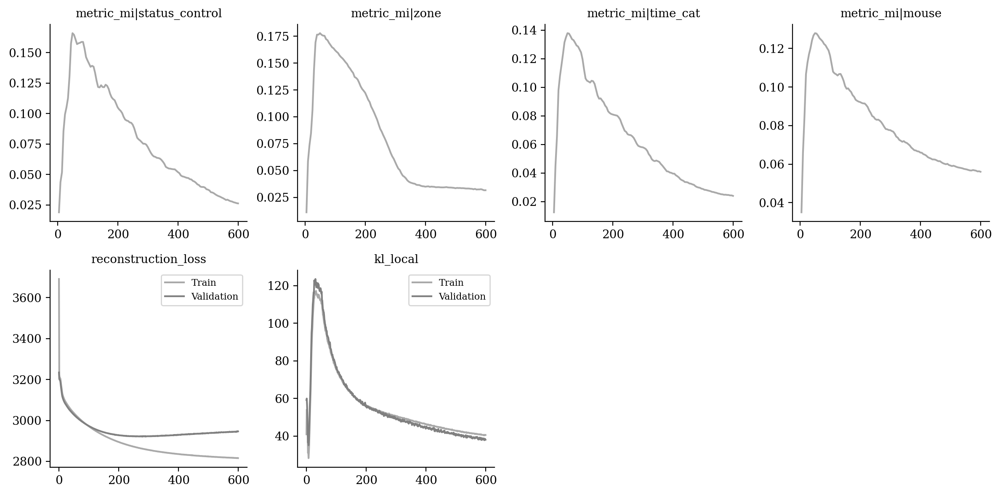

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

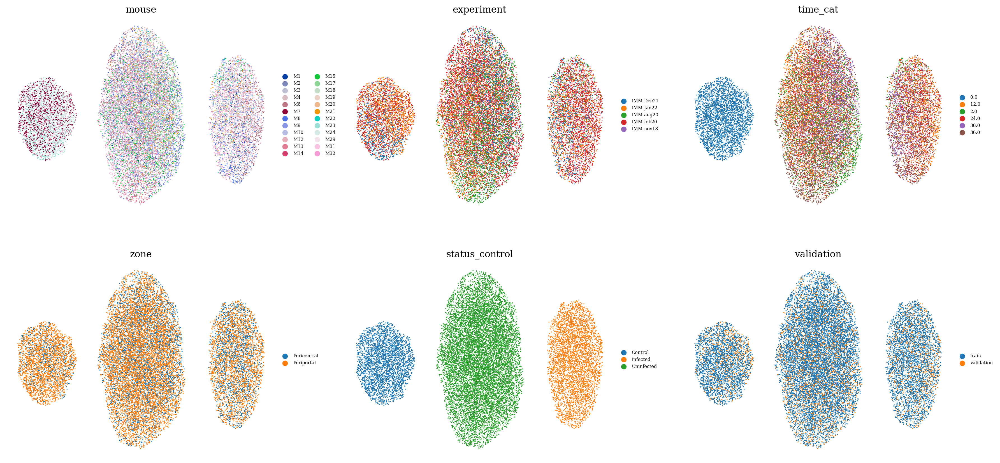

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

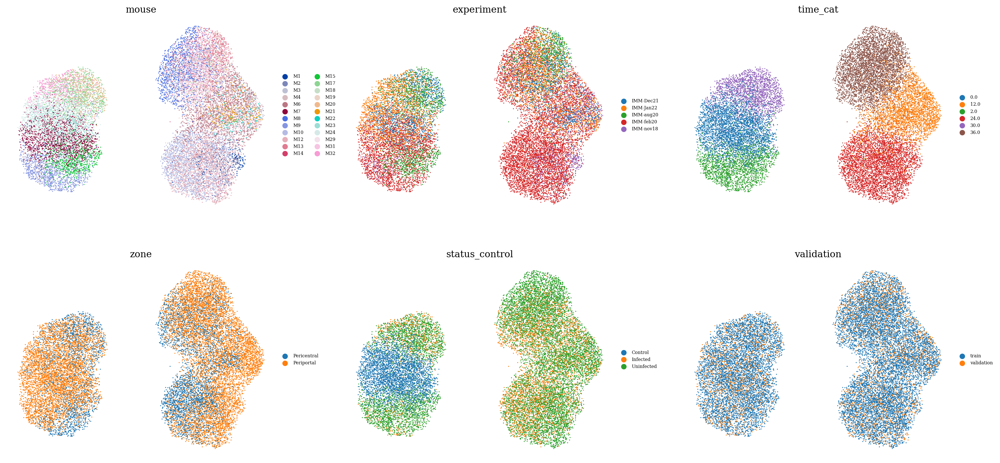

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

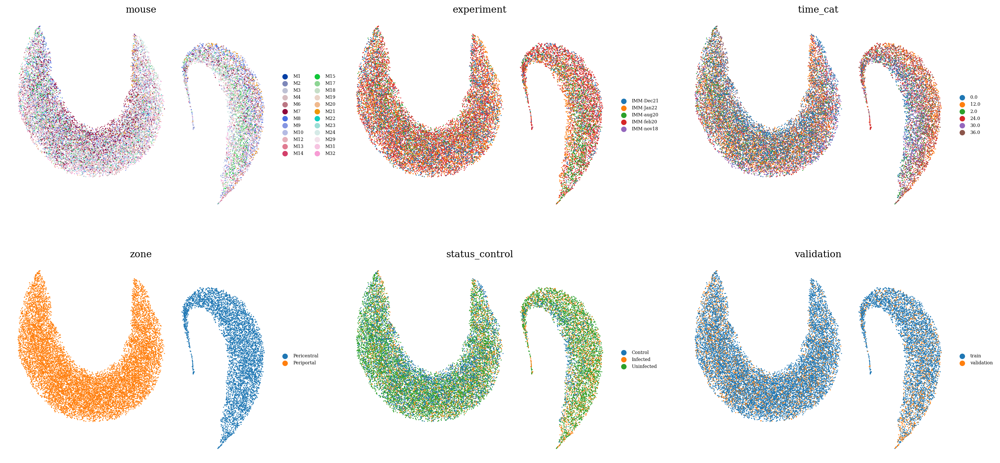

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

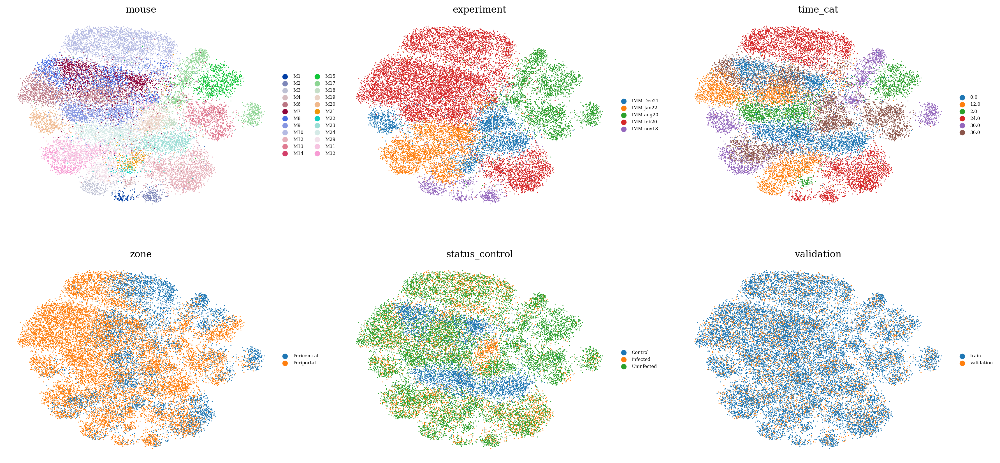

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

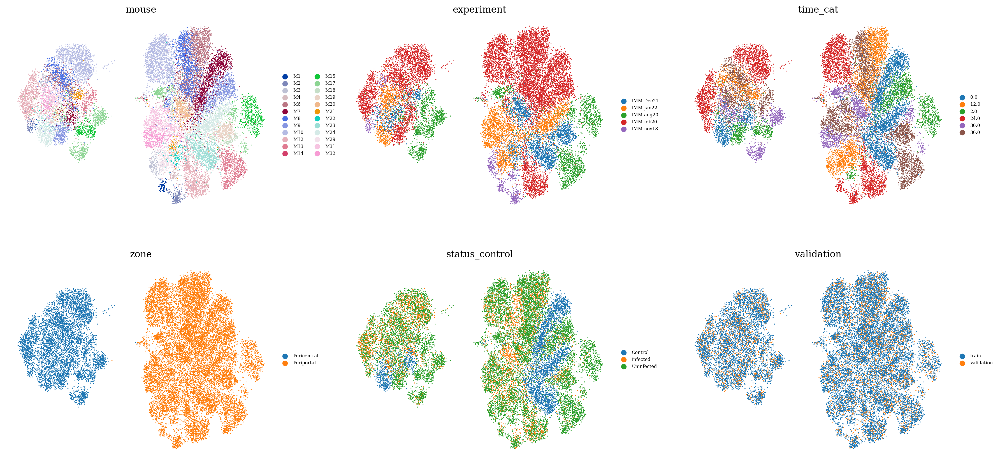

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

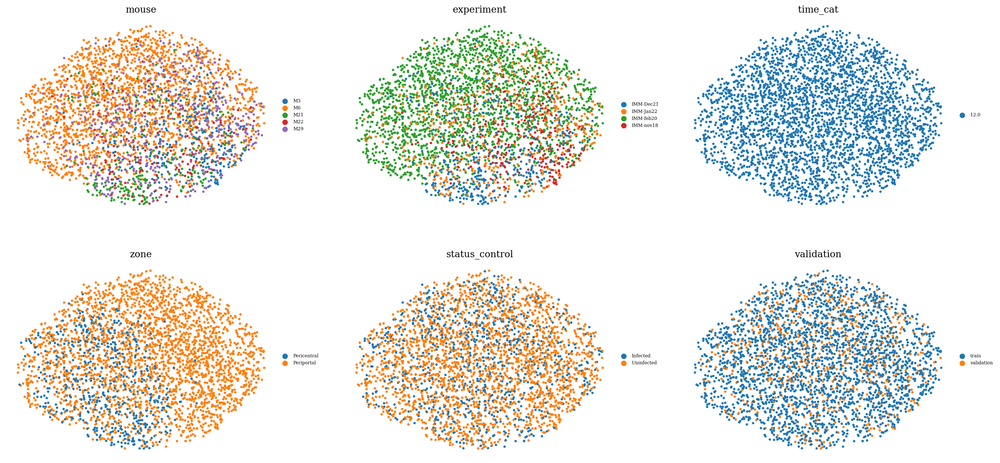

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )